In [1]:
import os
from glob import glob
import numpy as np
import scipy as sp
import pandas as pd

from sklearn import metrics
from sklearn import decomposition, cluster
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.preprocessing import StandardScaler

from scipy.spatial.distance import correlation
from IPython.display import display

In [2]:
import mne

from mne.preprocessing import (ICA, create_eog_epochs, create_ecg_epochs, corrmap, annotate_muscle_zscore, 
                               find_eog_events, find_ecg_events, ica_find_ecg_events)
from mne.time_frequency import tfr_morlet, psd_multitaper, psd_welch

from mne.preprocessing import (ICA, create_eog_epochs, create_ecg_epochs, corrmap, find_bad_channels_maxwell)
from mne.time_frequency import tfr_morlet, psd_multitaper, psd_welch
from mne.time_frequency import csd_fourier, csd_multitaper, csd_morlet

print(mne.__file__)
print(mne.__version__)

C:\Users\Lenovo\anaconda3\lib\site-packages\mne\__init__.py
0.23.4


In [3]:
import plotly.graph_objects as go
from gtda.time_series import SingleTakensEmbedding, TakensEmbedding, takens_embedding_optimal_parameters
from gtda.homology import VietorisRipsPersistence, WeightedRipsPersistence, SparseRipsPersistence, WeakAlphaPersistence, EuclideanCechPersistence
from gtda.diagrams import BettiCurve
from gtda.plotting import plot_point_cloud


In [4]:
import seaborn as sns
# Apply the default theme
sns.set_theme()

In [5]:
# Configure the graphics engine

import matplotlib.pyplot as plt
plt.rc('figure', max_open_warning=100)
%matplotlib notebook
#%matplotlib inline
#%matplotlib qt

In [6]:
os.getcwd()

if not os.path.exists('work_data'):
    os.mkdir('work_data')

# Loading data

Extracting EDF parameters from C:\Users\Lenovo\PycharmProjects\Tibet\work_data\m10.edf...
EDF file detected
Setting channel info structure...
Creating raw.info structure...
Reading 0 ... 491999  =      0.000 ...   983.998 secs...
['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2', 'ecg']
<Info | 7 non-empty values
 bads: []
 ch_names: Fp1, Fp2, F7, F3, Fz, F4, F8, T3, C3, Cz, C4, T4, T5, P3, Pz, ...
 chs: 20 EEG
 custom_ref_applied: False
 highpass: 0.5 Hz
 lowpass: 70.0 Hz
 meas_date: 2020-03-01 06:31:33 UTC
 nchan: 20
 projs: []
 sfreq: 500.0 Hz
>


<IPython.core.display.Javascript object>


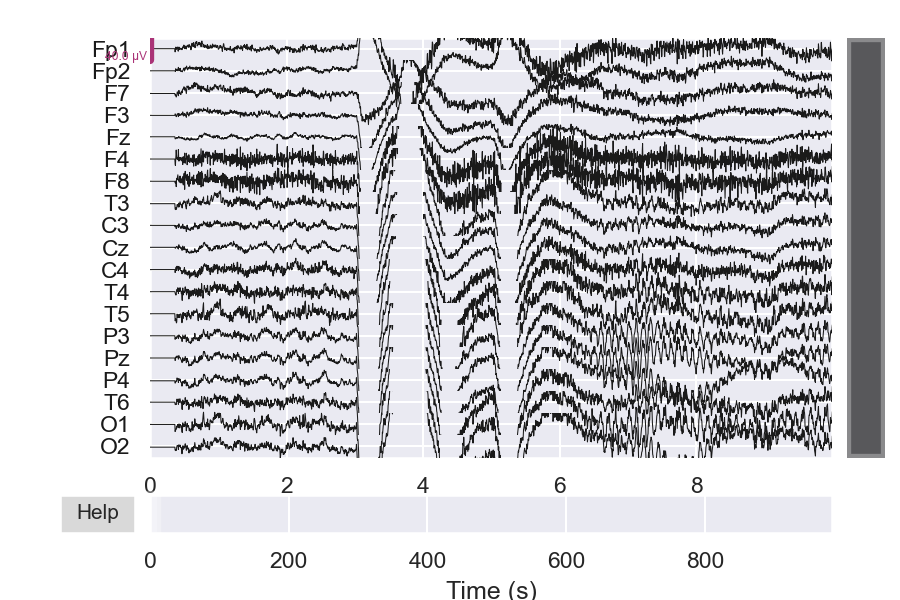

<RawEDF | m10.edf, 19 x 468751 (937.5 s), ~68.0 MB, data loaded>

In [7]:
#Fp_chan=['Fpz', 'Fp1', 'Fp2','Fz']
#C_chan=['Cz', 'C3','C4','C1', 'C2']
#P_chan=['Pz', 'P3', 'P4', 'P8', 'P7', 'P6', 'P5', 'P1', 'P2']
#PO_chan=['POz', 'PO3', 'PO7','PO4', 'PO8'] 
#O_chan= ['Oz', 'O1', 'O2']
#Cz_chan=['CPz','FCz']

ECG_ch =['ecg']

data = mne.io.read_raw_edf(os.path.join('work_data', r"m10.edf"), preload=True)
#annot = mne.read_annotations(os.path.join('work_data', r'm10-annot.csv'))
#data.set_annotations(annot)

print(data.info.ch_names)
print(data.info)

#data_eog = data.copy().pick_channels(EOG_ch)
data_ecg = data.copy().pick_channels(ECG_ch)

data.drop_channels('ecg').set_montage('standard_1020')
#data.set_channel_types(change_types)

#data.plot(scalings = dict(eeg=100e-6, eog=150e-6), duration=10)
data.plot(duration=10)

data.crop(tmin=7.5, tmax=945) #removing blink artifacts


<IPython.core.display.Javascript object>


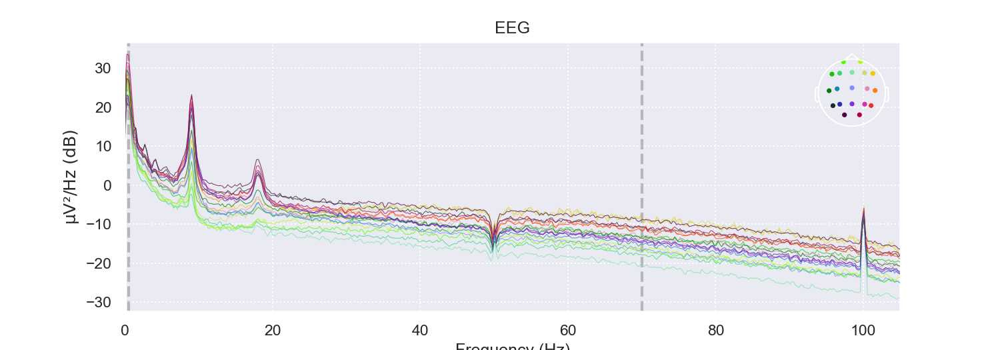

Effective window size : 4.096 (s)


<IPython.core.display.Javascript object>


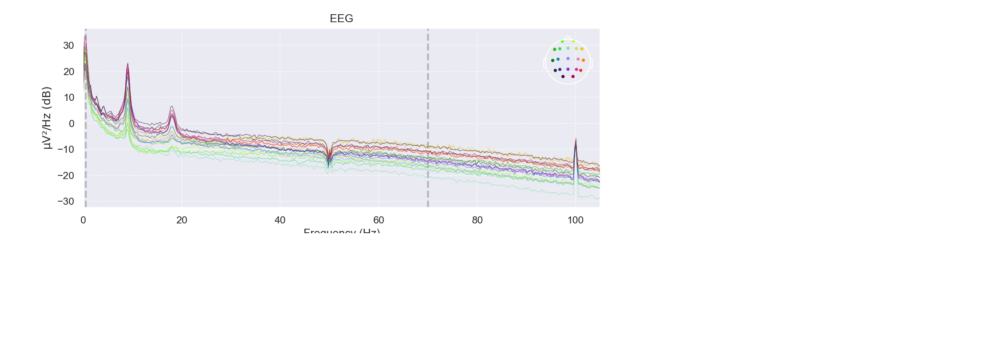

In [8]:
data.plot_psd(fmin=0, fmax=105)

# Preprocessing data

## ICA preparation 

Interpolating bad channels
    Automatic origin fit: head of radius 91.5 mm
Computing interpolation matrix from 17 sensor positions
Interpolating 2 sensors
Filtering raw data in 1 contiguous segment
Setting up high-pass filter at 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal highpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Filter length: 825 samples (1.650 sec)

Fitting ICA to data using 19 channels (please be patient, this may take a while)
Selecting by explained variance: 13 components
Fitting ICA took 5.9s.
Creating RawArray with float64 data, n_channels=13, n_times=468751
    Range : 3750 ... 472500 =      7.500 ...   945.000 secs
Ready.


<IPython.core.display.Javascript object>


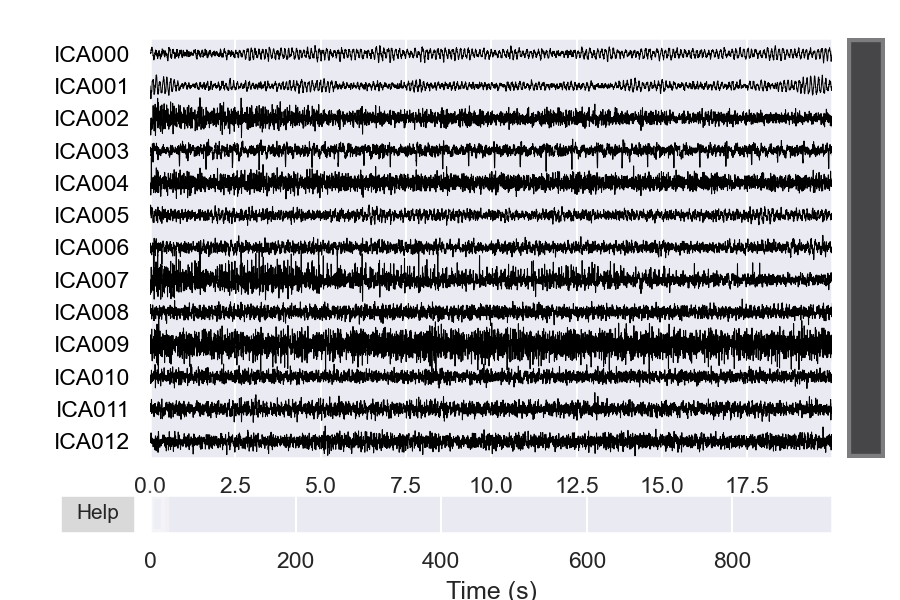

<IPython.core.display.Javascript object>


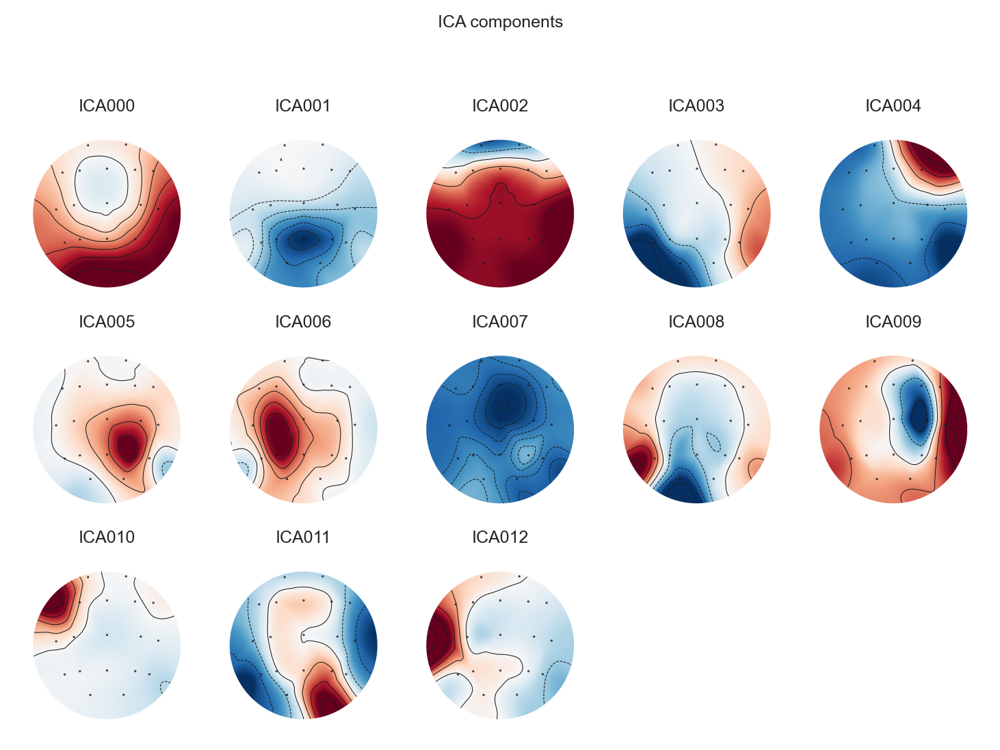

[<MNEFigure size 975x731.5 with 13 Axes>]

In [9]:
data_ica = data.copy()
data_ica.info['bads']=["F4","F8"]
data_ica.interpolate_bads(reset_bads=True)

data_ica.filter(l_freq=4., h_freq=None)

ica = ICA(n_components=.99, max_iter='auto', random_state=97)
ica.fit(data_ica)

ica.plot_sources(data_ica)
ica.plot_components()

Using ICA source to identify heart beats
Setting up band-pass filter from 5 - 35 Hz

FIR filter parameters
---------------------
Designing a two-pass forward and reverse, zero-phase, non-causal bandpass filter:
- Windowed frequency-domain design (firwin2) method
- Hann window
- Lower passband edge: 5.00
- Lower transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 4.75 Hz)
- Upper passband edge: 35.00 Hz
- Upper transition bandwidth: 0.50 Hz (-12 dB cutoff frequency: 35.25 Hz)
- Filter length: 5000 samples (10.000 sec)

[111. 111. 111. ... 111. 111. 111.]
[  3794.   4181.   4959. ... 471229. 471594. 471976.]
Not setting metadata
Not setting metadata
1232 matching events found
Setting baseline interval to [-0.3, 0.0] sec
Applying baseline correction (mode: mean)
0 projection items activated
Loading data for 1232 events and 351 original time points ...
1 bad epochs dropped
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


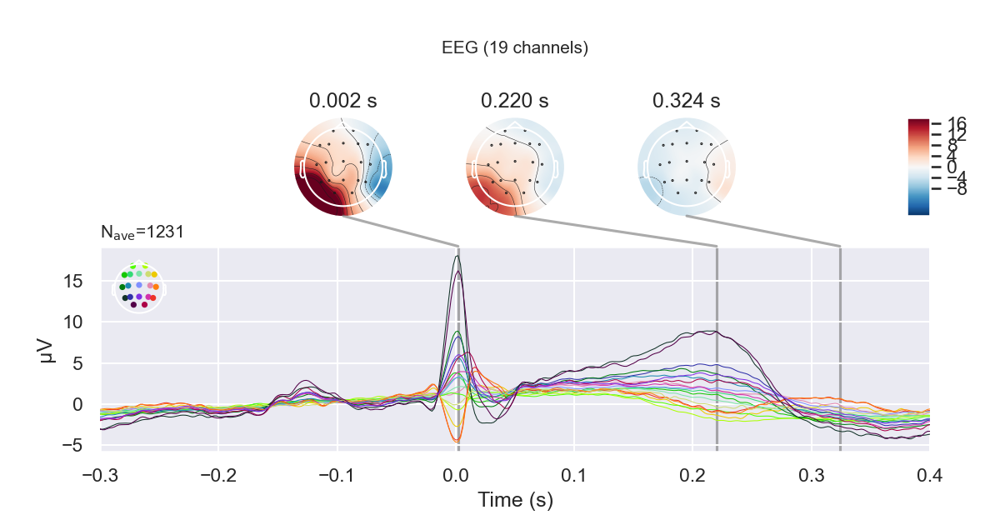

<IPython.core.display.Javascript object>


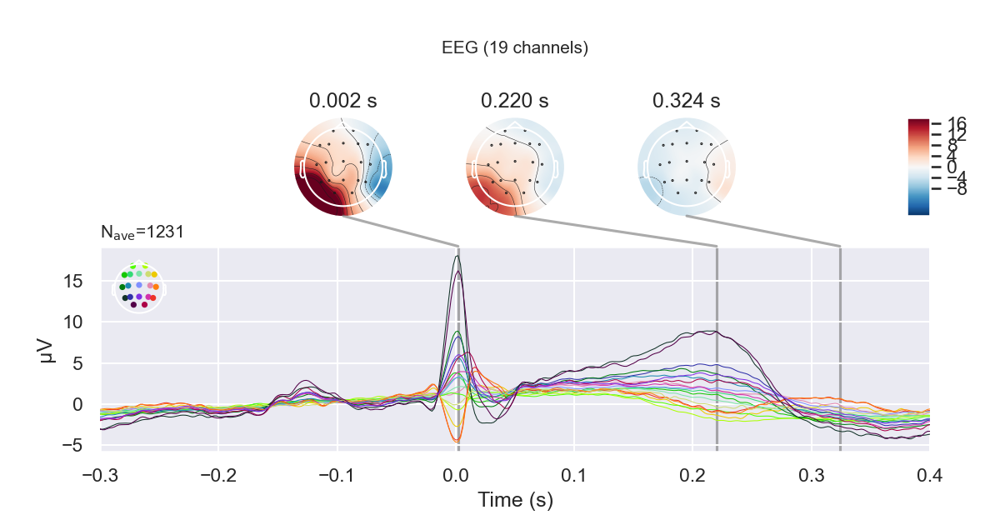

In [10]:
# Extract the time courses of these components and add them as channels to the raw data. 
# Think of them the same way as EOG/EKG channels
ecg_comps = ica.get_sources(data_ica).get_data()
#ecg_comps.pick(picks='ICA003')
#(ecg_comps.info)

ecg_events = ica_find_ecg_events(data_ica, 
                             ecg_comps[3], 
                             event_id=111, 
                             l_freq=5, h_freq=35, 
                             )
print(ecg_events[:,2])
print(np.unique(ecg_events[:,0]))


evoked_ECG = mne.Epochs(data, ecg_events.astype(int),
                            #detrend=1,
                            decim=1,
                            #baseline=(-0.15,0.0),
                            tmin=-0.3, tmax=0.4, 
                            preload=True).average()
evoked_ECG.plot_joint()

#data_ica.add_channels([ecg_comps])

#ecg_comps.rename_channels({'ICA003': 'ecg_ICA003'})
#ecg_comps.set_channel_types({'ICA003': 'ecg'})


Applying ICA to Evoked instance
    Transforming to ICA space (13 components)
    Zeroing out 1 ICA component
    Projecting back using 19 PCA components


<ipython-input-11-835c2dff7e7e>:1: RuntimeWarning: The data you passed to ICA.apply() was baseline-corrected. Please note that ICA can introduce DC shifts, therefore you may wish to consider baseline-correcting the cleaned data again.
  ica.plot_overlay(evoked_ECG, exclude=[3])


<IPython.core.display.Javascript object>


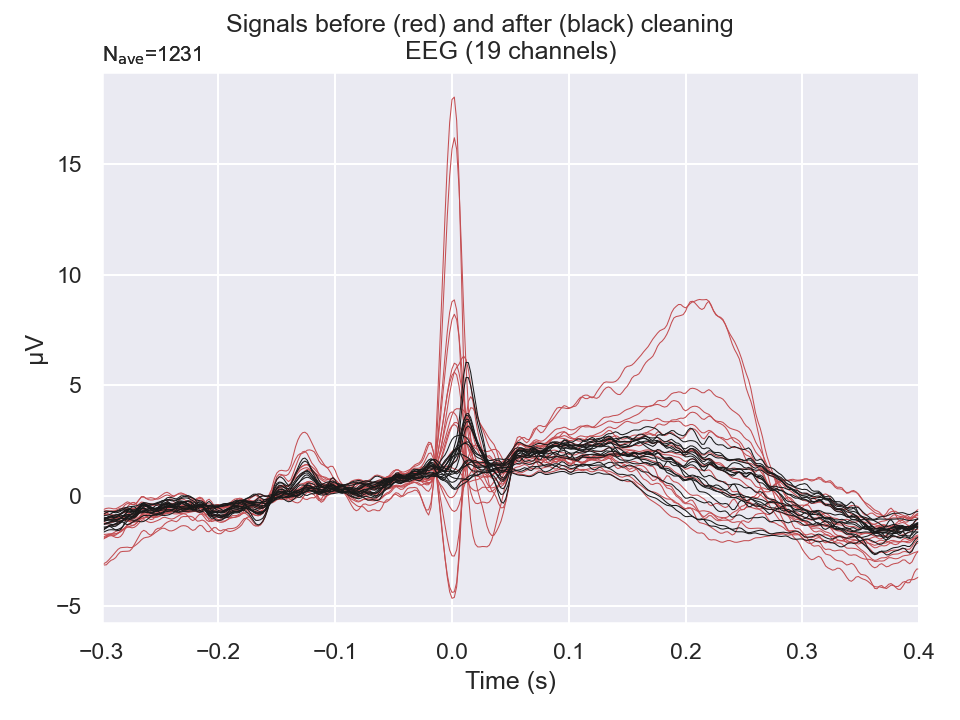

<IPython.core.display.Javascript object>


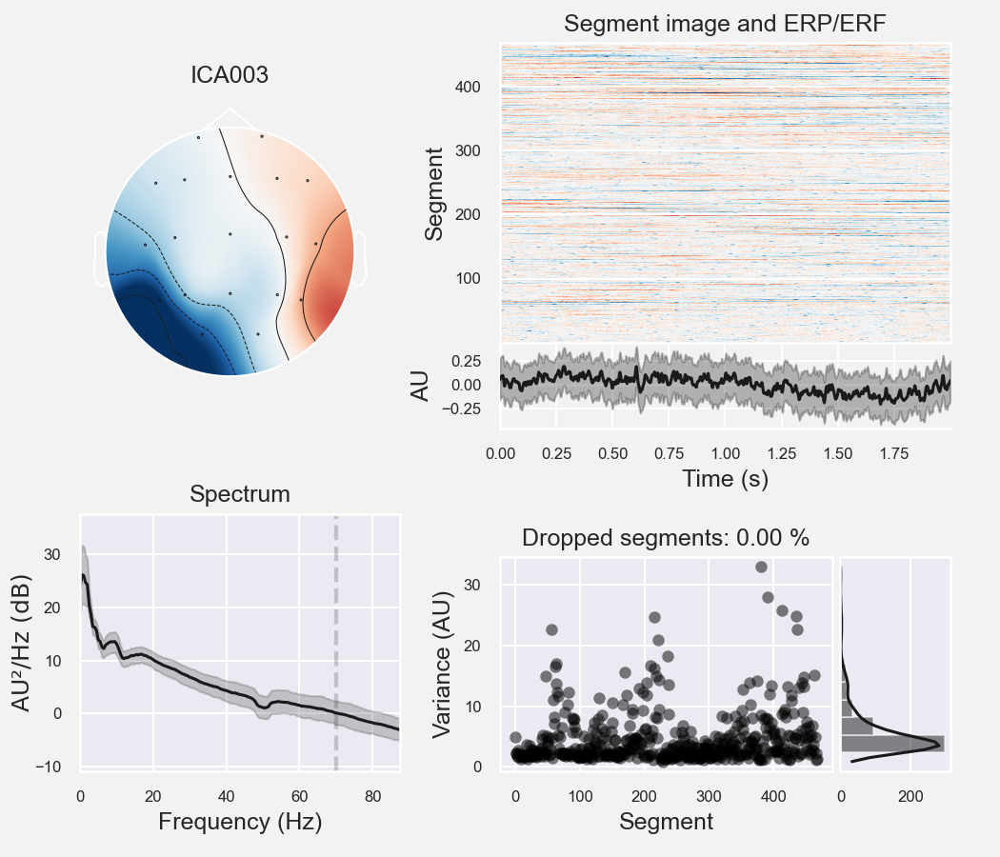

    Using multitaper spectrum estimation with 7 DPSS windows
Not setting metadata
Not setting metadata
468 matching events found
No baseline correction applied
0 projection items activated
0 bad epochs dropped


[<Figure size 700x600 with 6 Axes>]

In [11]:
ica.plot_overlay(evoked_ECG, exclude=[3])
ica.plot_properties(data, picks=[3])

Applying ICA to Raw instance
    Transforming to ICA space (13 components)
    Zeroing out 1 ICA component
    Projecting back using 19 PCA components


<IPython.core.display.Javascript object>


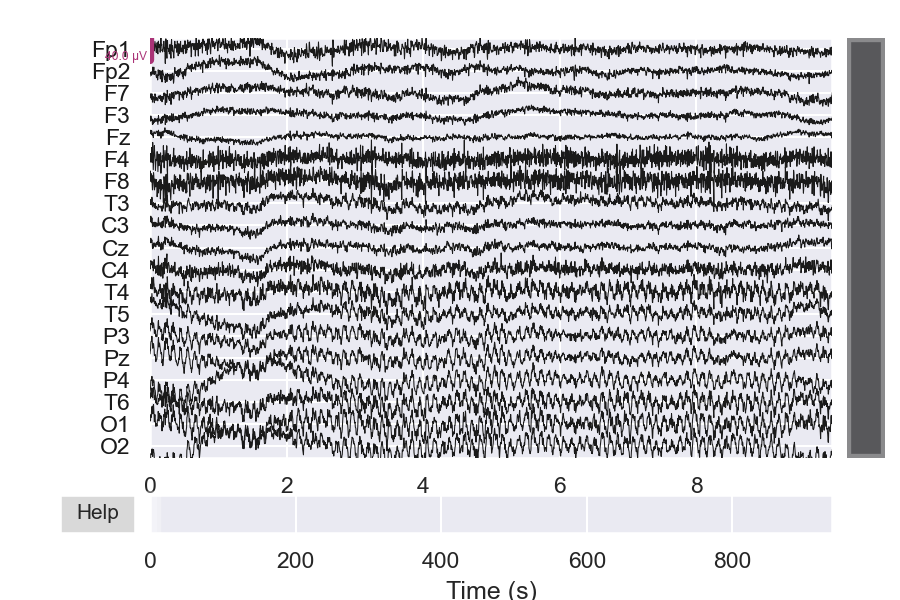

<IPython.core.display.Javascript object>


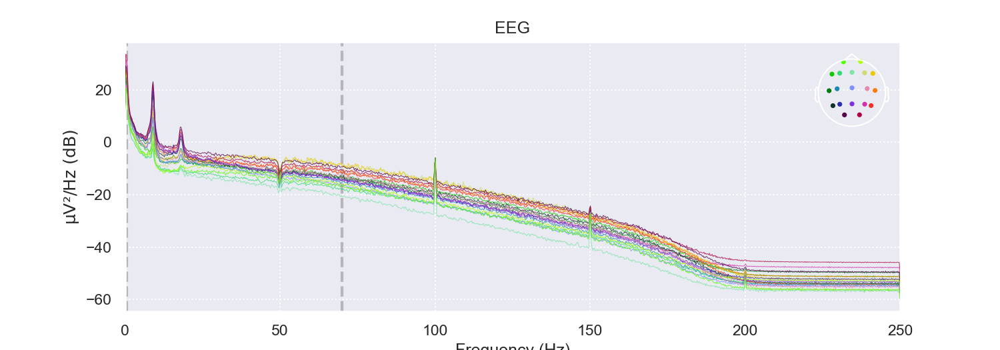

Effective window size : 4.096 (s)


<IPython.core.display.Javascript object>


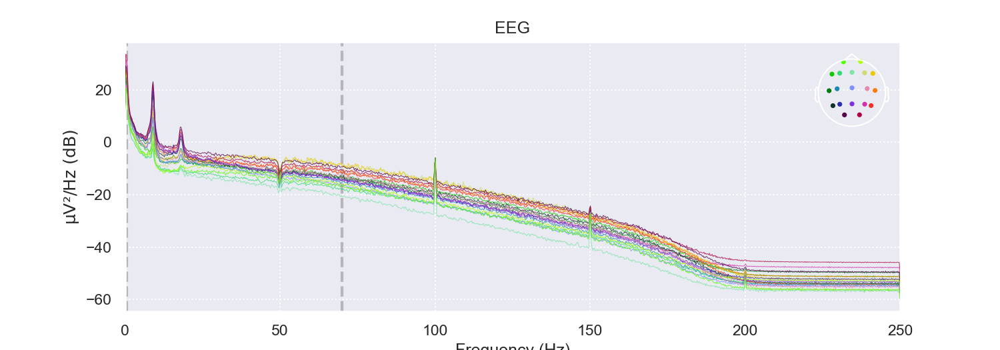

In [12]:
# data_notch = data.copy().notch_filter([50,100])
#data_notch.plot_psd(fmin=0, fmax=105)

ica.exclude = [3] #exclude ECG channel
ica.apply(data)

#data.filter(l_freq=0.1, h_freq=45)

data.plot()
data.plot_psd()

# Epoching data

Not setting metadata
Not setting metadata
1232 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1232 events and 451 original time points ...
1 bad epochs dropped
<Epochs |  1231 events (all good), -0.4 - 0.5 sec, baseline off, ~80.5 MB, data loaded,
 '111': 1231>
(1232, 3)
(1231, 19, 451)
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


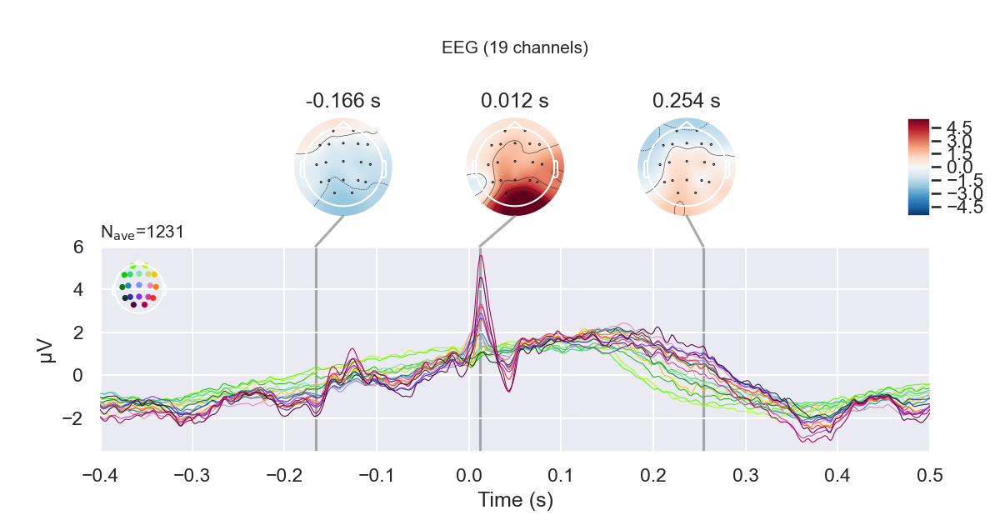

<IPython.core.display.Javascript object>


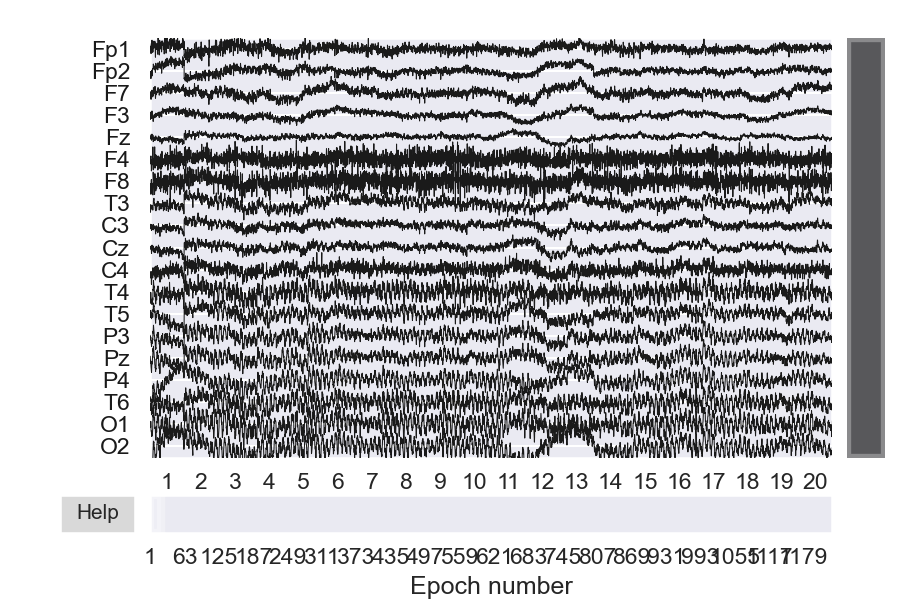

<IPython.core.display.Javascript object>


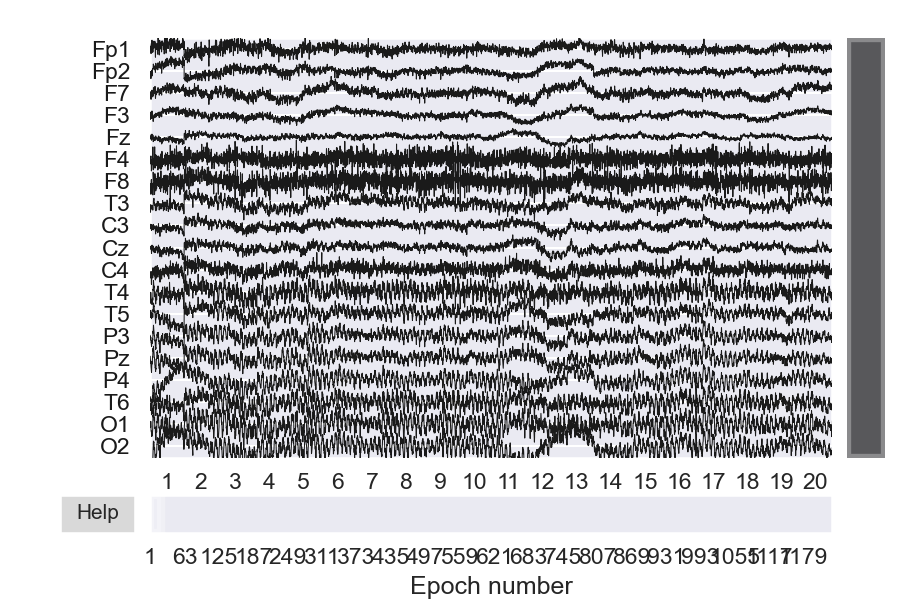

In [13]:
epochs_ecg = mne.Epochs(data, ecg_events.astype(int),
                            #detrend=1,
                            #decim=1,
                            baseline=None,
                            #baseline=(-0.15,0.0),
                            tmin=-0.4, tmax=0.5, 
                            preload=True)
print(epochs_ecg)
print(ecg_events.shape)
print(epochs_ecg.get_data().shape)
epochs_ecg.average().plot_joint()
epochs_ecg.plot()

Interpolating bad channels
    Automatic origin fit: head of radius 91.5 mm
Computing interpolation matrix from 17 sensor positions
Interpolating 2 sensors
Not setting metadata
Not setting metadata
1232 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1232 events and 451 original time points ...
1 bad epochs dropped
<Epochs |  1231 events (all good), -0.4 - 0.5 sec, baseline off, ~80.5 MB, data loaded,
 '111': 1231>
(1232, 3)
(1231, 19, 451)
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


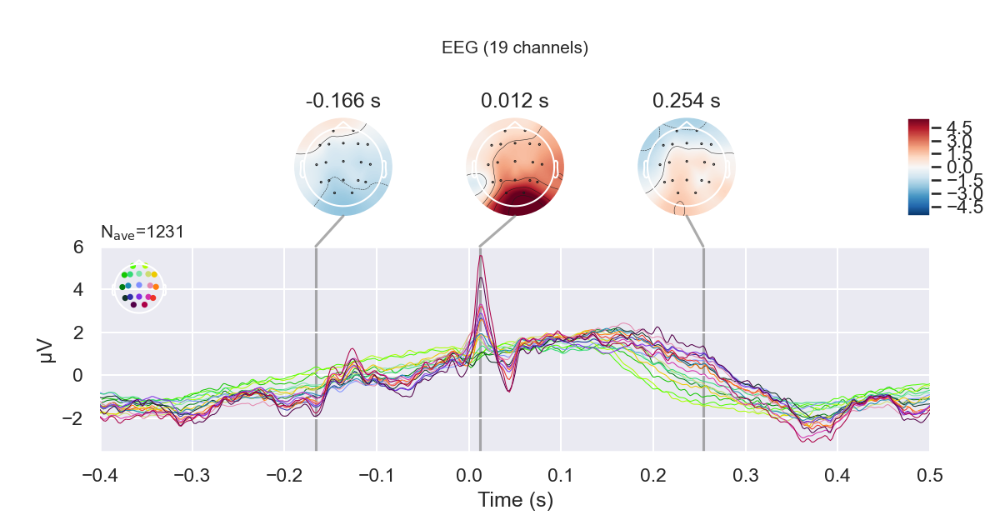

<IPython.core.display.Javascript object>


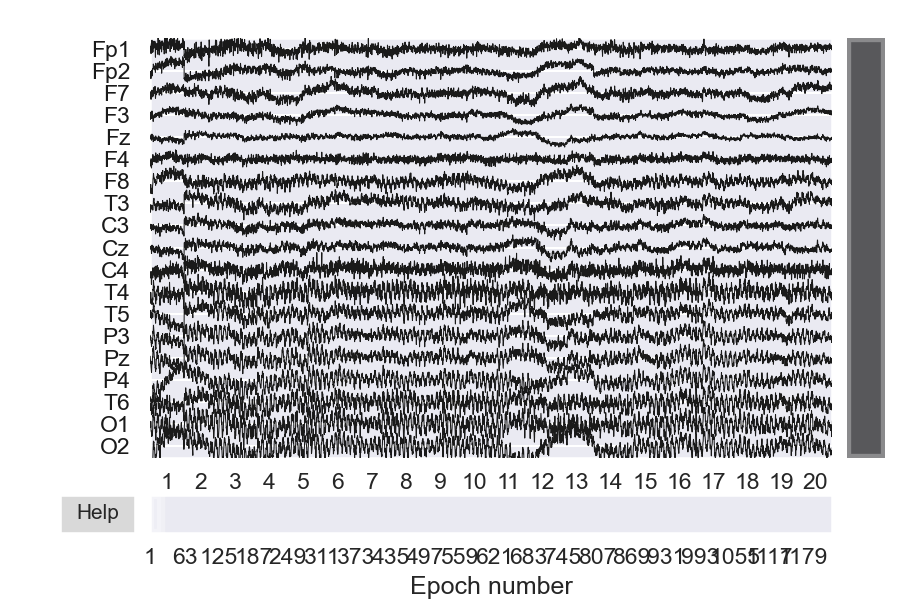

<IPython.core.display.Javascript object>


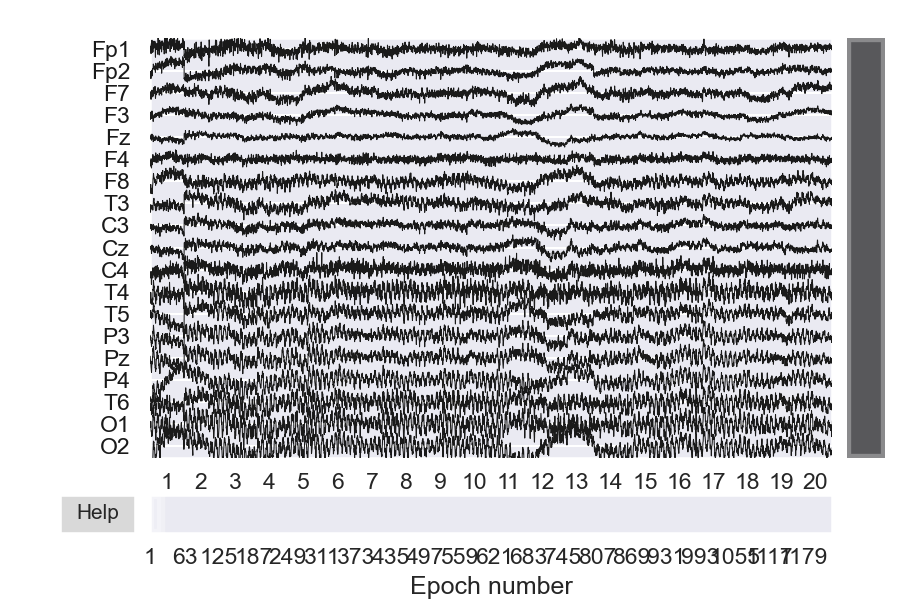

In [14]:
# Interpolate bad channels F4 and F8
data_int = data.copy()
data_int.info['bads']=["F4","F8"]
data_int.interpolate_bads(reset_bads=True)

epochs_ecg_int = mne.Epochs(data_int, ecg_events.astype(int),
                            #detrend=1,
                            #decim=1,
                            baseline=None,
                            #baseline=(-0.15,0.0),
                            tmin=-0.4, tmax=0.5, 
                            preload=True)
print(epochs_ecg_int)
print(ecg_events.shape)
print(epochs_ecg_int.get_data().shape)
epochs_ecg_int.average().plot_joint()
epochs_ecg_int.plot()

Not setting metadata
Not setting metadata
937 matching events found
No baseline correction applied
0 projection items activated
Loading data for 937 events and 501 original time points ...
0 bad epochs dropped
<Epochs |  937 events (all good), -0.5 - 0.5 sec, baseline off, ~68.1 MB, data loaded,
 '1': 937>
(937, 3)
(937, 19, 501)
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


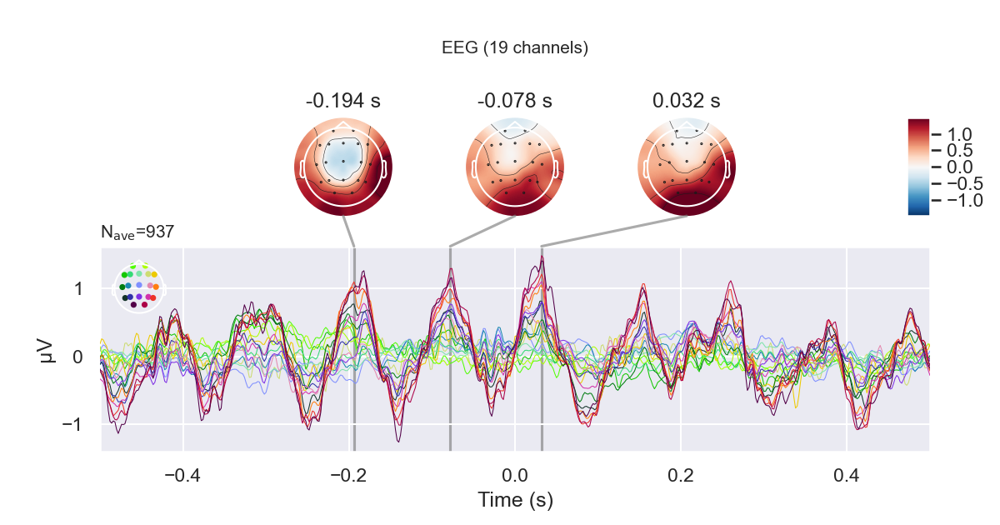

<IPython.core.display.Javascript object>


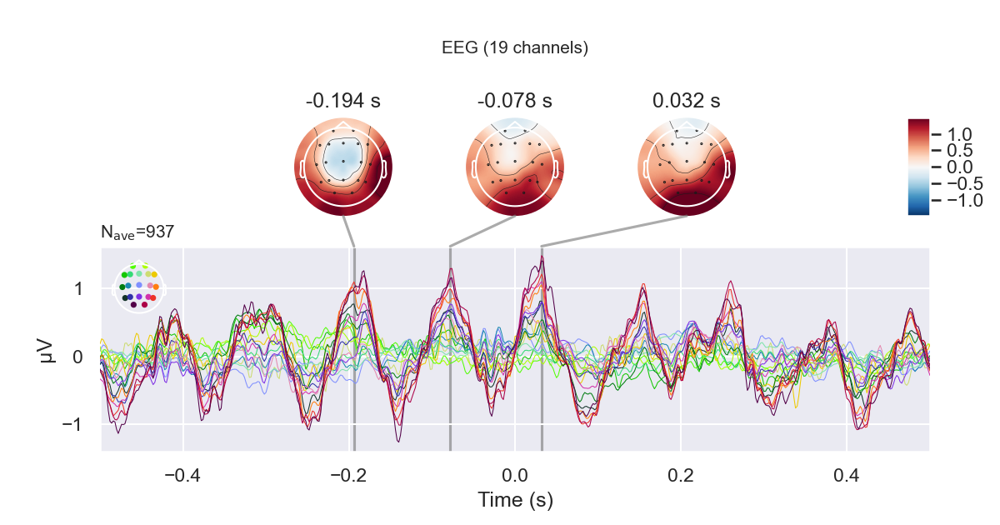

In [15]:
fix_1s_events = mne.make_fixed_length_events(data, start=0.5, duration=1.)
#print(fix_1s_events)

epochs_fix_1s = mne.Epochs(data, fix_1s_events.astype(int),
                            #detrend=1,
                            #decim=1,
                            baseline=None,
                            #baseline=(-0.15,0.0),
                            tmin=-0.5, tmax=0.5, 
                            preload=True)

print(epochs_fix_1s)
print(fix_1s_events.shape)
print(epochs_fix_1s.get_data().shape)
epochs_fix_1s.average().plot_joint()
#epochs_fix_1s.plot()

Not setting metadata
Not setting metadata
1171 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1171 events and 501 original time points ...
0 bad epochs dropped
<Epochs |  1171 events (all good), -0.5 - 0.5 sec, baseline off, ~85.1 MB, data loaded,
 '1': 1171>
(1171, 3)
(1171, 19, 501)
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


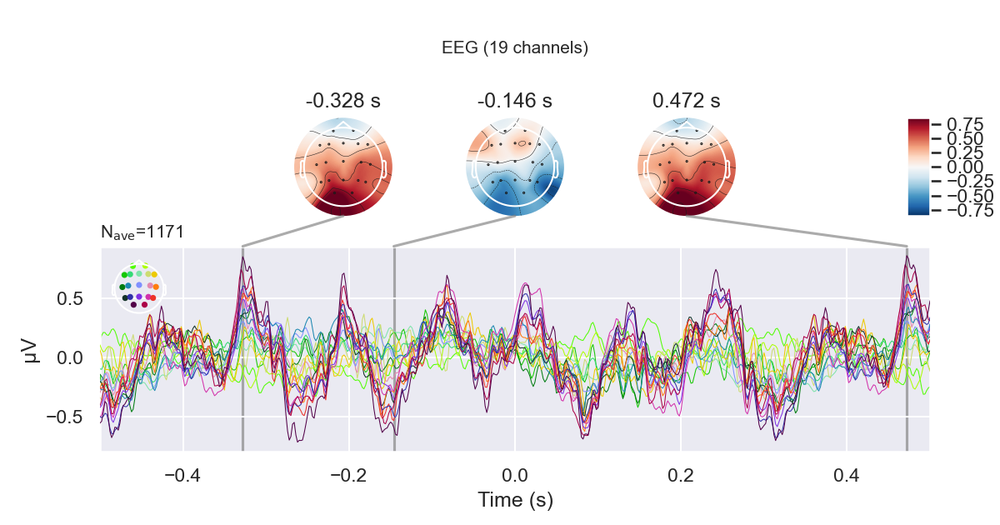

<IPython.core.display.Javascript object>


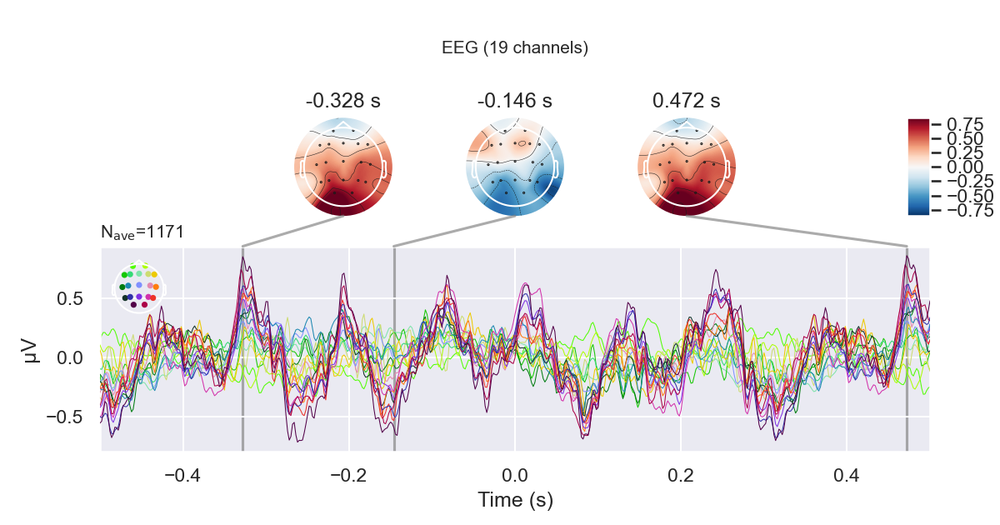

In [16]:
fix_1s_events_ovl = mne.make_fixed_length_events(data, start=0.5, duration=1., overlap=0.2)
#print(fix_1s_events_ovl)

epochs_fix_1s_ovl = mne.Epochs(data, fix_1s_events_ovl.astype(int),
                            #detrend=1,
                            #decim=1,
                            baseline=None,
                            #baseline=(-0.15,0.0),
                            tmin=-0.5, tmax=0.5, 
                            preload=True)

print(epochs_fix_1s_ovl)
print(fix_1s_events_ovl.shape)
print(epochs_fix_1s_ovl.get_data().shape)
epochs_fix_1s_ovl.average().plot_joint()
#epochs_fix_1s_ovl.plot()

Not setting metadata
Not setting metadata
1874 matching events found
No baseline correction applied
0 projection items activated
Loading data for 1874 events and 251 original time points ...
0 bad epochs dropped
<Epochs |  1874 events (all good), -0.2 - 0.3 sec, baseline off, ~68.2 MB, data loaded,
 '1': 1874>
(1874, 3)
(1874, 19, 251)
No projector specified for this dataset. Please consider the method self.add_proj.


<IPython.core.display.Javascript object>


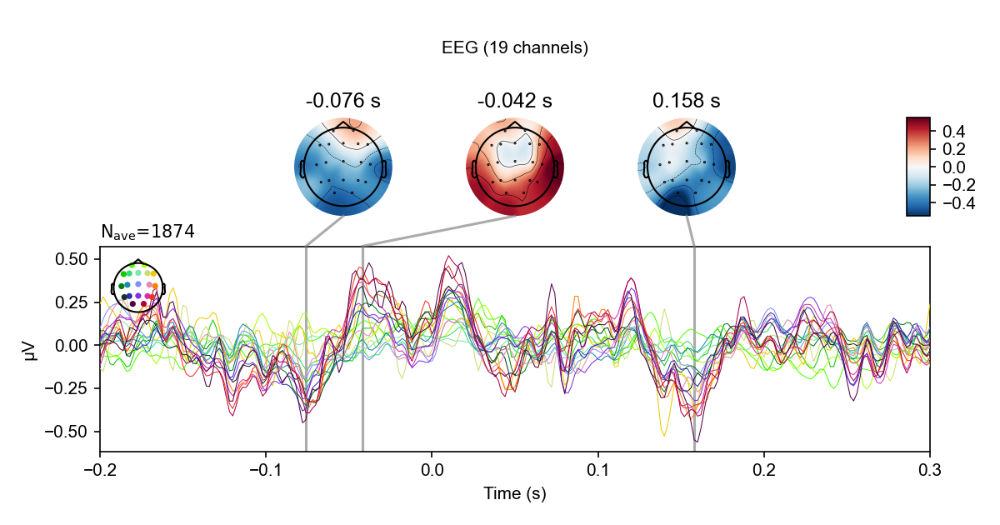

<IPython.core.display.Javascript object>


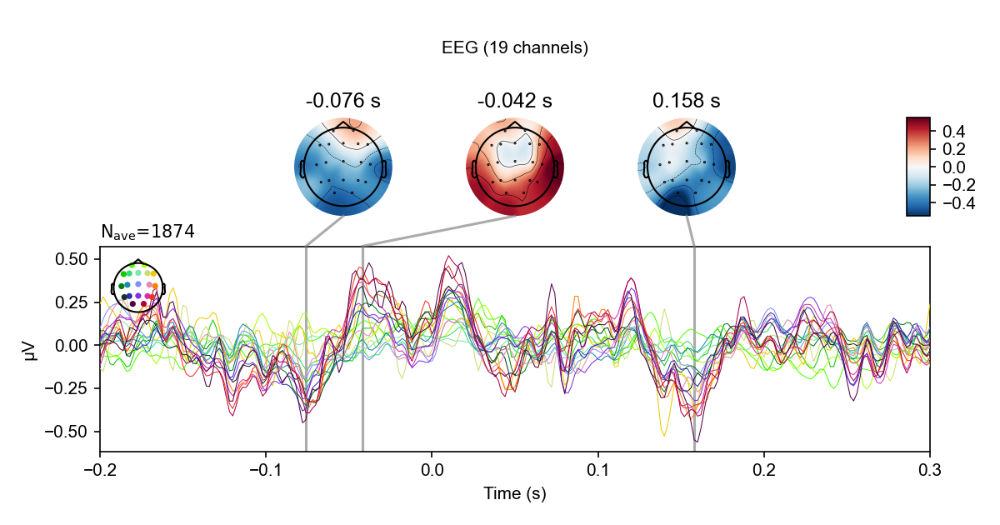

In [210]:
fix_05s_events = mne.make_fixed_length_events(data, start=0.2, duration=0.5)
#print(fix_05s_events)

epochs_fix_05s = mne.Epochs(data, fix_05s_events.astype(int),
                            #detrend=1,
                            #decim=1,
                            baseline=None,
                            #baseline=(-0.15,0.0),
                            tmin=-0.2, tmax=0.3, 
                            preload=True)

print(epochs_fix_05s)
print(fix_05s_events.shape)
print(epochs_fix_05s.get_data().shape)
epochs_fix_05s.average().plot_joint()
#epochs_fix_05s.plot()

# Explore features

## Extract PSD features

In [288]:
# Calculating PSD for epochs_ecg
kwargs = dict(fmin=0.1, fmax=45, n_jobs=1)
psd_mtaper, freq_mtaper = psd_multitaper(epochs_ecg, **kwargs)

bands = [(0, 4, 'Delta (0-4 Hz)'), (4, 8, 'Theta (4-8 Hz)'),
                 (8, 12, 'Alpha (8-12 Hz)'), (12, 30, 'Beta (12-30 Hz)'),
                 (30, 45, 'Gamma (30-45 Hz)')]
_freq_masks = [(fmin < freq_mtaper) & (freq_mtaper < fmax)
                       for (fmin, fmax, _) in bands]
print(freq_mtaper)
#print(_freq_masks)

psd_ecg_spectr = np.array([np.mean(psd_mtaper[:,:, _freq_mask], axis=2)
                  for _freq_mask in _freq_masks]).transpose(0,2,1)

psd_ecg_spectr = 10 * np.log10(psd_ecg_spectr)
print(psd_ecg_spectr.shape)

    Using multitaper spectrum estimation with 7 DPSS windows
[ 1.10864745  2.2172949   3.32594235  4.4345898   5.54323725  6.6518847
  7.76053215  8.8691796   9.97782705 11.0864745  12.19512195 13.3037694
 14.41241685 15.5210643  16.62971175 17.7383592  18.84700665 19.9556541
 21.06430155 22.172949   23.28159645 24.3902439  25.49889135 26.6075388
 27.71618625 28.8248337  29.93348115 31.0421286  32.15077605 33.2594235
 34.36807095 35.4767184  36.58536585 37.6940133  38.80266075 39.9113082
 41.01995565 42.1286031  43.23725055 44.345898  ]
(5, 19, 1231)


In [212]:
# Calculating PSD for epochs_ecg_int
kwargs = dict(fmin=0.1, fmax=45, n_jobs=1)
psd_mtaper, freq_mtaper = psd_multitaper(epochs_ecg_int, **kwargs)

bands = [(0, 4, 'Delta (0-4 Hz)'), (4, 8, 'Theta (4-8 Hz)'),
                 (8, 12, 'Alpha (8-12 Hz)'), (12, 30, 'Beta (12-30 Hz)'),
                 (30, 45, 'Gamma (30-45 Hz)')]
_freq_masks = [(fmin < freq_mtaper) & (freq_mtaper < fmax)
                       for (fmin, fmax, _) in bands]
print(freq_mtaper)
#print(_freq_masks)

psd_ecg_int_spectr = np.array([np.mean(psd_mtaper[:,:, _freq_mask], axis=2)
                  for _freq_mask in _freq_masks]).transpose(0,2,1)

psd_ecg_int_spectr = 10 * np.log10(psd_ecg_int_spectr)
print(psd_ecg_int_spectr.shape)

    Using multitaper spectrum estimation with 7 DPSS windows
[ 1.10864745  2.2172949   3.32594235  4.4345898   5.54323725  6.6518847
  7.76053215  8.8691796   9.97782705 11.0864745  12.19512195 13.3037694
 14.41241685 15.5210643  16.62971175 17.7383592  18.84700665 19.9556541
 21.06430155 22.172949   23.28159645 24.3902439  25.49889135 26.6075388
 27.71618625 28.8248337  29.93348115 31.0421286  32.15077605 33.2594235
 34.36807095 35.4767184  36.58536585 37.6940133  38.80266075 39.9113082
 41.01995565 42.1286031  43.23725055 44.345898  ]
(5, 19, 1231)


In [289]:
# Calculating PSD (fixed epochs 1sec)
kwargs = dict(fmin=0.1, fmax=45, n_jobs=1)
psd_mtaper, freq_mtaper = psd_multitaper(epochs_fix_1s, **kwargs)

bands = [(0, 4, 'Delta (0-4 Hz)'), (4, 8, 'Theta (4-8 Hz)'),
                 (8, 12, 'Alpha (8-12 Hz)'), (12, 30, 'Beta (12-30 Hz)'),
                 (30, 45, 'Gamma (30-45 Hz)')]
_freq_masks = [(fmin < freq_mtaper) & (freq_mtaper < fmax)
                       for (fmin, fmax, _) in bands]
print(freq_mtaper)
#print(_freq_masks)

psd_fix_1s_spectr = np.array([np.mean(psd_mtaper[:,:, _freq_mask], axis=2)
                  for _freq_mask in _freq_masks]).transpose(0,2,1)

psd_fix_1s_spectr = 10 * np.log10(psd_fix_1s_spectr)
print(psd_fix_1s_spectr.shape)

    Using multitaper spectrum estimation with 7 DPSS windows
[ 0.99800399  1.99600798  2.99401198  3.99201597  4.99001996  5.98802395
  6.98602794  7.98403194  8.98203593  9.98003992 10.97804391 11.9760479
 12.9740519  13.97205589 14.97005988 15.96806387 16.96606786 17.96407186
 18.96207585 19.96007984 20.95808383 21.95608782 22.95409182 23.95209581
 24.9500998  25.94810379 26.94610778 27.94411178 28.94211577 29.94011976
 30.93812375 31.93612774 32.93413174 33.93213573 34.93013972 35.92814371
 36.9261477  37.9241517  38.92215569 39.92015968 40.91816367 41.91616766
 42.91417166 43.91217565 44.91017964]
(5, 19, 937)


In [291]:
# Calculating PSD (fixed epochs 1sec with overlapping 0.2sec)
kwargs = dict(fmin=0.1, fmax=45, n_jobs=1)
psd_mtaper, freq_mtaper = psd_multitaper(epochs_fix_1s_ovl, **kwargs)

bands = [(0, 4, 'Delta (0-4 Hz)'), (4, 8, 'Theta (4-8 Hz)'),
                 (8, 12, 'Alpha (8-12 Hz)'), (12, 30, 'Beta (12-30 Hz)'),
                 (30, 45, 'Gamma (30-45 Hz)')]
_freq_masks = [(fmin < freq_mtaper) & (freq_mtaper < fmax)
                       for (fmin, fmax, _) in bands]
print(freq_mtaper)
#print(_freq_masks)

psd_fix_1s_ovl_spectr = np.array([np.mean(psd_mtaper[:,:, _freq_mask], axis=2)
                  for _freq_mask in _freq_masks]).transpose(0,2,1)

psd_fix_1s_ovl_spectr = 10 * np.log10(psd_fix_1s_ovl_spectr)
print(psd_fix_1s_ovl_spectr.shape)

    Using multitaper spectrum estimation with 7 DPSS windows
[ 0.99800399  1.99600798  2.99401198  3.99201597  4.99001996  5.98802395
  6.98602794  7.98403194  8.98203593  9.98003992 10.97804391 11.9760479
 12.9740519  13.97205589 14.97005988 15.96806387 16.96606786 17.96407186
 18.96207585 19.96007984 20.95808383 21.95608782 22.95409182 23.95209581
 24.9500998  25.94810379 26.94610778 27.94411178 28.94211577 29.94011976
 30.93812375 31.93612774 32.93413174 33.93213573 34.93013972 35.92814371
 36.9261477  37.9241517  38.92215569 39.92015968 40.91816367 41.91616766
 42.91417166 43.91217565 44.91017964]
(5, 19, 1171)


In [290]:
# Calculating PSD (fixed epochs 0.5sec)
kwargs = dict(fmin=0.1, fmax=45, n_jobs=1)
psd_mtaper, freq_mtaper = psd_multitaper(epochs_fix_05s, **kwargs)

bands = [(0, 4, 'Delta (0-4 Hz)'), (4, 8, 'Theta (4-8 Hz)'),
                 (8, 12, 'Alpha (8-12 Hz)'), (12, 30, 'Beta (12-30 Hz)'),
                 (30, 45, 'Gamma (30-45 Hz)')]
_freq_masks = [(fmin < freq_mtaper) & (freq_mtaper < fmax)
                       for (fmin, fmax, _) in bands]
print(freq_mtaper)
#print(_freq_masks)

psd_fix_05s_spectr = np.array([np.mean(psd_mtaper[:,:, _freq_mask], axis=2)
                  for _freq_mask in _freq_masks]).transpose(0,2,1)

psd_fix_05s_spectr = 10 * np.log10(psd_fix_05s_spectr)
print(psd_fix_05s_spectr.shape)

    Using multitaper spectrum estimation with 7 DPSS windows
[ 1.99203187  3.98406375  5.97609562  7.96812749  9.96015936 11.95219124
 13.94422311 15.93625498 17.92828685 19.92031873 21.9123506  23.90438247
 25.89641434 27.88844622 29.88047809 31.87250996 33.86454183 35.85657371
 37.84860558 39.84063745 41.83266932 43.8247012 ]
(5, 19, 1874)


# PSD features exploration

In [442]:
# Display highlighted correlation matrix function

def highlight(x, corr_bounds=[0.5, 0.65, 0.8]):
    color1 = 'background-color: red'
    color2 = 'background-color: orange'
    color3 = 'background-color: yellow'
    color4 = ''

    mask1 = (abs(x) >= corr_bounds[2])
    mask2 = (abs(x) >= corr_bounds[1]) & (abs(x) < corr_bounds[2])
    mask3 = (abs(x) >= corr_bounds[0]) & (abs(x) < corr_bounds[1])

    df1 = pd.DataFrame(color4, index=x.index, columns=x.columns)
    return df1.mask(mask1, color1).mask(mask2, color2).mask(mask3, color3)

def display_corr_matrix(df_corr, corr_bounds=[0.5, 0.65, 0.8]):
    s = df_corr.style.apply(highlight, corr_bounds=corr_bounds, axis=None)
    s = s.format('{:.2f}')
    display(s)
#    return s

## ECG epoches (0.9s, 1231 samples)

In [293]:
# Initial 19*5 PSD features

n_freq = len(psd_ecg_spectr[:,0,0])
n_channels = len(psd_ecg_spectr[0,:,0])
n_samples = len(psd_ecg_spectr[0,0,:])

str_freq = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
channel_names = data.ch_names
print(str_freq)
print(channel_names)

psd_ecg_ft = psd_ecg_spectr.reshape(n_freq*n_channels, n_samples).transpose(1,0)
print(psd_ecg_ft.shape)

df_psd_ecg_ft = pd.DataFrame()
for i in range(n_freq):
    for j in range(n_channels):
        df_psd_ecg_ft.insert(i*n_channels+j, str_freq[i]+'_'+ channel_names[j], psd_ecg_spectr[i,j,:])
#df_psd_ecg_ft


['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2']
(1231, 95)


In [294]:
# Scaling N(0,1) initial psd features

psd_ecg_ft_sc = StandardScaler().fit_transform(psd_ecg_ft)

df_psd_ecg_ft_sc = pd.DataFrame(psd_ecg_ft_sc, columns=df_psd_ecg_ft.columns)
display(df_psd_ecg_ft_sc)


,Delta_Fp1,Delta_Fp2,Delta_F7,Delta_F3,Delta_Fz,Delta_F4,Delta_F8,Delta_T3,Delta_C3,Delta_Cz,...,Gamma_Cz,Gamma_C4,Gamma_T4,Gamma_T5,Gamma_P3,Gamma_Pz,Gamma_P4,Gamma_T6,Gamma_O1,Gamma_O2
0,-1.162739,-0.180493,-0.981256,-0.133151,-1.391846,-0.959729,-1.622162,-2.206721,-1.889920,-1.336827,...,2.783608,3.014003,2.344316,2.228120,1.886902,2.134197,2.202595,2.154684,1.375511,0.604681
1,-0.148077,-1.044218,-1.049184,-0.725127,-1.449590,-0.580421,-0.867462,-0.884168,-1.104481,-1.880998,...,3.295742,2.678173,2.756732,3.135098,3.260340,3.225011,3.002060,2.963679,2.423115,2.246623
2,-0.706448,-0.894348,-0.467389,-1.198253,-0.660972,-0.785942,-0.150321,-0.195706,-0.205533,-0.222652,...,2.977794,2.803306,2.883915,3.732483,2.651334,3.118724,2.836331,3.132833,1.736554,1.832708
3,0.219430,-0.445942,-0.423945,-0.645662,-2.088744,-0.517229,-1.339493,-1.056910,-1.216593,-1.053919,...,2.411997,2.057322,2.669249,3.316573,2.013609,2.164422,2.159496,2.629036,1.010442,1.844994
4,-0.017058,-0.554347,0.224150,0.113653,-1.750423,-1.428008,-1.862953,-0.400888,-0.521535,-0.262467,...,3.224856,2.260806,1.997226,1.384680,3.072336,2.879557,2.408172,2.033002,2.708923,2.138991
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1226,0.341500,-0.263416,-1.194271,-0.753255,-0.159110,-0.134123,-0.437158,-0.561138,0.112775,0.395831,...,0.351231,-0.091186,-0.393432,0.725174,-0.111033,0.152361,0.025412,0.083990,0.025675,-0.492815
1227,0.491353,-0.419215,-0.840108,-0.438125,0.223058,0.506214,0.076374,0.120760,0.670031,0.899770,...,1.015025,0.429763,0.397773,0.022410,0.579359,0.864523,0.855851,0.174264,0.989046,0.753804
1228,0.498250,-0.889280,-0.410979,-1.156527,-0.780883,-0.413726,-0.444399,-0.430105,0.062511,0.136930,...,-2.483397,-1.396430,-1.346266,-0.836902,-0.668983,-0.969147,-1.086949,-0.639839,-1.030698,-0.959052
1229,0.930226,0.128530,-0.948968,-0.902740,-0.653585,-0.338122,-0.260245,-0.368086,0.107316,0.188677,...,-0.487606,-0.247998,0.162963,0.639831,-0.725885,-0.809327,-0.425570,0.364668,0.307962,0.345877


In [295]:
# PCA components all features

psd_ecg_ft_PCA = decomposition.PCA(n_components=0.90).fit_transform(psd_ecg_ft)
print(psd_ecg_ft_PCA.shape)

comp_names = []
for i in range(1, len(psd_ecg_ft_PCA[0,:])+1):
    comp_names = comp_names + ['PCA_'+str(i)]
print(comp_names)

df_psd_ecg_ft_PCA = pd.DataFrame(psd_ecg_ft_PCA, columns=comp_names)
display(df_psd_ecg_ft_PCA)

#display_corr_matrix(df_psd_ecg_ft_PCA.corr(), corr_middle=0.6, corr_high=0.8)

(1231, 15)
['PCA_1', 'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10', 'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15']


,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,PCA_13,PCA_14,PCA_15
0,-29.224398,-11.032120,27.765114,7.071676,-3.507579,-0.676654,-0.077567,-9.941282,0.003536,5.944135,3.865740,14.326117,-1.584617,3.193801,1.121545
1,-29.912980,-11.016659,25.410951,1.213515,5.825634,-1.429569,0.881983,4.880259,-2.406442,7.297102,-4.685612,6.785480,-1.658421,1.299848,-9.726057
2,-17.349125,-14.923514,21.598577,-7.716972,5.454966,-10.280673,-4.653979,2.909175,8.937140,0.346850,-10.309203,6.026567,-1.857513,-3.599465,-4.784093
3,-26.846703,-11.635410,21.882321,2.510299,1.077336,-7.789684,-2.775359,7.910264,5.723678,4.525397,-4.027543,4.409955,-1.082407,2.407643,0.405035
4,-20.078945,-14.519931,20.065034,-0.086570,2.981749,-2.361275,5.680896,6.515944,11.620051,2.667150,-3.937981,6.847873,0.981008,5.626173,0.177058
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1226,-3.748219,7.670755,1.527582,-10.928001,-9.917971,4.754380,-2.081455,13.620288,-10.554476,-1.130679,-2.793285,6.002737,-0.891562,2.695658,0.116675
1227,6.935242,13.265291,6.764986,-14.915266,-5.587642,3.619314,-4.446652,13.053344,-6.195170,-2.257512,-0.411632,2.685620,-0.043555,1.156446,0.255942
1228,-11.569266,20.159525,-3.215667,-3.733963,-8.356122,2.164137,-0.647116,13.329728,-6.627540,-2.652159,2.166196,2.714648,-0.704961,-0.991356,2.209201
1229,-4.835589,10.402605,3.840599,-6.734988,-11.731414,3.069687,-4.901320,17.571658,-8.395433,0.093283,-1.913479,3.666731,-2.561401,2.452826,2.003470


In [221]:
# Scaling N(0,1) PCA components of PSD features

psd_ecg_ft_PCA_sc = StandardScaler().fit_transform(psd_ecg_ft_PCA)

df_psd_ecg_ft_PCA_sc = pd.DataFrame(psd_ecg_ft_PCA_sc, columns=comp_names)
display(df_psd_ecg_ft_PCA_sc)


,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,PCA_13,PCA_14,PCA_15
0,-1.210238,-0.777978,2.834950,0.892732,-0.550204,-0.115422,-0.014439,-2.062351,0.000829,1.543081,1.091132,4.189593,-0.511998,1.062651,0.384183
1,-1.238754,-0.776888,2.594578,0.153195,0.913818,-0.243852,0.164175,1.012425,-0.564017,1.894308,-1.322547,1.984376,-0.535844,0.432489,-3.331640
2,-0.718460,-1.052397,2.205317,-0.974195,0.855674,-1.753647,-0.866308,0.603518,2.094667,0.090041,-2.909845,1.762436,-0.600172,-1.197625,-1.638781
3,-1.111773,-0.820522,2.234289,0.316902,0.168993,-1.328742,-0.516615,1.641009,1.341503,1.174781,-1.136802,1.289667,-0.349731,0.801078,0.138744
4,-0.831508,-1.023937,2.048735,-0.010929,0.467722,-0.402780,1.057461,1.351753,2.723482,0.692385,-1.111523,2.002622,0.316969,1.871957,0.060651
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1226,-0.155221,0.540937,0.155973,-1.379557,-1.555748,0.810988,-0.387449,2.825572,-2.473735,-0.293521,-0.788424,1.755467,-0.288068,0.896907,0.039967
1227,0.287202,0.935460,0.690737,-1.882911,-0.876486,0.617372,-0.827715,2.707958,-1.452010,-0.586044,-0.116186,0.785394,-0.014073,0.384776,0.087672
1228,-0.479105,1.421637,-0.328335,-0.471378,-1.310754,0.369152,-0.120456,2.765294,-1.553348,-0.688493,0.611424,0.793884,-0.227777,-0.329847,0.756757
1229,-0.200251,0.733585,0.392143,-0.850229,-1.840208,0.523618,-0.912348,3.645296,-1.967703,0.024216,-0.540093,1.072315,-0.827602,0.816112,0.686284


In [296]:
# Feature Agglomeration all features, Ward, Euclidean
n_FA_comp = 20
df_psd_ecg_ft_FA_eucl = pd.DataFrame()
df_cl_psd_ecg_ft_FA_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_comp)

psd_ecg_ft_FA_eucl = FA_transformer.fit_transform(psd_ecg_ft)

for i in range(n_FA_comp):
    df_psd_ecg_ft_FA_eucl.insert(len(df_psd_ecg_ft_FA_eucl.columns), 'FA_'+str(i), psd_ecg_ft_FA_eucl[:,i])

print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [df_psd_ecg_ft.columns[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    #print('Features in cluster {}: {}'.format(i, features_with_label))
    df_cl_psd_ecg_ft_FA_eucl.loc[len(df_cl_psd_ecg_ft_FA_eucl.index)] = ['FA_'+str(i)] + [features_with_label]

print(psd_ecg_ft_FA_eucl.shape)
display(df_cl_psd_ecg_ft_FA_eucl)
#display(df_psd_ecg_ft_FA_eucl)

display_corr_matrix(df_psd_ecg_ft_FA_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[ 3 19  9  9 18  6  2  2  1  1  1  2  1  1  1 13  6  2 13  8  3  3  8  8
  8  6  6 14 14 14  0  0  0  0 12  0 12 12  4  4  7  4  4  4 11 11  7  7
 11  0  0 17 17  0  0  0  0 16  5  4 16 16 10  4  4  4  4  4  7  7  7  7
  7  7 11 11 15 16  5 15 15 10 10  5 16 16  5  5  5  5  5  5  5  4  4]
(1231, 20)


,Name,Channels
0,FA_0,"[Theta_T4, Theta_T5, Theta_P3, Theta_Pz, Theta..."
1,FA_1,"[Delta_C3, Delta_Cz, Delta_C4, Delta_T5, Delta..."
2,FA_2,"[Delta_F8, Delta_T3, Delta_T4, Delta_O1]"
3,FA_3,"[Delta_Fp1, Theta_Fp2, Theta_F7]"
4,FA_4,"[Alpha_Fp1, Alpha_Fp2, Alpha_F3, Alpha_Fz, Alp..."
5,FA_5,"[Beta_Fp2, Gamma_F7, Gamma_T3, Gamma_C4, Gamma..."
6,FA_6,"[Delta_F4, Delta_T6, Theta_F8, Theta_T3]"
7,FA_7,"[Alpha_F7, Alpha_C3, Alpha_Cz, Beta_T4, Beta_T..."
8,FA_8,"[Theta_Fp1, Theta_F3, Theta_Fz, Theta_F4]"
9,FA_9,"[Delta_F7, Delta_F3]"


,FA_0,FA_1,FA_2,FA_3,FA_4,FA_5,FA_6,FA_7,FA_8,FA_9,FA_10,FA_11,FA_12,FA_13,FA_14,FA_15,FA_16,FA_17,FA_18,FA_19
FA_0,1.00,0.20,0.20,0.24,0.63,0.16,0.30,0.86,0.23,0.23,0.15,0.96,0.78,0.25,0.41,0.14,0.25,0.80,0.19,0.20
FA_1,0.20,1.00,0.79,0.66,0.28,-0.09,0.80,0.03,0.82,0.67,-0.25,0.09,0.52,0.71,0.82,-0.05,0.12,-0.12,0.80,0.61
FA_2,0.20,0.79,1.00,0.76,0.26,-0.13,0.95,0.05,0.82,0.81,-0.33,0.14,0.63,0.83,0.64,-0.12,0.07,-0.11,0.64,0.67
FA_3,0.24,0.66,0.76,1.00,0.41,-0.02,0.75,0.12,0.85,0.84,-0.19,0.21,0.65,0.82,0.56,0.01,0.22,-0.05,0.57,0.89
FA_4,0.63,0.28,0.26,0.41,1.00,0.48,0.34,0.69,0.45,0.37,0.41,0.66,0.61,0.36,0.48,0.45,0.67,0.52,0.24,0.32
FA_5,0.16,-0.09,-0.13,-0.02,0.48,1.00,-0.09,0.23,-0.06,0.01,0.82,0.13,0.15,0.02,-0.02,0.83,0.71,0.27,-0.11,-0.03
FA_6,0.30,0.80,0.95,0.75,0.34,-0.09,1.00,0.11,0.86,0.76,-0.26,0.22,0.69,0.80,0.70,-0.08,0.10,-0.05,0.65,0.65
FA_7,0.86,0.03,0.05,0.12,0.69,0.23,0.11,1.00,0.08,0.14,0.22,0.88,0.62,0.14,0.36,0.18,0.30,0.92,0.03,0.09
FA_8,0.23,0.82,0.82,0.85,0.45,-0.06,0.86,0.08,1.00,0.82,-0.21,0.18,0.61,0.78,0.74,-0.01,0.22,-0.10,0.79,0.70
FA_9,0.23,0.67,0.81,0.84,0.37,0.01,0.76,0.14,0.82,1.00,-0.15,0.19,0.64,0.82,0.54,0.05,0.25,0.00,0.61,0.70


In [297]:
# Feature Agglomeration all features, Ward, Pearson correlation
n_FA_comp = 20
df_psd_ecg_ft_FA_corr = pd.DataFrame()
df_cl_psd_ecg_ft_FA_corr = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_comp, affinity='correlation', linkage="average")

psd_ecg_ft_FA_corr = FA_transformer.fit_transform(psd_ecg_ft)

for i in range(n_FA_comp):
    df_psd_ecg_ft_FA_corr.insert(len(df_psd_ecg_ft_FA_corr.columns), 'FA_'+str(i), psd_ecg_ft_FA_corr[:,i])

print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [df_psd_ecg_ft.columns[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    #print('Features in cluster {}: {}'.format(i, features_with_label))
    df_cl_psd_ecg_ft_FA_corr.loc[len(df_cl_psd_ecg_ft_FA_corr.index)] = ['FA_'+str(i)] + [features_with_label]

print(psd_ecg_ft_FA_corr.shape)
display(df_cl_psd_ecg_ft_FA_corr)
#display(df_psd_ecg_ft_FA_corr)

#display_corr_matrix(df_psd_ecg_ft_FA_corr.corr(), corr_middle=0.6, corr_high=0.8)

[15  4  4  4 17  4  4  4 17 13 17  4 17 17 17  4  4  4  4 15  4  4  4 17
  4  4  4 17 13  2  2  2  6  6  2  2  2  2  1  1 16  7 14 19  6  6  8  8
  6  6  6  6  6  6  6  6  6 10 11 12  7 14 18 18  6  8  8  6  6  6  6  6
  6  6  6  6 18  9  3  3  5 18 18 18  0  0 18 18 18  0  0  0 18  0  0]
(1231, 20)


,Name,Channels
0,FA_0,"[Gamma_C3, Gamma_Cz, Gamma_P3, Gamma_Pz, Gamma..."
1,FA_1,"[Alpha_Fp1, Alpha_Fp2]"
2,FA_2,"[Theta_C4, Theta_T4, Theta_T5, Theta_P4, Theta..."
3,FA_3,"[Gamma_F7, Gamma_F3]"
4,FA_4,"[Delta_Fp2, Delta_F7, Delta_F3, Delta_F4, Delt..."
5,FA_5,[Gamma_Fz]
6,FA_6,"[Theta_P3, Theta_Pz, Alpha_F8, Alpha_T3, Alpha..."
7,FA_7,"[Alpha_F3, Beta_F3]"
8,FA_8,"[Alpha_C3, Alpha_Cz, Beta_C3, Beta_Cz]"
9,FA_9,[Gamma_Fp2]


In [298]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 3
psd_ecg_sp_FA3_eucl = np.array([]).reshape(n_samples,0)
df_psd_ecg_sp_FA3_eucl = pd.DataFrame()
df_cl_psd_ecg_sp_FA3_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_ecg_ft[:, _freq*19:(_freq+1)*19])
    psd_ecg_sp_FA3_eucl = np.concatenate((psd_ecg_sp_FA3_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_ecg_sp_FA3_eucl.insert(len(df_psd_ecg_sp_FA3_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_ecg_sp_FA3_eucl.loc[len(df_cl_psd_ecg_sp_FA3_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_ecg_sp_FA3_eucl.shape)
display(df_cl_psd_ecg_sp_FA3_eucl)
#display(df_psd_ecg_sp_FA_eucl)

display_corr_matrix(df_psd_ecg_sp_FA3_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[0 0 0 0 2 2 0 0 2 2 2 0 2 2 2 1 2 0 1]
[2 1 1 2 2 2 1 1 1 1 1 0 0 0 0 0 0 0 0]
[2 2 0 2 2 2 0 0 0 0 0 1 1 1 1 1 1 1 1]
[2 0 0 2 2 0 0 0 0 0 0 1 1 1 1 1 1 1 1]
[1 0 0 1 1 2 2 0 0 0 0 0 0 0 0 0 0 0 0]
(1231, 15)


,Name,Channels
0,Delta_FA_0,"[Fp1, Fp2, F7, F3, F8, T3, T4, O1]"
1,Delta_FA_1,"[P4, O2]"
2,Delta_FA_2,"[Fz, F4, C3, Cz, C4, T5, P3, Pz, T6]"
3,Theta_FA_0,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
4,Theta_FA_1,"[Fp2, F7, F8, T3, C3, Cz, C4]"
5,Theta_FA_2,"[Fp1, F3, Fz, F4]"
6,Alpha_FA_0,"[F7, F8, T3, C3, Cz, C4]"
7,Alpha_FA_1,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
8,Alpha_FA_2,"[Fp1, Fp2, F3, Fz, F4]"
9,Beta_FA_0,"[Fp2, F7, F4, F8, T3, C3, Cz, C4]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Theta_FA_0,Theta_FA_1,Theta_FA_2,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Beta_FA_0,Beta_FA_1,Beta_FA_2,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2
Delta_FA_0,1.00,0.89,0.83,0.57,0.92,0.89,0.19,0.02,0.45,0.06,0.06,0.29,-0.08,-0.05,-0.29
Delta_FA_1,0.89,1.00,0.75,0.59,0.83,0.78,0.21,0.08,0.41,0.15,0.13,0.30,0.02,0.02,-0.15
Delta_FA_2,0.83,0.75,1.00,0.56,0.86,0.87,0.15,-0.03,0.43,0.01,0.01,0.24,-0.09,-0.05,-0.27
Theta_FA_0,0.57,0.59,0.56,1.00,0.73,0.56,0.74,0.72,0.48,0.52,0.72,0.33,0.13,0.11,0.03
Theta_FA_1,0.92,0.83,0.86,0.73,1.00,0.90,0.40,0.17,0.57,0.18,0.21,0.32,-0.06,-0.05,-0.25
Theta_FA_2,0.89,0.78,0.87,0.56,0.90,1.00,0.22,0.00,0.64,0.09,0.05,0.39,-0.07,-0.01,-0.23
Alpha_FA_0,0.19,0.21,0.15,0.74,0.40,0.22,1.00,0.83,0.49,0.62,0.82,0.30,0.10,0.09,0.06
Alpha_FA_1,0.02,0.08,-0.03,0.72,0.17,0.00,0.83,1.00,0.28,0.63,0.95,0.26,0.19,0.18,0.21
Alpha_FA_2,0.45,0.41,0.43,0.48,0.57,0.64,0.49,0.28,1.00,0.35,0.30,0.59,0.05,0.14,-0.00
Beta_FA_0,0.06,0.15,0.01,0.52,0.18,0.09,0.62,0.63,0.35,1.00,0.71,0.59,0.65,0.60,0.66


In [299]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 4
psd_ecg_sp_FA4_eucl = np.array([]).reshape(n_samples,0)
df_psd_ecg_sp_FA4_eucl = pd.DataFrame()
df_cl_psd_ecg_sp_FA4_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_ecg_ft[:, _freq*19:(_freq+1)*19])
    psd_ecg_sp_FA4_eucl = np.concatenate((psd_ecg_sp_FA4_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_ecg_sp_FA4_eucl.insert(len(df_psd_ecg_sp_FA4_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_ecg_sp_FA4_eucl.loc[len(df_cl_psd_ecg_sp_FA4_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_ecg_sp_FA4_eucl.shape)
display(df_cl_psd_ecg_sp_FA4_eucl)
#display(df_psd_ecg_sp_FA_eucl)

display_corr_matrix(df_psd_ecg_sp_FA4_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[2 2 2 2 0 0 1 1 0 0 0 1 0 0 0 3 0 1 3]
[2 0 0 2 2 2 0 0 0 0 0 1 1 1 1 3 1 3 3]
[2 2 1 2 2 2 3 3 1 1 3 0 0 0 0 0 0 0 0]
[2 1 1 2 2 1 3 3 1 1 3 0 0 0 0 0 0 0 0]
[1 0 0 1 1 2 2 0 0 0 0 0 0 0 0 0 0 3 3]
(1231, 20)


,Name,Channels
0,Delta_FA_0,"[Fz, F4, C3, Cz, C4, T5, P3, Pz, T6]"
1,Delta_FA_1,"[F8, T3, T4, O1]"
2,Delta_FA_2,"[Fp1, Fp2, F7, F3]"
3,Delta_FA_3,"[P4, O2]"
4,Theta_FA_0,"[Fp2, F7, F8, T3, C3, Cz, C4]"
5,Theta_FA_1,"[T4, T5, P3, Pz, T6]"
6,Theta_FA_2,"[Fp1, F3, Fz, F4]"
7,Theta_FA_3,"[P4, O1, O2]"
8,Alpha_FA_0,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
9,Alpha_FA_1,"[F7, C3, Cz]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3
Delta_FA_0,1.00,0.84,0.73,0.75,0.86,0.52,0.87,0.55,-0.03,0.13,0.43,0.14,0.01,0.03,0.24,-0.01,-0.11,-0.05,-0.27,0.07
Delta_FA_1,0.84,1.00,0.81,0.83,0.88,0.46,0.82,0.63,-0.02,0.13,0.38,0.16,0.03,-0.01,0.20,-0.01,-0.16,-0.12,-0.35,0.09
Delta_FA_2,0.73,0.81,1.00,0.86,0.87,0.40,0.86,0.65,0.06,0.17,0.48,0.19,0.10,0.14,0.36,0.09,-0.03,0.03,-0.19,0.18
Delta_FA_3,0.75,0.83,0.86,1.00,0.83,0.44,0.78,0.72,0.08,0.18,0.41,0.20,0.13,0.16,0.30,0.11,-0.01,0.02,-0.15,0.19
Theta_FA_0,0.86,0.88,0.87,0.83,1.00,0.65,0.90,0.76,0.17,0.36,0.57,0.37,0.21,0.18,0.32,0.17,-0.09,-0.05,-0.25,0.14
Theta_FA_1,0.52,0.46,0.40,0.44,0.65,1.00,0.48,0.85,0.73,0.59,0.46,0.78,0.72,0.41,0.28,0.58,0.10,0.10,0.04,0.17
Theta_FA_2,0.87,0.82,0.86,0.78,0.90,0.48,1.00,0.61,0.00,0.18,0.64,0.21,0.05,0.11,0.39,0.05,-0.09,-0.01,-0.23,0.11
Theta_FA_3,0.55,0.63,0.65,0.72,0.76,0.85,0.61,1.00,0.64,0.47,0.47,0.68,0.65,0.41,0.37,0.53,0.11,0.12,0.01,0.26
Alpha_FA_0,-0.03,-0.02,0.06,0.08,0.17,0.73,0.00,0.64,1.00,0.60,0.28,0.89,0.95,0.50,0.26,0.74,0.19,0.18,0.21,0.16
Alpha_FA_1,0.13,0.13,0.17,0.18,0.36,0.59,0.18,0.47,0.60,1.00,0.40,0.62,0.62,0.56,0.27,0.50,0.10,0.08,0.05,0.12


In [300]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 5
psd_ecg_sp_FA5_eucl = np.array([]).reshape(n_samples,0)
df_psd_ecg_sp_FA5_eucl = pd.DataFrame()
df_cl_psd_ecg_sp_FA5_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_ecg_ft[:, _freq*19:(_freq+1)*19])
    psd_ecg_sp_FA5_eucl = np.concatenate((psd_ecg_sp_FA5_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_ecg_sp_FA5_eucl.insert(len(df_psd_ecg_sp_FA5_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_ecg_sp_FA5_eucl.loc[len(df_cl_psd_ecg_sp_FA5_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_ecg_sp_FA5_eucl.shape)
display(df_cl_psd_ecg_sp_FA5_eucl)
#display(df_psd_ecg_sp_FA5_eucl)

display_corr_matrix(df_psd_ecg_sp_FA5_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[0 0 0 0 4 4 1 1 2 2 2 1 2 2 2 3 2 1 3]
[2 0 0 2 2 2 0 0 4 4 4 1 1 1 1 3 1 3 3]
[2 2 0 2 2 2 3 3 0 0 3 4 1 1 1 4 4 4 4]
[2 0 0 2 2 0 3 3 0 0 3 1 1 1 1 1 1 4 4]
[0 1 4 0 0 2 2 4 1 1 1 4 4 4 4 4 4 3 3]
(1231, 25)


,Name,Channels
0,Delta_FA_0,"[Fp1, Fp2, F7, F3]"
1,Delta_FA_1,"[F8, T3, T4, O1]"
2,Delta_FA_2,"[C3, Cz, C4, T5, P3, Pz, T6]"
3,Delta_FA_3,"[P4, O2]"
4,Delta_FA_4,"[Fz, F4]"
5,Theta_FA_0,"[Fp2, F7, F8, T3]"
6,Theta_FA_1,"[T4, T5, P3, Pz, T6]"
7,Theta_FA_2,"[Fp1, F3, Fz, F4]"
8,Theta_FA_3,"[P4, O1, O2]"
9,Theta_FA_4,"[C3, Cz, C4]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Delta_FA_4,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Theta_FA_4,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Alpha_FA_4,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Beta_FA_4,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3,Gamma_FA_4
Delta_FA_0,1.00,0.81,0.70,0.86,0.74,0.92,0.40,0.86,0.65,0.56,0.17,0.00,0.48,0.19,0.09,0.14,0.07,0.36,0.09,0.17,0.03,-0.06,-0.19,0.18,-0.02
Delta_FA_1,0.81,1.00,0.82,0.83,0.81,0.90,0.46,0.82,0.63,0.64,0.13,-0.07,0.38,0.16,0.01,-0.01,0.00,0.20,-0.01,0.09,-0.12,-0.20,-0.35,0.09,-0.13
Delta_FA_2,0.70,0.82,1.00,0.72,0.84,0.75,0.52,0.83,0.53,0.82,0.13,-0.08,0.42,0.13,-0.02,0.02,-0.02,0.22,-0.01,0.04,-0.05,-0.12,-0.26,0.08,-0.09
Delta_FA_3,0.86,0.83,0.72,1.00,0.75,0.86,0.44,0.78,0.72,0.58,0.18,0.04,0.41,0.20,0.10,0.16,0.11,0.30,0.11,0.18,0.02,-0.04,-0.15,0.19,0.01
Delta_FA_4,0.74,0.81,0.84,0.75,1.00,0.78,0.45,0.89,0.56,0.69,0.12,-0.06,0.44,0.16,0.04,0.04,0.01,0.28,0.01,0.09,-0.05,-0.15,-0.26,0.04,-0.12
Theta_FA_0,0.92,0.90,0.75,0.86,0.78,1.00,0.53,0.87,0.75,0.65,0.23,0.06,0.53,0.32,0.17,0.12,0.14,0.32,0.12,0.25,-0.05,-0.15,-0.27,0.14,-0.08
Theta_FA_1,0.40,0.46,0.52,0.44,0.45,0.53,1.00,0.48,0.85,0.70,0.59,0.71,0.46,0.78,0.72,0.41,0.72,0.28,0.58,0.72,0.10,0.06,0.04,0.17,0.12
Theta_FA_2,0.86,0.82,0.83,0.78,0.89,0.87,0.48,1.00,0.61,0.74,0.18,-0.06,0.64,0.21,0.04,0.11,0.02,0.39,0.05,0.11,-0.01,-0.13,-0.23,0.11,-0.07
Theta_FA_3,0.65,0.63,0.53,0.72,0.56,0.75,0.85,0.61,1.00,0.60,0.47,0.57,0.47,0.68,0.65,0.41,0.62,0.37,0.53,0.69,0.12,0.06,0.01,0.26,0.14
Theta_FA_4,0.56,0.64,0.82,0.58,0.69,0.65,0.70,0.74,0.60,1.00,0.51,0.21,0.50,0.36,0.18,0.25,0.25,0.26,0.20,0.23,-0.03,-0.07,-0.17,0.10,-0.03


In [237]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 6
psd_ecg_sp_FA6_eucl = np.array([]).reshape(n_samples,0)
df_psd_ecg_sp_FA6_eucl = pd.DataFrame()
df_cl_psd_ecg_sp_FA6_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_ecg_ft[:, _freq*19:(_freq+1)*19])
    psd_ecg_sp_FA6_eucl = np.concatenate((psd_ecg_sp_FA6_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_ecg_sp_FA6_eucl.insert(len(df_psd_ecg_sp_FA6_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_ecg_sp_FA6_eucl.loc[len(df_cl_psd_ecg_sp_FA6_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_ecg_sp_FA6_eucl.shape)
display(df_cl_psd_ecg_sp_FA6_eucl)
#display(df_psd_ecg_sp_FA6_eucl)

display_corr_matrix(df_psd_ecg_sp_FA6_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[0 0 5 5 4 4 1 1 2 2 2 1 2 2 2 3 2 1 3]
[0 2 2 0 0 0 5 5 4 4 4 1 1 1 1 3 1 3 3]
[0 0 5 0 0 0 3 3 2 2 3 4 1 1 1 4 4 4 4]
[2 0 0 2 2 5 3 3 0 0 3 1 1 1 1 1 1 4 4]
[4 0 1 4 5 2 2 1 0 0 0 1 1 1 1 1 1 3 3]
(1231, 30)


,Name,Channels
0,Delta_FA_0,"[Fp1, Fp2]"
1,Delta_FA_1,"[F8, T3, T4, O1]"
2,Delta_FA_2,"[C3, Cz, C4, T5, P3, Pz, T6]"
3,Delta_FA_3,"[P4, O2]"
4,Delta_FA_4,"[Fz, F4]"
5,Delta_FA_5,"[F7, F3]"
6,Theta_FA_0,"[Fp1, F3, Fz, F4]"
7,Theta_FA_1,"[T4, T5, P3, Pz, T6]"
8,Theta_FA_2,"[Fp2, F7]"
9,Theta_FA_3,"[P4, O1, O2]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Delta_FA_4,Delta_FA_5,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Theta_FA_4,Theta_FA_5,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Alpha_FA_4,Alpha_FA_5,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Beta_FA_4,Beta_FA_5,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3,Gamma_FA_4,Gamma_FA_5
Delta_FA_0,1.00,0.69,0.63,0.79,0.65,0.74,0.79,0.35,0.91,0.57,0.51,0.68,0.47,-0.04,-0.01,0.17,0.06,0.34,0.25,0.04,0.31,0.04,0.14,-0.15,-0.08,-0.04,-0.20,0.17,-0.02,0.05
Delta_FA_1,0.69,1.00,0.82,0.83,0.81,0.81,0.82,0.46,0.79,0.63,0.64,0.92,0.38,-0.07,0.01,0.16,0.01,0.34,0.20,0.00,0.20,-0.01,0.09,-0.28,-0.20,-0.13,-0.35,0.09,-0.14,-0.03
Delta_FA_2,0.63,0.82,1.00,0.72,0.84,0.67,0.83,0.52,0.67,0.53,0.82,0.75,0.42,-0.08,0.05,0.13,-0.02,0.25,0.18,-0.02,0.22,-0.01,0.04,-0.20,-0.12,-0.09,-0.26,0.08,-0.08,0.03
Delta_FA_3,0.79,0.83,0.72,1.00,0.75,0.82,0.78,0.44,0.85,0.72,0.58,0.77,0.41,0.04,0.06,0.20,0.10,0.35,0.30,0.11,0.30,0.11,0.18,-0.09,-0.04,0.01,-0.15,0.19,0.00,0.06
Delta_FA_4,0.65,0.81,0.84,0.75,1.00,0.72,0.89,0.45,0.72,0.56,0.69,0.76,0.44,-0.06,0.00,0.16,0.04,0.32,0.19,0.01,0.28,0.01,0.09,-0.17,-0.15,-0.12,-0.26,0.04,-0.09,0.05
Delta_FA_5,0.74,0.81,0.67,0.82,0.72,1.00,0.82,0.39,0.87,0.64,0.54,0.77,0.42,0.04,0.05,0.19,0.10,0.40,0.31,0.10,0.35,0.12,0.18,-0.10,-0.04,0.00,-0.16,0.16,0.02,0.08
Theta_FA_0,0.79,0.82,0.83,0.78,0.89,0.82,1.00,0.48,0.83,0.61,0.74,0.82,0.64,-0.06,0.05,0.21,0.04,0.38,0.25,0.02,0.39,0.05,0.11,-0.13,-0.13,-0.07,-0.23,0.11,-0.04,0.06
Theta_FA_1,0.35,0.46,0.52,0.44,0.45,0.39,0.48,1.00,0.44,0.85,0.70,0.59,0.46,0.71,0.50,0.78,0.72,0.44,0.48,0.72,0.28,0.58,0.72,0.14,0.06,0.12,0.04,0.17,0.09,0.08
Theta_FA_2,0.91,0.79,0.67,0.85,0.72,0.87,0.83,0.44,1.00,0.70,0.57,0.80,0.52,0.04,0.04,0.25,0.14,0.49,0.33,0.12,0.35,0.11,0.23,-0.15,-0.09,-0.04,-0.22,0.17,-0.03,0.05
Theta_FA_3,0.57,0.63,0.53,0.72,0.56,0.64,0.61,0.85,0.70,1.00,0.60,0.74,0.47,0.57,0.33,0.68,0.65,0.51,0.50,0.62,0.37,0.53,0.69,0.12,0.06,0.14,0.01,0.26,0.11,0.12


In [301]:
# Feature Agglomeration (Pearson correlation, Ward, PSD features)

n_FA_freq_comp = 6
psd_ecg_sp_FA6_corr = np.array([]).reshape(n_samples,0)
df_psd_ecg_sp_FA6_corr = pd.DataFrame()
df_cl_psd_ecg_sp_FA6_corr = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp, affinity='correlation', linkage="average")

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_ecg_ft[:, _freq*19:(_freq+1)*19])
    psd_ecg_sp_FA6_corr = np.concatenate((psd_ecg_sp_FA6_corr, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_ecg_sp_FA6_corr.insert(len(df_psd_ecg_sp_FA6_corr.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_ecg_sp_FA6_corr.loc[len(df_cl_psd_ecg_sp_FA6_corr.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_ecg_sp_FA6_corr.shape)
display(df_cl_psd_ecg_sp_FA6_corr)
#display(df_psd_ecg_sp_FA6_corr)

display_corr_matrix(df_psd_ecg_sp_FA6_corr.corr(), corr_middle=0.6, corr_high=0.8)


[3 2 2 2 1 0 0 0 1 5 1 0 4 1 1 2 0 0 2]
[5 5 1 1 0 1 1 1 0 3 0 2 2 4 4 2 2 2 2]
[0 0 3 4 0 5 2 2 1 1 2 2 2 2 2 2 2 2 2]
[0 4 1 1 3 0 0 2 5 5 2 2 2 2 2 2 2 2 2]
[2 3 0 0 5 2 2 2 1 1 2 2 2 1 1 1 2 4 1]
(1231, 30)


,Name,Channels
0,Delta_FA_0,"[F4, F8, T3, T4, T6, O1]"
1,Delta_FA_1,"[Fz, C3, C4, P3, Pz]"
2,Delta_FA_2,"[Fp2, F7, F3, P4, O2]"
3,Delta_FA_3,[Fp1]
4,Delta_FA_4,[T5]
5,Delta_FA_5,[Cz]
6,Theta_FA_0,"[Fz, C3, C4]"
7,Theta_FA_1,"[F7, F3, F4, F8, T3]"
8,Theta_FA_2,"[T4, T5, P4, T6, O1, O2]"
9,Theta_FA_3,[Cz]


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Delta_FA_4,Delta_FA_5,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Theta_FA_4,Theta_FA_5,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Alpha_FA_4,Alpha_FA_5,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Beta_FA_4,Beta_FA_5,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3,Gamma_FA_4,Gamma_FA_5
Delta_FA_0,1.00,0.80,0.84,0.61,0.64,0.60,0.71,0.91,0.63,0.50,0.29,0.70,0.37,0.01,0.02,0.34,0.35,0.13,-0.17,0.30,0.04,0.20,0.42,-0.01,-0.01,-0.06,-0.27,0.12,-0.01,-0.02
Delta_FA_1,0.80,1.00,0.69,0.50,0.73,0.65,0.90,0.75,0.53,0.55,0.36,0.59,0.39,0.03,0.01,0.25,0.32,0.14,-0.14,0.24,0.02,0.29,0.32,0.01,-0.01,-0.07,-0.24,0.08,-0.01,0.04
Delta_FA_2,0.84,0.69,1.00,0.72,0.64,0.63,0.63,0.90,0.65,0.50,0.28,0.82,0.39,0.05,0.11,0.39,0.43,0.18,-0.03,0.44,0.14,0.26,0.50,0.07,0.09,0.07,-0.14,0.20,0.04,0.07
Delta_FA_3,0.61,0.50,0.72,1.00,0.53,0.52,0.48,0.67,0.46,0.43,0.14,0.90,0.46,-0.02,0.02,0.30,0.34,0.16,-0.02,0.30,0.03,0.19,0.42,-0.03,0.09,0.04,-0.11,0.15,0.03,0.03
Delta_FA_4,0.64,0.73,0.64,0.53,1.00,0.65,0.67,0.61,0.50,0.57,0.29,0.62,0.39,0.04,0.01,0.18,0.28,0.17,-0.02,0.24,0.02,0.26,0.35,0.03,0.08,0.06,-0.09,0.15,0.04,0.08
Delta_FA_5,0.60,0.65,0.63,0.52,0.65,1.00,0.58,0.61,0.42,0.83,0.20,0.64,0.33,0.03,-0.04,0.19,0.23,0.11,-0.10,0.19,-0.02,0.17,0.34,0.01,0.02,0.00,-0.17,0.13,-0.00,0.00
Theta_FA_0,0.71,0.90,0.63,0.48,0.67,0.58,1.00,0.73,0.63,0.64,0.54,0.59,0.50,0.28,0.20,0.32,0.40,0.32,-0.06,0.30,0.20,0.39,0.33,0.19,-0.00,-0.05,-0.20,0.05,-0.02,0.06
Theta_FA_1,0.91,0.75,0.90,0.67,0.61,0.61,0.73,1.00,0.72,0.52,0.35,0.76,0.46,0.07,0.16,0.49,0.49,0.28,-0.05,0.46,0.17,0.27,0.47,0.05,0.06,0.00,-0.20,0.11,0.01,0.01
Theta_FA_2,0.63,0.53,0.65,0.46,0.50,0.42,0.63,0.72,1.00,0.41,0.70,0.55,0.42,0.31,0.69,0.53,0.38,0.44,0.20,0.44,0.66,0.25,0.40,0.25,0.11,0.14,0.01,0.11,0.09,0.09
Theta_FA_3,0.50,0.55,0.50,0.43,0.57,0.83,0.64,0.52,0.41,1.00,0.43,0.55,0.36,0.43,0.06,0.16,0.32,0.22,-0.00,0.21,0.11,0.18,0.30,0.32,0.07,0.07,-0.07,0.13,0.05,0.02


## ECG epoches with interpolated F4, F8 channels (0.9s, 1231 samples)

In [302]:
# Initial 19*5 PSD features

n_freq = len(psd_ecg_int_spectr[:,0,0])
n_channels = len(psd_ecg_int_spectr[0,:,0])
n_samples = len(psd_ecg_int_spectr[0,0,:])

str_freq = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
channel_names = data.ch_names
print(str_freq)
print(channel_names)

psd_ecg_int_ft = psd_ecg_int_spectr.reshape(n_freq*n_channels, n_samples).transpose(1,0)
print(psd_ecg_int_ft.shape)

df_psd_ecg_int_ft = pd.DataFrame()
for i in range(n_freq):
    for j in range(n_channels):
        df_psd_ecg_int_ft.insert(i*n_channels+j, str_freq[i]+'_'+ channel_names[j], psd_ecg_int_spectr[i,j,:])
#df_psd_ecg_int_ft


['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2']
(1231, 95)


In [303]:
# Scaling N(0,1) initial psd features

psd_ecg_int_ft_sc = StandardScaler().fit_transform(psd_ecg_int_ft)

df_psd_ecg_int_ft_sc = pd.DataFrame(psd_ecg_int_ft_sc, columns=df_psd_ecg_int_ft.columns)
display(df_psd_ecg_int_ft_sc)


,Delta_Fp1,Delta_Fp2,Delta_F7,Delta_F3,Delta_Fz,Delta_F4,Delta_F8,Delta_T3,Delta_C3,Delta_Cz,...,Gamma_Cz,Gamma_C4,Gamma_T4,Gamma_T5,Gamma_P3,Gamma_Pz,Gamma_P4,Gamma_T6,Gamma_O1,Gamma_O2
0,-1.162739,-0.180493,-0.981256,-0.133151,-1.391846,-0.407658,-0.169816,-2.206721,-1.889920,-1.336827,...,2.783608,3.014003,2.344316,2.228120,1.886902,2.134197,2.202595,2.154684,1.375511,0.604681
1,-0.148077,-1.044218,-1.049184,-0.725127,-1.449590,-0.902559,-1.645484,-0.884168,-1.104481,-1.880998,...,3.295742,2.678173,2.756732,3.135098,3.260340,3.225011,3.002060,2.963679,2.423115,2.246623
2,-0.706448,-0.894348,-0.467389,-1.198253,-0.660972,-0.871863,-1.290028,-0.195706,-0.205533,-0.222652,...,2.977794,2.803306,2.883915,3.732483,2.651334,3.118724,2.836331,3.132833,1.736554,1.832708
3,0.219430,-0.445942,-0.423945,-0.645662,-2.088744,-2.076544,-1.475821,-1.056910,-1.216593,-1.053919,...,2.411997,2.057322,2.669249,3.316573,2.013609,2.164422,2.159496,2.629036,1.010442,1.844994
4,-0.017058,-0.554347,0.224150,0.113653,-1.750423,-2.082821,-1.343847,-0.400888,-0.521535,-0.262467,...,3.224856,2.260806,1.997226,1.384680,3.072336,2.879557,2.408172,2.033002,2.708923,2.138991
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1226,0.341500,-0.263416,-1.194271,-0.753255,-0.159110,-0.220949,-0.628390,-0.561138,0.112775,0.395831,...,0.351231,-0.091186,-0.393432,0.725174,-0.111033,0.152361,0.025412,0.083990,0.025675,-0.492815
1227,0.491353,-0.419215,-0.840108,-0.438125,0.223058,-0.066109,-0.888019,0.120760,0.670031,0.899770,...,1.015025,0.429763,0.397773,0.022410,0.579359,0.864523,0.855851,0.174264,0.989046,0.753804
1228,0.498250,-0.889280,-0.410979,-1.156527,-0.780883,-0.729563,-1.464924,-0.430105,0.062511,0.136930,...,-2.483397,-1.396430,-1.346266,-0.836902,-0.668983,-0.969147,-1.086949,-0.639839,-1.030698,-0.959052
1229,0.930226,0.128530,-0.948968,-0.902740,-0.653585,-0.515573,-0.693692,-0.368086,0.107316,0.188677,...,-0.487606,-0.247998,0.162963,0.639831,-0.725885,-0.809327,-0.425570,0.364668,0.307962,0.345877


In [304]:
# PCA components all features

psd_ecg_int_ft_PCA = decomposition.PCA(n_components=0.90).fit_transform(psd_ecg_int_ft)
print(psd_ecg_int_ft_PCA.shape)

comp_names = []
for i in range(1, len(psd_ecg_int_ft_PCA[0,:])+1):
    comp_names = comp_names + ['PCA_'+str(i)]
print(comp_names)

df_psd_ecg_int_ft_PCA = pd.DataFrame(psd_ecg_int_ft_PCA, columns=comp_names)
display(df_psd_ecg_int_ft_PCA)

#display_corr_matrix(df_psd_ecg_int_ft_PCA.corr(), corr_middle=0.6, corr_high=0.8)

(1231, 14)
['PCA_1', 'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10', 'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14']


,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,PCA_13,PCA_14
0,-23.650631,-3.877610,18.841031,19.493807,-2.850005,-4.998310,-13.340721,6.572125,-0.252325,5.686374,7.104979,8.704216,-3.059734,-0.521173
1,-30.881916,-4.978569,8.861249,23.744052,6.029497,-11.406536,-5.027546,-1.513925,8.157677,0.384356,1.779776,1.109414,-0.567948,5.426024
2,-18.088330,-8.672982,-1.350142,19.000928,3.730663,-14.141727,-11.531495,-9.928937,-1.080232,-1.913320,-6.886300,3.319410,2.773841,1.006693
3,-28.778404,-6.214429,8.755027,19.119988,1.072958,-13.726714,-3.407210,-11.821301,0.540879,-3.165607,-1.125102,3.854909,-0.697299,-0.308857
4,-20.249892,-8.472492,4.750152,20.574538,5.698335,-12.591046,1.962549,-7.379209,-4.158317,-3.251799,-2.756857,3.630517,-3.302104,0.630713
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1226,-6.252837,8.341530,-10.147320,7.948900,-9.298121,2.536400,6.416858,-2.483370,14.647718,5.619103,-3.778387,3.223794,-2.187202,1.575067
1227,2.128029,15.659662,-14.328129,12.086203,-5.397836,0.992305,5.328923,-6.833079,10.432220,5.008375,-2.102696,-0.200489,-1.644693,-0.576753
1228,-17.212702,18.847853,-7.857681,-0.205226,-7.443391,0.461661,12.367820,-5.316504,9.394751,5.243862,-0.103280,2.040415,0.116410,-1.132176
1229,-8.244960,11.633082,-6.182009,8.843675,-11.034383,1.518113,8.124543,-7.787226,15.952127,2.634554,-3.113182,3.108528,-2.758299,0.885187


In [305]:
# Scaling N(0,1) PCA components of PSD features

psd_ecg_int_ft_PCA_sc = StandardScaler().fit_transform(psd_ecg_int_ft_PCA)

df_psd_ecg_int_ft_PCA_sc = pd.DataFrame(psd_ecg_int_ft_PCA_sc, columns=comp_names)
display(df_psd_ecg_int_ft_PCA_sc)


,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,PCA_13,PCA_14
0,-0.954147,-0.281688,2.236039,2.634932,-0.453119,-0.875881,-2.428276,1.263800,-0.057164,1.540583,1.936003,2.723299,-1.004128,-0.179665
1,-1.245882,-0.361667,1.051646,3.209428,0.958622,-1.998828,-0.915113,-0.291123,1.848130,0.104132,0.484963,0.347104,-0.186386,1.870527
2,-0.729745,-0.630046,-0.160234,2.568311,0.593134,-2.478131,-2.098961,-1.909305,-0.244728,-0.518367,-1.876416,1.038548,0.910305,0.347040
3,-1.161019,-0.451445,1.039040,2.584404,0.170588,-2.405406,-0.620180,-2.273201,0.122537,-0.857643,-0.306574,1.206090,-0.228836,-0.106473
4,-0.816950,-0.615482,0.563744,2.781012,0.905971,-2.206397,0.357223,-1.419000,-0.942071,-0.880995,-0.751203,1.135884,-1.083667,0.217427
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1226,-0.252261,0.605968,-1.204276,1.074434,-1.478297,0.444467,1.167995,-0.477545,3.318456,1.522358,-1.029555,1.008633,-0.717785,0.542977
1227,0.085852,1.137592,-1.700451,1.633664,-0.858195,0.173887,0.969970,-1.313981,2.363430,1.356896,-0.572954,-0.062727,-0.539747,-0.198826
1228,-0.694419,1.369197,-0.932544,-0.027740,-1.183416,0.080899,2.251188,-1.022348,2.128391,1.420696,-0.028142,0.638387,0.038203,-0.390298
1229,-0.332630,0.845082,-0.733676,1.195379,-1.754343,0.266027,1.478828,-1.497461,3.613971,0.713768,-0.848297,0.972569,-0.905204,0.305153


In [306]:
# Feature Agglomeration all features, Ward, Euclidean
n_FA_comp = 20
df_psd_ecg_int_ft_FA_eucl = pd.DataFrame()
df_cl_psd_ecg_int_ft_FA_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_comp)

psd_ecg_int_ft_FA_eucl = FA_transformer.fit_transform(psd_ecg_int_ft)

for i in range(n_FA_comp):
    df_psd_ecg_int_ft_FA_eucl.insert(len(df_psd_ecg_int_ft_FA_eucl.columns), 'FA_'+str(i), psd_ecg_int_ft_FA_eucl[:,i])

print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [df_psd_ecg_int_ft.columns[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    #print('Features in cluster {}: {}'.format(i, features_with_label))
    df_cl_psd_ecg_int_ft_FA_eucl.loc[len(df_cl_psd_ecg_int_ft_FA_eucl.index)] = ['FA_'+str(i)] + [features_with_label]

print(psd_ecg_int_ft_FA_eucl.shape)
display(df_cl_psd_ecg_int_ft_FA_eucl)
#display(df_psd_ecg_int_ft_FA_eucl)

display_corr_matrix(df_psd_ecg_int_ft_FA_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[ 6 14  3  3 17  2 14 12  0  0  0 12  0  0  0 13  0 12 13  5  6  6  5  5
  5  2  2  8  8  8  7  7  7  7 10  7 10 10  1  1  4  1  1  1 19 19  4  4
 19  9  7 16 16  9  9  9  9 18 11  1 18 18 18  1  1  1  1  1  4  4  4  4
  4  4 19 19 15 18 11 15 15 15 18 11 18 18 11 11 11 11 11 11 11  1  1]
(1231, 20)


,Name,Channels
0,FA_0,"[Delta_C3, Delta_Cz, Delta_C4, Delta_T5, Delta..."
1,FA_1,"[Alpha_Fp1, Alpha_Fp2, Alpha_F3, Alpha_Fz, Alp..."
2,FA_2,"[Delta_F4, Theta_F8, Theta_T3]"
3,FA_3,"[Delta_F7, Delta_F3]"
4,FA_4,"[Alpha_F7, Alpha_C3, Alpha_Cz, Beta_T4, Beta_T..."
5,FA_5,"[Theta_Fp1, Theta_F3, Theta_Fz, Theta_F4]"
6,FA_6,"[Delta_Fp1, Theta_Fp2, Theta_F7]"
7,FA_7,"[Theta_T4, Theta_T5, Theta_P3, Theta_Pz, Theta..."
8,FA_8,"[Theta_C3, Theta_Cz, Theta_C4]"
9,FA_9,"[Alpha_T4, Alpha_P4, Alpha_T6, Alpha_O1, Alpha..."


,FA_0,FA_1,FA_2,FA_3,FA_4,FA_5,FA_6,FA_7,FA_8,FA_9,FA_10,FA_11,FA_12,FA_13,FA_14,FA_15,FA_16,FA_17,FA_18,FA_19
FA_0,1.00,0.34,0.74,0.67,0.03,0.82,0.67,0.45,0.82,-0.02,0.53,-0.08,0.82,0.72,0.65,-0.07,-0.12,0.79,0.14,0.08
FA_1,0.34,1.00,0.46,0.44,0.71,0.52,0.49,0.67,0.53,0.60,0.68,0.36,0.32,0.43,0.40,0.34,0.52,0.31,0.64,0.69
FA_2,0.74,0.46,1.00,0.80,0.17,0.87,0.82,0.50,0.61,0.19,0.76,-0.11,0.88,0.85,0.87,-0.11,0.01,0.66,0.18,0.30
FA_3,0.67,0.44,0.80,1.00,0.14,0.84,0.84,0.36,0.54,0.10,0.64,0.01,0.80,0.82,0.76,0.02,0.00,0.61,0.27,0.19
FA_4,0.03,0.71,0.17,0.14,1.00,0.10,0.12,0.78,0.36,0.84,0.62,0.23,0.04,0.14,0.11,0.19,0.92,0.03,0.34,0.89
FA_5,0.82,0.52,0.87,0.84,0.10,1.00,0.86,0.44,0.72,0.07,0.63,-0.08,0.82,0.80,0.77,-0.05,-0.09,0.80,0.25,0.18
FA_6,0.67,0.49,0.82,0.84,0.12,0.86,1.00,0.38,0.56,0.10,0.65,-0.02,0.74,0.82,0.88,-0.03,-0.05,0.57,0.25,0.21
FA_7,0.45,0.67,0.50,0.36,0.78,0.44,0.38,1.00,0.63,0.79,0.84,0.12,0.40,0.40,0.34,0.08,0.68,0.34,0.27,0.85
FA_8,0.82,0.53,0.61,0.54,0.36,0.72,0.56,0.63,1.00,0.18,0.60,-0.02,0.63,0.58,0.51,-0.04,0.20,0.64,0.18,0.30
FA_9,-0.02,0.60,0.19,0.10,0.84,0.07,0.10,0.79,0.18,1.00,0.65,0.17,0.01,0.10,0.10,0.16,0.81,0.03,0.28,0.97


In [307]:
# Feature Agglomeration all features, Ward, Pearson correlation
n_FA_comp = 20
df_psd_ecg_int_ft_FA_corr = pd.DataFrame()
df_cl_psd_ecg_int_ft_FA_corr = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_comp, affinity='correlation', linkage="average")

psd_ecg_int_ft_FA_corr = FA_transformer.fit_transform(psd_ecg_int_ft)

for i in range(n_FA_comp):
    df_psd_ecg_int_ft_FA_corr.insert(len(df_psd_ecg_int_ft_FA_corr.columns), 'FA_'+str(i), psd_ecg_int_ft_FA_corr[:,i])

print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [df_psd_ecg_int_ft.columns[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    #print('Features in cluster {}: {}'.format(i, features_with_label))
    df_cl_psd_ecg_int_ft_FA_corr.loc[len(df_cl_psd_ecg_int_ft_FA_corr.index)] = ['FA_'+str(i)] + [features_with_label]

print(psd_ecg_int_ft_FA_corr.shape)
display(df_cl_psd_ecg_int_ft_FA_corr)
#display(df_psd_ecg_int_ft_FA_corr)

#display_corr_matrix(df_psd_ecg_int_ft_FA_corr.corr(), corr_middle=0.6, corr_high=0.8)

[ 4  5  5  5  8  5  5  5  8 13  8  5  8  8  8  5  5  5  5  4  5  5  5  8
  5  5  5  8 13 18 18 18  7  7 18 18 18 18  1  1 16 15 11  0  7  7  6  6
  7  7  7  7  7  7  7  7  7 19 10  9 15 11  0  7  7  6  6  7  7  7  7  7
  7  7  7  7  2 17  3  3 12  2 17  2  2  2  2  2  2  2  2  2  2 14  2]
(1231, 20)


,Name,Channels
0,FA_0,"[Alpha_F4, Beta_F4]"
1,FA_1,"[Alpha_Fp1, Alpha_Fp2]"
2,FA_2,"[Gamma_Fp1, Gamma_F4, Gamma_T3, Gamma_C3, Gamm..."
3,FA_3,"[Gamma_F7, Gamma_F3]"
4,FA_4,"[Delta_Fp1, Theta_Fp1]"
5,FA_5,"[Delta_Fp2, Delta_F7, Delta_F3, Delta_F4, Delt..."
6,FA_6,"[Alpha_C3, Alpha_Cz, Beta_C3, Beta_Cz]"
7,FA_7,"[Theta_P3, Theta_Pz, Alpha_F8, Alpha_T3, Alpha..."
8,FA_8,"[Delta_Fz, Delta_C3, Delta_C4, Delta_T5, Delta..."
9,FA_9,[Beta_F7]


In [308]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 3
psd_ecg_int_sp_FA3_eucl = np.array([]).reshape(n_samples,0)
df_psd_ecg_int_sp_FA3_eucl = pd.DataFrame()
df_cl_psd_ecg_int_sp_FA3_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_ecg_int_ft[:, _freq*19:(_freq+1)*19])
    psd_ecg_int_sp_FA3_eucl = np.concatenate((psd_ecg_int_sp_FA3_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_ecg_int_sp_FA3_eucl.insert(len(df_psd_ecg_int_sp_FA3_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_ecg_int_sp_FA3_eucl.loc[len(df_cl_psd_ecg_int_sp_FA3_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_ecg_int_sp_FA3_eucl.shape)
display(df_cl_psd_ecg_int_sp_FA3_eucl)
#display(df_psd_ecg_int_sp_FA_eucl)

display_corr_matrix(df_psd_ecg_int_sp_FA3_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[0 1 1 1 0 0 1 1 0 0 0 1 0 0 0 2 0 1 2]
[0 0 0 0 0 0 1 1 0 0 0 1 1 1 1 2 1 2 2]
[2 2 2 2 2 2 0 0 0 0 0 1 1 1 1 1 1 1 1]
[2 2 1 2 2 2 1 1 1 1 1 0 0 0 0 0 0 0 0]
[1 0 0 1 1 1 0 0 0 0 0 0 0 0 0 0 0 2 2]
(1231, 15)


,Name,Channels
0,Delta_FA_0,"[Fp1, Fz, F4, C3, Cz, C4, T5, P3, Pz, T6]"
1,Delta_FA_1,"[Fp2, F7, F3, F8, T3, T4, O1]"
2,Delta_FA_2,"[P4, O2]"
3,Theta_FA_0,"[Fp1, Fp2, F7, F3, Fz, F4, C3, Cz, C4]"
4,Theta_FA_1,"[F8, T3, T4, T5, P3, Pz, T6]"
5,Theta_FA_2,"[P4, O1, O2]"
6,Alpha_FA_0,"[F8, T3, C3, Cz, C4]"
7,Alpha_FA_1,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
8,Alpha_FA_2,"[Fp1, Fp2, F7, F3, Fz, F4]"
9,Beta_FA_0,"[T4, T5, P3, Pz, P4, T6, O1, O2]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Theta_FA_0,Theta_FA_1,Theta_FA_2,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Beta_FA_0,Beta_FA_1,Beta_FA_2,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2
Delta_FA_0,1.00,0.85,0.78,0.92,0.69,0.58,0.10,-0.03,0.49,0.01,0.14,0.33,-0.11,-0.08,0.08
Delta_FA_1,0.85,1.00,0.90,0.90,0.71,0.69,0.13,0.03,0.49,0.08,0.22,0.37,-0.09,-0.08,0.13
Delta_FA_2,0.78,0.90,1.00,0.83,0.67,0.72,0.16,0.08,0.46,0.13,0.25,0.39,0.01,0.01,0.19
Theta_FA_0,0.92,0.90,0.83,1.00,0.77,0.70,0.26,0.10,0.66,0.15,0.30,0.46,-0.07,-0.05,0.13
Theta_FA_1,0.69,0.71,0.67,0.77,1.00,0.93,0.64,0.59,0.60,0.59,0.58,0.41,0.03,0.02,0.18
Theta_FA_2,0.58,0.69,0.72,0.70,0.93,1.00,0.63,0.64,0.57,0.65,0.63,0.47,0.13,0.11,0.26
Alpha_FA_0,0.10,0.13,0.16,0.26,0.64,0.63,1.00,0.87,0.50,0.86,0.81,0.34,0.14,0.12,0.14
Alpha_FA_1,-0.03,0.03,0.08,0.10,0.59,0.64,0.87,1.00,0.37,0.95,0.75,0.31,0.19,0.18,0.16
Alpha_FA_2,0.49,0.49,0.46,0.66,0.60,0.57,0.50,0.37,1.00,0.38,0.47,0.63,-0.00,0.06,0.11
Beta_FA_0,0.01,0.08,0.13,0.15,0.59,0.65,0.86,0.95,0.38,1.00,0.84,0.37,0.22,0.20,0.21


In [309]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 4
psd_ecg_int_sp_FA4_eucl = np.array([]).reshape(n_samples,0)
df_psd_ecg_int_sp_FA4_eucl = pd.DataFrame()
df_cl_psd_ecg_int_sp_FA4_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_ecg_int_ft[:, _freq*19:(_freq+1)*19])
    psd_ecg_int_sp_FA4_eucl = np.concatenate((psd_ecg_int_sp_FA4_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_ecg_int_sp_FA4_eucl.insert(len(df_psd_ecg_int_sp_FA4_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_ecg_int_sp_FA4_eucl.loc[len(df_cl_psd_ecg_int_sp_FA4_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_ecg_int_sp_FA4_eucl.shape)
display(df_cl_psd_ecg_int_sp_FA4_eucl)
#display(df_psd_ecg_int_sp_FA_eucl)

display_corr_matrix(df_psd_ecg_int_sp_FA4_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[1 0 0 0 1 1 0 0 3 3 3 0 3 3 3 2 3 0 2]
[3 1 1 3 3 3 0 0 1 1 1 0 0 0 0 2 0 2 2]
[2 2 2 2 2 2 1 1 3 3 1 0 0 0 0 0 0 0 0]
[2 2 0 2 2 2 0 0 0 0 0 1 1 1 1 1 1 3 3]
[0 3 1 0 0 0 3 1 3 3 1 1 1 1 1 1 1 2 2]
(1231, 20)


,Name,Channels
0,Delta_FA_0,"[Fp2, F7, F3, F8, T3, T4, O1]"
1,Delta_FA_1,"[Fp1, Fz, F4]"
2,Delta_FA_2,"[P4, O2]"
3,Delta_FA_3,"[C3, Cz, C4, T5, P3, Pz, T6]"
4,Theta_FA_0,"[F8, T3, T4, T5, P3, Pz, T6]"
5,Theta_FA_1,"[Fp2, F7, C3, Cz, C4]"
6,Theta_FA_2,"[P4, O1, O2]"
7,Theta_FA_3,"[Fp1, F3, Fz, F4]"
8,Alpha_FA_0,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
9,Alpha_FA_1,"[F8, T3, C4]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3
Delta_FA_0,1.00,0.88,0.90,0.79,0.71,0.87,0.69,0.88,0.03,0.18,0.49,0.02,0.22,0.05,0.37,0.15,-0.08,-0.12,0.13,0.03
Delta_FA_1,0.88,1.00,0.81,0.81,0.66,0.85,0.60,0.95,0.01,0.17,0.55,-0.01,0.16,0.02,0.40,0.12,-0.08,-0.16,0.07,-0.02
Delta_FA_2,0.90,0.81,1.00,0.72,0.67,0.81,0.72,0.80,0.08,0.20,0.46,0.06,0.25,0.11,0.39,0.18,0.01,-0.02,0.19,0.11
Delta_FA_3,0.79,0.81,0.72,1.00,0.66,0.84,0.53,0.82,-0.04,0.10,0.43,0.05,0.12,-0.02,0.28,0.04,-0.07,-0.11,0.08,-0.00
Theta_FA_0,0.71,0.66,0.67,0.66,1.00,0.80,0.93,0.69,0.59,0.70,0.60,0.36,0.58,0.57,0.41,0.63,0.02,0.02,0.18,0.08
Theta_FA_1,0.87,0.85,0.81,0.84,0.80,1.00,0.73,0.89,0.17,0.33,0.62,0.28,0.38,0.21,0.42,0.26,-0.04,-0.07,0.15,0.06
Theta_FA_2,0.69,0.60,0.72,0.53,0.93,0.73,1.00,0.63,0.64,0.70,0.57,0.33,0.63,0.62,0.47,0.69,0.11,0.11,0.26,0.17
Theta_FA_3,0.88,0.95,0.80,0.82,0.69,0.89,0.63,1.00,0.03,0.20,0.67,0.04,0.21,0.04,0.47,0.14,-0.05,-0.12,0.10,0.00
Alpha_FA_0,0.03,0.01,0.08,-0.04,0.59,0.17,0.64,0.03,1.00,0.93,0.37,0.52,0.75,0.94,0.31,0.94,0.18,0.19,0.16,0.17
Alpha_FA_1,0.18,0.17,0.20,0.10,0.70,0.33,0.70,0.20,0.93,1.00,0.54,0.47,0.73,0.86,0.35,0.89,0.08,0.08,0.11,0.08


In [310]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 5
psd_ecg_int_sp_FA5_eucl = np.array([]).reshape(n_samples,0)
df_psd_ecg_int_sp_FA5_eucl = pd.DataFrame()
df_cl_psd_ecg_int_sp_FA5_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_ecg_int_ft[:, _freq*19:(_freq+1)*19])
    psd_ecg_int_sp_FA5_eucl = np.concatenate((psd_ecg_int_sp_FA5_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_ecg_int_sp_FA5_eucl.insert(len(df_psd_ecg_int_sp_FA5_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_ecg_int_sp_FA5_eucl.loc[len(df_cl_psd_ecg_int_sp_FA5_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_ecg_int_sp_FA5_eucl.shape)
display(df_cl_psd_ecg_int_sp_FA5_eucl)
#display(df_psd_ecg_int_sp_FA5_eucl)

display_corr_matrix(df_psd_ecg_int_sp_FA5_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[1 0 0 0 1 1 0 4 3 3 3 4 3 3 3 2 3 4 2]
[1 0 0 1 1 1 4 4 0 0 0 3 3 3 3 2 3 2 2]
[0 0 0 0 0 0 4 4 3 3 4 1 2 2 2 1 1 1 1]
[0 0 2 0 0 0 4 4 2 2 4 1 1 1 1 1 1 3 3]
[4 1 0 3 3 4 1 0 1 1 0 0 0 0 0 0 0 2 2]
(1231, 25)


,Name,Channels
0,Delta_FA_0,"[Fp2, F7, F3, F8]"
1,Delta_FA_1,"[Fp1, Fz, F4]"
2,Delta_FA_2,"[P4, O2]"
3,Delta_FA_3,"[C3, Cz, C4, T5, P3, Pz, T6]"
4,Delta_FA_4,"[T3, T4, O1]"
5,Theta_FA_0,"[Fp2, F7, C3, Cz, C4]"
6,Theta_FA_1,"[Fp1, F3, Fz, F4]"
7,Theta_FA_2,"[P4, O1, O2]"
8,Theta_FA_3,"[T4, T5, P3, Pz, T6]"
9,Theta_FA_4,"[F8, T3]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Delta_FA_4,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Theta_FA_4,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Alpha_FA_4,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Beta_FA_4,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3,Gamma_FA_4
Delta_FA_0,1.00,0.86,0.90,0.70,0.82,0.86,0.86,0.69,0.41,0.89,0.50,0.11,0.02,0.03,0.21,0.42,0.09,0.18,0.19,0.28,-0.07,0.09,0.17,0.09,-0.09
Delta_FA_1,0.86,1.00,0.81,0.81,0.80,0.85,0.95,0.60,0.44,0.81,0.55,0.06,-0.05,-0.01,0.17,0.40,0.02,0.08,0.12,0.20,-0.16,-0.02,0.07,0.04,-0.15
Delta_FA_2,0.90,0.81,1.00,0.72,0.80,0.81,0.80,0.72,0.44,0.84,0.46,0.10,0.04,0.06,0.20,0.39,0.11,0.18,0.18,0.27,-0.02,0.11,0.19,0.10,-0.06
Delta_FA_3,0.70,0.81,0.72,1.00,0.82,0.84,0.82,0.53,0.52,0.71,0.43,-0.02,-0.08,0.05,0.10,0.28,-0.02,0.09,0.04,0.13,-0.11,-0.00,0.08,0.04,-0.14
Delta_FA_4,0.82,0.80,0.80,0.82,1.00,0.79,0.82,0.62,0.45,0.88,0.42,0.01,-0.07,-0.00,0.13,0.26,-0.01,0.07,0.08,0.18,-0.17,-0.05,0.07,-0.04,-0.21
Theta_FA_0,0.86,0.85,0.81,0.84,0.79,1.00,0.89,0.73,0.64,0.85,0.62,0.18,0.14,0.28,0.33,0.42,0.21,0.31,0.26,0.37,-0.07,0.06,0.15,0.06,-0.11
Theta_FA_1,0.86,0.95,0.80,0.82,0.82,0.89,1.00,0.63,0.48,0.82,0.67,0.07,-0.04,0.04,0.20,0.47,0.04,0.13,0.14,0.24,-0.12,0.00,0.10,0.08,-0.13
Theta_FA_2,0.69,0.60,0.72,0.53,0.62,0.73,0.63,1.00,0.85,0.81,0.57,0.65,0.57,0.33,0.70,0.47,0.62,0.42,0.69,0.71,0.11,0.17,0.26,0.15,0.07
Theta_FA_3,0.41,0.44,0.44,0.52,0.45,0.64,0.48,0.85,1.00,0.60,0.53,0.72,0.71,0.50,0.79,0.36,0.72,0.45,0.72,0.72,0.10,0.12,0.17,0.10,0.07
Theta_FA_4,0.89,0.81,0.84,0.71,0.88,0.85,0.82,0.81,0.60,1.00,0.56,0.26,0.14,0.06,0.39,0.39,0.21,0.17,0.33,0.41,-0.12,0.02,0.14,0.00,-0.15


In [311]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 6
psd_ecg_int_sp_FA6_eucl = np.array([]).reshape(n_samples,0)
df_psd_ecg_int_sp_FA6_eucl = pd.DataFrame()
df_cl_psd_ecg_int_sp_FA6_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_ecg_int_ft[:, _freq*19:(_freq+1)*19])
    psd_ecg_int_sp_FA6_eucl = np.concatenate((psd_ecg_int_sp_FA6_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_ecg_int_sp_FA6_eucl.insert(len(df_psd_ecg_int_sp_FA6_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_ecg_int_sp_FA6_eucl.loc[len(df_cl_psd_ecg_int_sp_FA6_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_ecg_int_sp_FA6_eucl.shape)
display(df_cl_psd_ecg_int_sp_FA6_eucl)
#display(df_psd_ecg_int_sp_FA6_eucl)

display_corr_matrix(df_psd_ecg_int_sp_FA6_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[0 2 3 3 0 0 2 4 1 1 1 4 1 1 1 5 1 4 5]
[0 1 1 0 0 0 4 4 2 2 2 3 3 3 3 5 3 5 5]
[5 0 0 5 5 0 4 4 3 3 4 1 2 2 2 1 1 1 1]
[1 1 2 1 5 1 4 4 2 2 4 0 0 0 0 0 0 3 3]
[4 1 0 3 3 4 1 0 1 1 5 0 0 0 0 0 0 2 2]
(1231, 30)


,Name,Channels
0,Delta_FA_0,"[Fp1, Fz, F4]"
1,Delta_FA_1,"[C3, Cz, C4, T5, P3, Pz, T6]"
2,Delta_FA_2,"[Fp2, F8]"
3,Delta_FA_3,"[F7, F3]"
4,Delta_FA_4,"[T3, T4, O1]"
5,Delta_FA_5,"[P4, O2]"
6,Theta_FA_0,"[Fp1, F3, Fz, F4]"
7,Theta_FA_1,"[Fp2, F7]"
8,Theta_FA_2,"[C3, Cz, C4]"
9,Theta_FA_3,"[T4, T5, P3, Pz, T6]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Delta_FA_4,Delta_FA_5,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Theta_FA_4,Theta_FA_5,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Alpha_FA_4,Alpha_FA_5,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Beta_FA_4,Beta_FA_5,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3,Gamma_FA_4,Gamma_FA_5
Delta_FA_0,1.00,0.81,0.82,0.79,0.80,0.81,0.95,0.84,0.66,0.44,0.81,0.60,0.49,0.06,-0.05,-0.01,0.17,0.50,0.02,0.37,0.08,0.12,0.20,0.33,-0.12,-0.02,0.07,0.04,-0.15,-0.28
Delta_FA_1,0.81,1.00,0.65,0.67,0.82,0.72,0.82,0.67,0.82,0.52,0.71,0.53,0.34,-0.02,-0.08,0.05,0.10,0.43,-0.02,0.25,0.09,0.04,0.13,0.25,-0.09,-0.00,0.08,0.04,-0.14,-0.22
Delta_FA_2,0.82,0.65,1.00,0.76,0.74,0.88,0.77,0.92,0.51,0.38,0.85,0.65,0.47,0.10,0.01,0.01,0.20,0.37,0.08,0.38,0.13,0.18,0.25,0.25,-0.06,0.07,0.15,0.04,-0.11,-0.23
Delta_FA_3,0.79,0.67,0.76,1.00,0.80,0.82,0.84,0.87,0.54,0.39,0.81,0.64,0.45,0.10,0.04,0.05,0.19,0.42,0.10,0.42,0.21,0.18,0.27,0.26,0.00,0.09,0.16,0.13,-0.06,-0.15
Delta_FA_4,0.80,0.82,0.74,0.80,1.00,0.80,0.82,0.77,0.63,0.45,0.88,0.62,0.38,0.01,-0.07,-0.00,0.13,0.37,-0.01,0.26,0.07,0.08,0.18,0.18,-0.14,-0.05,0.07,-0.04,-0.21,-0.31
Delta_FA_5,0.81,0.72,0.88,0.82,0.80,1.00,0.80,0.85,0.58,0.44,0.84,0.72,0.45,0.10,0.04,0.06,0.20,0.39,0.11,0.39,0.18,0.18,0.27,0.23,0.01,0.11,0.19,0.10,-0.06,-0.16
Theta_FA_0,0.95,0.82,0.77,0.84,0.82,0.80,1.00,0.85,0.72,0.48,0.82,0.63,0.56,0.07,-0.04,0.04,0.20,0.64,0.04,0.44,0.13,0.14,0.24,0.39,-0.09,0.00,0.10,0.08,-0.13,-0.26
Theta_FA_1,0.84,0.67,0.92,0.87,0.77,0.85,0.85,1.00,0.57,0.44,0.89,0.70,0.59,0.14,0.04,0.04,0.26,0.48,0.12,0.44,0.19,0.23,0.31,0.27,-0.04,0.07,0.17,0.07,-0.10,-0.22
Theta_FA_2,0.66,0.82,0.51,0.54,0.63,0.58,0.72,0.57,1.00,0.70,0.61,0.60,0.43,0.18,0.21,0.47,0.33,0.49,0.25,0.30,0.37,0.23,0.34,0.26,-0.03,0.02,0.10,0.03,-0.09,-0.14
Theta_FA_3,0.44,0.52,0.38,0.39,0.45,0.44,0.48,0.44,0.70,1.00,0.60,0.85,0.62,0.72,0.71,0.50,0.79,0.35,0.72,0.37,0.45,0.72,0.72,0.22,0.12,0.12,0.17,0.10,0.07,0.02


In [313]:
# Feature Agglomeration (Pearson correlation, Ward, PSD features)

n_FA_freq_comp = 6
psd_ecg_int_sp_FA6_corr = np.array([]).reshape(n_samples,0)
df_psd_ecg_int_sp_FA6_corr = pd.DataFrame()
df_cl_psd_ecg_int_sp_FA6_corr = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp, affinity='correlation', linkage="average")

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_ecg_int_ft[:, _freq*19:(_freq+1)*19])
    psd_ecg_int_sp_FA6_corr = np.concatenate((psd_ecg_int_sp_FA6_corr, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_ecg_int_sp_FA6_corr.insert(len(df_psd_ecg_int_sp_FA6_corr.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_ecg_int_sp_FA6_corr.loc[len(df_cl_psd_ecg_int_sp_FA6_corr.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_ecg_int_sp_FA6_corr.shape)
display(df_cl_psd_ecg_int_sp_FA6_corr)
#display(df_psd_ecg_int_sp_FA6_corr)

#display_corr_matrix(df_psd_ecg_int_sp_FA6_corr.corr(), corr_middle=0.6, corr_high=0.8)


[3 0 0 0 1 0 0 2 1 5 1 2 4 1 1 0 2 2 0]
[4 1 1 1 0 1 1 1 0 3 0 2 2 5 5 2 2 2 2]
[1 1 4 5 2 0 0 0 3 3 0 0 0 0 0 0 0 0 0]
[4 5 0 0 1 1 3 3 2 2 3 3 3 3 3 3 3 3 3]
[2 4 0 0 5 2 4 2 1 1 2 2 2 1 1 1 2 3 1]
(1231, 30)


,Name,Channels
0,Delta_FA_0,"[Fp2, F7, F3, F4, F8, P4, O2]"
1,Delta_FA_1,"[Fz, C3, C4, P3, Pz]"
2,Delta_FA_2,"[T3, T4, T6, O1]"
3,Delta_FA_3,[Fp1]
4,Delta_FA_4,[T5]
5,Delta_FA_5,[Cz]
6,Theta_FA_0,"[Fz, C3, C4]"
7,Theta_FA_1,"[Fp2, F7, F3, F4, F8, T3]"
8,Theta_FA_2,"[T4, T5, P4, T6, O1, O2]"
9,Theta_FA_3,[Cz]


## Fixed length epoches (1s, 937 samples)

In [314]:
# Initial 19*5 PSD features

n_freq = len(psd_fix_1s_spectr[:,0,0])
n_channels = len(psd_fix_1s_spectr[0,:,0])
n_samples = len(psd_fix_1s_spectr[0,0,:])

str_freq = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
channel_names = data.ch_names
print(str_freq)
print(channel_names)

psd_fix_1s_ft = psd_fix_1s_spectr.reshape(n_freq*n_channels, n_samples).transpose(1,0)
print(psd_fix_1s_ft.shape)

df_psd_fix_1s_ft = pd.DataFrame()
for i in range(n_freq):
    for j in range(n_channels):
        df_psd_fix_1s_ft.insert(i*n_channels+j, str_freq[i]+'_'+ channel_names[j], psd_fix_1s_spectr[i,j,:])
#df_psd_fix_1s_ft


['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2']
(937, 95)


In [315]:
# PCA components all features

psd_fix_1s_ft_PCA = decomposition.PCA(n_components=0.90).fit_transform(psd_fix_1s_ft)
print(psd_fix_1s_ft_PCA.shape)

comp_names = []
for i in range(1, len(psd_fix_1s_ft_PCA[0,:])+1):
    comp_names = comp_names + ['PCA_'+str(i)]
print(comp_names)

df_psd_fix_1s_ft_PCA = pd.DataFrame(psd_fix_1s_ft_PCA, columns=comp_names)
display(df_psd_fix_1s_ft_PCA)

display_corr_matrix(df_psd_fix_1s_ft_PCA.corr(), corr_middle=0.6, corr_high=0.8)

(937, 17)
['PCA_1', 'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10', 'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15', 'PCA_16', 'PCA_17']


,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,PCA_13,PCA_14,PCA_15,PCA_16,PCA_17
0,-9.343943,-13.873005,31.826016,-3.830329,0.533969,-2.690563,11.819890,-6.762381,3.468319,8.770003,-3.810454,3.328095,0.196406,-2.123775,-0.820145,-2.414943,-4.089692
1,-7.865083,3.188646,29.298640,-14.185933,-1.631023,-3.907187,-0.930939,-9.496109,13.656917,10.541396,1.932681,-1.563816,-4.705429,-0.428157,-0.659969,-0.693472,0.276687
2,-25.991340,-9.511702,25.322162,3.274948,-0.626761,-0.448549,-6.013162,1.906364,1.547884,12.269870,-7.122020,2.048480,-3.982055,4.346224,-4.364888,-5.462507,4.017704
3,-22.587029,-11.288741,24.905038,-4.608314,0.019350,-10.629328,-7.003962,-1.036617,7.131414,11.080958,1.652566,2.515520,-1.620576,-3.496239,-1.790031,-5.291047,2.706072
4,-28.163200,-11.433574,21.598078,1.490134,-3.400803,-2.615751,-0.356763,3.896202,10.957298,8.200314,-1.690886,1.627112,2.079203,0.349641,-3.241259,-4.483700,-4.443349
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
932,-16.383441,23.498618,0.290968,-8.197948,-1.772933,6.662005,-5.295851,-0.867968,0.428742,-1.958122,-1.601290,-3.224694,2.455945,0.284175,-3.460707,-1.573523,-1.208638
933,-5.507809,6.917519,0.737056,-16.925501,-4.498246,18.064070,-5.635528,3.155537,-1.211153,6.820336,-0.136591,-0.254109,-1.166324,1.505327,-0.547044,-0.047536,-0.748479
934,3.284130,13.114065,0.052073,-19.216494,-5.496762,14.734156,-8.086040,0.806174,0.665546,-2.299541,-0.712823,0.227347,-0.625016,3.910911,1.319665,0.163748,-1.138860
935,-7.123767,9.989355,-0.391521,-15.580104,-6.796444,16.458926,-9.822438,2.036657,0.199485,0.452999,-1.030184,-1.262270,0.977815,1.456077,-5.911966,0.578137,-2.281836


,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,PCA_13,PCA_14,PCA_15,PCA_16,PCA_17
PCA_1,1.00,0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00,0.00
PCA_2,0.00,1.00,-0.00,0.00,0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,-0.00
PCA_3,0.00,-0.00,1.00,-0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00
PCA_4,-0.00,0.00,-0.00,1.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,0.00,-0.00,0.00
PCA_5,-0.00,0.00,0.00,-0.00,1.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,0.00
PCA_6,0.00,0.00,-0.00,0.00,-0.00,1.00,-0.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00
PCA_7,-0.00,-0.00,0.00,-0.00,0.00,-0.00,1.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,0.00,-0.00,0.00,-0.00
PCA_8,0.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00,1.00,-0.00,0.00,0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00
PCA_9,0.00,-0.00,-0.00,0.00,-0.00,-0.00,-0.00,-0.00,1.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00
PCA_10,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00,1.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00


In [316]:
# Feature Agglomeration all features, Ward, Euclidean
n_FA_comp = 20
df_psd_fix_1s_ft_FA_eucl = pd.DataFrame()
df_cl_psd_fix_1s_ft_FA_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_comp)

psd_fix_1s_ft_FA_eucl = FA_transformer.fit_transform(psd_fix_1s_ft)

for i in range(n_FA_comp):
    df_psd_fix_1s_ft_FA_eucl.insert(len(df_psd_fix_1s_ft_FA_eucl.columns), 'FA_'+str(i), psd_fix_1s_ft_FA_eucl[:,i])

print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [df_psd_fix_1s_ft.columns[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    #print('Features in cluster {}: {}'.format(i, features_with_label))
    df_cl_psd_fix_1s_ft_FA_eucl.loc[len(df_cl_psd_fix_1s_ft_FA_eucl.index)] = ['FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_ft_FA_eucl.shape)
display(df_cl_psd_fix_1s_ft_FA_eucl)
#display(df_psd_fix_1s_ft_FA_eucl)

display_corr_matrix(df_psd_fix_1s_ft_FA_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[17  2  7  7  6  6  2  5  0  0  0  5  0  0  0  8  0  5  8 13 13  3 13 13
 13 12 12 18 18 12  4 19  9  9  4  4  4  4  1  1  3  1  1  1 12 12  3  3
 12  4 19  9  9  4  4  4  4 10 11  1 10 10 16  1  1  1  1  1 14 14 14 14
 14 14  3  3 15 10 11 15 15 16 16 11 10 10 16 11 11 11 11 11 11  1  1]
(937, 20)


,Name,Channels
0,FA_0,"[Delta_C3, Delta_Cz, Delta_C4, Delta_T5, Delta..."
1,FA_1,"[Alpha_Fp1, Alpha_Fp2, Alpha_F3, Alpha_Fz, Alp..."
2,FA_2,"[Delta_Fp2, Delta_F8]"
3,FA_3,"[Theta_F7, Alpha_F7, Alpha_C3, Alpha_Cz, Beta_..."
4,FA_4,"[Theta_T4, Theta_P4, Theta_T6, Theta_O1, Theta..."
5,FA_5,"[Delta_T3, Delta_T4, Delta_O1]"
6,FA_6,"[Delta_Fz, Delta_F4]"
7,FA_7,"[Delta_F7, Delta_F3]"
8,FA_8,"[Delta_P4, Delta_O2]"
9,FA_9,"[Theta_P3, Theta_Pz, Alpha_P3, Alpha_Pz]"


,FA_0,FA_1,FA_2,FA_3,FA_4,FA_5,FA_6,FA_7,FA_8,FA_9,FA_10,FA_11,FA_12,FA_13,FA_14,FA_15,FA_16,FA_17,FA_18,FA_19
FA_0,1.00,0.26,0.75,0.23,0.06,0.84,0.86,0.70,0.74,-0.07,0.09,-0.05,0.29,0.61,0.07,-0.06,-0.26,0.62,0.33,0.13
FA_1,0.26,1.00,0.27,0.62,0.48,0.18,0.25,0.31,0.32,0.44,0.70,0.56,0.53,0.44,0.62,0.51,0.48,0.26,0.40,0.41
FA_2,0.75,0.27,1.00,0.29,0.10,0.82,0.80,0.80,0.88,-0.06,0.11,-0.05,0.30,0.53,0.08,-0.08,-0.27,0.72,0.17,0.14
FA_3,0.23,0.62,0.29,1.00,0.67,0.25,0.25,0.32,0.31,0.74,0.25,0.13,0.71,0.26,0.78,0.07,0.03,0.21,0.57,0.62
FA_4,0.06,0.48,0.10,0.67,1.00,0.06,0.10,0.13,0.14,0.79,0.23,0.14,0.85,0.10,0.67,0.15,0.17,0.05,0.20,0.90
FA_5,0.84,0.18,0.82,0.25,0.06,1.00,0.82,0.81,0.81,-0.10,0.02,-0.12,0.27,0.50,0.03,-0.15,-0.37,0.65,0.20,0.10
FA_6,0.86,0.25,0.80,0.25,0.10,0.82,1.00,0.76,0.79,-0.07,0.10,-0.08,0.30,0.60,0.05,-0.08,-0.27,0.62,0.21,0.15
FA_7,0.70,0.31,0.80,0.32,0.13,0.81,0.76,1.00,0.83,-0.01,0.20,0.02,0.27,0.46,0.10,0.01,-0.18,0.70,0.14,0.12
FA_8,0.74,0.32,0.88,0.31,0.14,0.81,0.79,0.83,1.00,0.00,0.17,0.04,0.30,0.50,0.13,0.01,-0.17,0.68,0.19,0.16
FA_9,-0.07,0.44,-0.06,0.74,0.79,-0.10,-0.07,-0.01,0.00,1.00,0.25,0.24,0.64,-0.08,0.75,0.20,0.29,-0.09,0.43,0.62


In [317]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 3
psd_fix_1s_sp_FA3_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_sp_FA3_eucl = pd.DataFrame()
df_cl_psd_fix_1s_sp_FA3_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_fix_1s_ft[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_sp_FA3_eucl = np.concatenate((psd_fix_1s_sp_FA3_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_sp_FA3_eucl.insert(len(df_psd_fix_1s_sp_FA3_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_sp_FA3_eucl.loc[len(df_cl_psd_fix_1s_sp_FA3_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_sp_FA3_eucl.shape)
display(df_cl_psd_fix_1s_sp_FA3_eucl)
#display(df_psd_fix_1s_sp_FA_eucl)

display_corr_matrix(df_psd_fix_1s_sp_FA3_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[0 1 1 1 0 0 1 1 0 0 0 1 0 0 0 2 0 1 2]
[2 2 0 2 2 2 0 0 0 0 0 1 1 1 1 1 1 1 1]
[2 2 0 2 2 2 0 0 0 0 0 1 1 1 1 1 1 1 1]
[2 0 0 2 2 0 0 0 0 0 0 1 0 1 1 1 1 1 1]
[1 0 0 1 1 2 2 0 0 0 0 0 0 0 0 0 0 0 0]
(937, 15)


,Name,Channels
0,Delta_FA_0,"[Fp1, Fz, F4, C3, Cz, C4, T5, P3, Pz, T6]"
1,Delta_FA_1,"[Fp2, F7, F3, F8, T3, T4, O1]"
2,Delta_FA_2,"[P4, O2]"
3,Theta_FA_0,"[F7, F8, T3, C3, Cz, C4]"
4,Theta_FA_1,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
5,Theta_FA_2,"[Fp1, Fp2, F3, Fz, F4]"
6,Alpha_FA_0,"[F7, F8, T3, C3, Cz, C4]"
7,Alpha_FA_1,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
8,Alpha_FA_2,"[Fp1, Fp2, F3, Fz, F4]"
9,Beta_FA_0,"[Fp2, F7, F4, F8, T3, C3, Cz, C4, T5]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Theta_FA_0,Theta_FA_1,Theta_FA_2,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Beta_FA_0,Beta_FA_1,Beta_FA_2,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2
Delta_FA_0,1.00,0.87,0.79,0.52,0.13,0.64,0.12,-0.03,0.41,0.00,0.10,0.21,-0.09,-0.06,-0.28
Delta_FA_1,0.87,1.00,0.89,0.45,0.11,0.53,0.15,0.01,0.39,-0.01,0.12,0.22,-0.11,-0.09,-0.32
Delta_FA_2,0.79,0.89,1.00,0.42,0.16,0.50,0.18,0.06,0.39,0.09,0.17,0.25,0.00,0.01,-0.17
Theta_FA_0,0.52,0.45,0.42,1.00,0.65,0.71,0.67,0.40,0.62,0.25,0.47,0.24,-0.05,-0.06,-0.13
Theta_FA_1,0.13,0.11,0.16,0.65,1.00,0.20,0.86,0.92,0.41,0.44,0.72,0.25,0.15,0.14,0.16
Theta_FA_2,0.64,0.53,0.50,0.71,0.20,1.00,0.15,-0.05,0.72,0.03,0.10,0.30,-0.13,-0.07,-0.20
Alpha_FA_0,0.12,0.15,0.18,0.67,0.86,0.15,1.00,0.85,0.48,0.46,0.72,0.27,0.09,0.08,0.07
Alpha_FA_1,-0.03,0.01,0.06,0.40,0.92,-0.05,0.85,1.00,0.32,0.46,0.73,0.25,0.17,0.18,0.21
Alpha_FA_2,0.41,0.39,0.39,0.62,0.41,0.72,0.48,0.32,1.00,0.32,0.34,0.53,0.06,0.14,0.01
Beta_FA_0,0.00,-0.01,0.09,0.25,0.44,0.03,0.46,0.46,0.32,1.00,0.65,0.62,0.71,0.65,0.72


In [318]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 4
psd_fix_1s_sp_FA4_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_sp_FA4_eucl = pd.DataFrame()
df_cl_psd_fix_1s_sp_FA4_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_fix_1s_ft[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_sp_FA4_eucl = np.concatenate((psd_fix_1s_sp_FA4_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_sp_FA4_eucl.insert(len(df_psd_fix_1s_sp_FA4_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_sp_FA4_eucl.loc[len(df_cl_psd_fix_1s_sp_FA4_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_sp_FA4_eucl.shape)
display(df_cl_psd_fix_1s_sp_FA4_eucl)
#display(df_psd_fix_1s_sp_FA_eucl)

display_corr_matrix(df_psd_fix_1s_sp_FA4_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[1 0 0 0 1 1 0 0 3 3 3 0 3 3 3 2 3 0 2]
[2 2 1 2 2 2 3 3 1 1 3 0 0 0 0 0 0 0 0]
[2 2 1 2 2 2 3 3 1 1 3 0 0 0 0 0 0 0 0]
[2 0 0 2 2 3 3 0 0 0 0 1 0 1 1 1 1 1 1]
[1 0 0 1 1 2 2 0 0 0 0 0 0 0 0 0 0 3 3]
(937, 20)


,Name,Channels
0,Delta_FA_0,"[Fp2, F7, F3, F8, T3, T4, O1]"
1,Delta_FA_1,"[Fp1, Fz, F4]"
2,Delta_FA_2,"[P4, O2]"
3,Delta_FA_3,"[C3, Cz, C4, T5, P3, Pz, T6]"
4,Theta_FA_0,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
5,Theta_FA_1,"[F7, C3, Cz]"
6,Theta_FA_2,"[Fp1, Fp2, F3, Fz, F4]"
7,Theta_FA_3,"[F8, T3, C4]"
8,Alpha_FA_0,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
9,Alpha_FA_1,"[F7, C3, Cz]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3
Delta_FA_0,1.00,0.89,0.89,0.82,0.11,0.39,0.53,0.42,0.01,0.13,0.39,0.15,0.19,0.12,0.22,-0.22,-0.13,-0.09,-0.32,0.11
Delta_FA_1,0.89,1.00,0.83,0.86,0.12,0.41,0.65,0.46,-0.01,0.09,0.43,0.14,0.16,0.09,0.25,-0.19,-0.13,-0.06,-0.27,0.09
Delta_FA_2,0.89,0.83,1.00,0.74,0.16,0.38,0.50,0.40,0.06,0.15,0.39,0.17,0.23,0.17,0.25,-0.09,-0.02,0.01,-0.17,0.19
Delta_FA_3,0.82,0.86,0.74,1.00,0.13,0.47,0.61,0.48,-0.04,0.09,0.38,0.10,0.16,0.10,0.19,-0.18,-0.10,-0.06,-0.27,0.10
Theta_FA_0,0.11,0.12,0.16,0.13,1.00,0.48,0.20,0.73,0.92,0.64,0.41,0.89,0.49,0.72,0.25,0.26,0.15,0.14,0.16,0.14
Theta_FA_1,0.39,0.41,0.38,0.47,0.48,1.00,0.65,0.69,0.25,0.67,0.52,0.36,0.42,0.41,0.24,-0.01,-0.03,-0.03,-0.12,0.08
Theta_FA_2,0.53,0.65,0.50,0.61,0.20,0.65,1.00,0.65,-0.05,0.11,0.72,0.15,0.14,0.10,0.30,-0.10,-0.15,-0.07,-0.20,0.01
Theta_FA_3,0.42,0.46,0.40,0.48,0.73,0.69,0.65,1.00,0.50,0.46,0.61,0.71,0.32,0.44,0.20,-0.01,-0.09,-0.07,-0.13,0.02
Alpha_FA_0,0.01,-0.01,0.06,-0.04,0.92,0.25,-0.05,0.50,1.00,0.62,0.32,0.90,0.49,0.73,0.25,0.29,0.17,0.18,0.21,0.13
Alpha_FA_1,0.13,0.09,0.15,0.09,0.64,0.67,0.11,0.46,0.62,1.00,0.37,0.62,0.59,0.64,0.24,0.15,0.11,0.07,0.06,0.12


In [319]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 5
psd_fix_1s_sp_FA5_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_sp_FA5_eucl = pd.DataFrame()
df_cl_psd_fix_1s_sp_FA5_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_fix_1s_ft[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_sp_FA5_eucl = np.concatenate((psd_fix_1s_sp_FA5_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_sp_FA5_eucl.insert(len(df_psd_fix_1s_sp_FA5_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_sp_FA5_eucl.loc[len(df_cl_psd_fix_1s_sp_FA5_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_sp_FA5_eucl.shape)
display(df_cl_psd_fix_1s_sp_FA5_eucl)
#display(df_psd_fix_1s_sp_FA5_eucl)

display_corr_matrix(df_psd_fix_1s_sp_FA5_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[1 0 0 0 1 1 0 4 3 3 3 4 3 3 3 2 3 4 2]
[2 2 0 2 2 2 3 3 0 0 3 4 1 1 1 4 4 4 4]
[2 2 0 2 2 2 3 3 0 0 3 4 1 1 1 4 4 4 4]
[2 1 1 2 2 3 3 4 1 1 1 0 4 0 0 0 0 0 0]
[0 1 4 0 0 2 2 4 1 1 1 4 4 4 4 4 4 3 3]
(937, 25)


,Name,Channels
0,Delta_FA_0,"[Fp2, F7, F3, F8]"
1,Delta_FA_1,"[Fp1, Fz, F4]"
2,Delta_FA_2,"[P4, O2]"
3,Delta_FA_3,"[C3, Cz, C4, T5, P3, Pz, T6]"
4,Delta_FA_4,"[T3, T4, O1]"
5,Theta_FA_0,"[F7, C3, Cz]"
6,Theta_FA_1,"[T5, P3, Pz]"
7,Theta_FA_2,"[Fp1, Fp2, F3, Fz, F4]"
8,Theta_FA_3,"[F8, T3, C4]"
9,Theta_FA_4,"[T4, P4, T6, O1, O2]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Delta_FA_4,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Theta_FA_4,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Alpha_FA_4,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Beta_FA_4,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3,Gamma_FA_4
Delta_FA_0,1.00,0.87,0.90,0.76,0.86,0.38,0.03,0.52,0.40,0.18,0.14,-0.01,0.41,0.17,0.07,0.14,0.18,0.28,-0.15,0.23,-0.03,-0.11,-0.25,0.14,-0.07
Delta_FA_1,0.87,1.00,0.83,0.86,0.84,0.41,0.03,0.65,0.46,0.17,0.09,-0.07,0.43,0.14,0.03,0.09,0.13,0.25,-0.19,0.18,-0.06,-0.15,-0.27,0.09,-0.11
Delta_FA_2,0.90,0.83,1.00,0.74,0.81,0.38,0.08,0.50,0.40,0.20,0.15,0.02,0.39,0.17,0.09,0.17,0.19,0.25,-0.09,0.23,0.01,-0.05,-0.17,0.19,-0.01
Delta_FA_3,0.76,0.86,0.74,1.00,0.84,0.47,0.06,0.61,0.48,0.16,0.09,-0.09,0.38,0.10,-0.01,0.10,0.13,0.19,-0.18,0.19,-0.06,-0.12,-0.27,0.10,-0.09
Delta_FA_4,0.86,0.84,0.81,0.84,1.00,0.38,-0.00,0.50,0.42,0.13,0.10,-0.09,0.32,0.11,-0.00,0.08,0.08,0.14,-0.30,0.20,-0.15,-0.22,-0.38,0.07,-0.16
Theta_FA_0,0.38,0.41,0.38,0.47,0.38,1.00,0.55,0.65,0.69,0.40,0.67,0.30,0.52,0.36,0.20,0.41,0.39,0.24,-0.01,0.37,-0.03,-0.05,-0.12,0.08,-0.02
Theta_FA_1,0.03,0.03,0.08,0.06,-0.00,0.55,1.00,0.14,0.64,0.85,0.74,0.90,0.31,0.77,0.76,0.72,0.45,0.20,0.28,0.51,0.14,0.17,0.20,0.14,0.18
Theta_FA_2,0.52,0.65,0.50,0.61,0.50,0.65,0.14,1.00,0.65,0.23,0.11,-0.11,0.72,0.15,-0.00,0.10,0.11,0.30,-0.10,0.16,-0.07,-0.16,-0.20,0.01,-0.13
Theta_FA_3,0.40,0.46,0.40,0.48,0.42,0.69,0.64,0.65,1.00,0.74,0.46,0.44,0.61,0.71,0.52,0.44,0.24,0.20,-0.01,0.41,-0.07,-0.12,-0.13,0.02,-0.07
Theta_FA_4,0.18,0.17,0.20,0.16,0.13,0.40,0.85,0.23,0.74,1.00,0.54,0.83,0.46,0.90,0.93,0.67,0.35,0.26,0.23,0.53,0.13,0.10,0.13,0.13,0.12


In [320]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 6
psd_fix_1s_sp_FA6_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_sp_FA6_eucl = pd.DataFrame()
df_cl_psd_fix_1s_sp_FA6_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_fix_1s_ft[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_sp_FA6_eucl = np.concatenate((psd_fix_1s_sp_FA6_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_sp_FA6_eucl.insert(len(df_psd_fix_1s_sp_FA6_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_sp_FA6_eucl.loc[len(df_cl_psd_fix_1s_sp_FA6_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_sp_FA6_eucl.shape)
display(df_cl_psd_fix_1s_sp_FA6_eucl)
#display(df_psd_fix_1s_sp_FA6_eucl)

display_corr_matrix(df_psd_fix_1s_sp_FA6_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[0 3 2 2 0 0 3 4 1 1 1 4 1 1 1 5 1 4 5]
[0 0 5 0 0 0 3 3 2 2 3 4 1 1 1 4 4 4 4]
[2 2 5 2 2 2 3 3 4 4 3 1 0 0 0 1 1 1 1]
[2 0 0 2 2 1 1 4 0 0 0 3 4 3 3 3 3 5 5]
[4 0 1 4 5 2 2 1 0 0 0 1 1 1 1 1 1 3 3]
(937, 30)


,Name,Channels
0,Delta_FA_0,"[Fp1, Fz, F4]"
1,Delta_FA_1,"[C3, Cz, C4, T5, P3, Pz, T6]"
2,Delta_FA_2,"[F7, F3]"
3,Delta_FA_3,"[Fp2, F8]"
4,Delta_FA_4,"[T3, T4, O1]"
5,Delta_FA_5,"[P4, O2]"
6,Theta_FA_0,"[Fp1, Fp2, F3, Fz, F4]"
7,Theta_FA_1,"[T5, P3, Pz]"
8,Theta_FA_2,"[C3, Cz]"
9,Theta_FA_3,"[F8, T3, C4]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Delta_FA_4,Delta_FA_5,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Theta_FA_4,Theta_FA_5,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Alpha_FA_4,Alpha_FA_5,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Beta_FA_4,Beta_FA_5,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3,Gamma_FA_4,Gamma_FA_5
Delta_FA_0,1.00,0.86,0.81,0.85,0.84,0.83,0.65,0.03,0.22,0.46,0.17,0.54,-0.07,0.03,0.43,0.14,-0.04,0.34,0.13,-0.19,0.25,0.04,0.18,0.20,-0.15,-0.11,-0.27,0.09,-0.09,0.03
Delta_FA_1,0.86,1.00,0.70,0.75,0.84,0.74,0.61,0.06,0.33,0.48,0.16,0.45,-0.09,-0.01,0.38,0.10,0.01,0.24,0.13,-0.18,0.19,0.07,0.19,0.18,-0.12,-0.09,-0.27,0.10,-0.09,0.03
Delta_FA_2,0.81,0.70,1.00,0.80,0.81,0.83,0.46,0.04,0.14,0.35,0.17,0.58,0.01,0.09,0.39,0.17,0.03,0.36,0.20,-0.11,0.30,0.10,0.23,0.23,-0.06,-0.03,-0.19,0.14,-0.02,0.07
Delta_FA_3,0.85,0.75,0.80,1.00,0.82,0.88,0.53,0.02,0.17,0.42,0.17,0.53,-0.04,0.05,0.40,0.16,-0.01,0.34,0.14,-0.18,0.22,0.08,0.20,0.25,-0.15,-0.11,-0.28,0.12,-0.10,-0.00
Delta_FA_4,0.84,0.84,0.81,0.82,1.00,0.81,0.50,-0.00,0.20,0.42,0.13,0.51,-0.09,-0.00,0.32,0.11,-0.02,0.32,0.08,-0.30,0.14,0.03,0.20,0.19,-0.22,-0.16,-0.38,0.07,-0.17,-0.05
Delta_FA_5,0.83,0.74,0.83,0.88,0.81,1.00,0.50,0.08,0.19,0.40,0.20,0.51,0.02,0.09,0.39,0.17,0.03,0.34,0.19,-0.09,0.25,0.13,0.23,0.27,-0.05,-0.01,-0.17,0.19,-0.02,0.05
Theta_FA_0,0.65,0.61,0.46,0.53,0.50,0.50,1.00,0.14,0.52,0.65,0.23,0.51,-0.11,-0.00,0.72,0.15,0.01,0.28,0.11,-0.10,0.30,0.06,0.16,0.20,-0.16,-0.13,-0.20,0.01,-0.09,-0.02
Theta_FA_1,0.03,0.06,0.04,0.02,-0.00,0.08,0.14,1.00,0.57,0.64,0.85,0.19,0.90,0.76,0.31,0.77,0.71,0.32,0.45,0.28,0.20,0.73,0.51,0.66,0.17,0.18,0.20,0.14,0.16,0.08
Theta_FA_2,0.22,0.33,0.14,0.17,0.20,0.19,0.52,0.57,1.00,0.56,0.30,0.17,0.28,0.11,0.38,0.25,0.68,0.12,0.37,0.05,0.15,0.38,0.30,0.33,0.02,0.04,-0.03,0.08,0.01,-0.04
Theta_FA_3,0.46,0.48,0.35,0.42,0.42,0.40,0.65,0.64,0.56,1.00,0.74,0.51,0.44,0.52,0.61,0.71,0.34,0.46,0.24,-0.01,0.20,0.41,0.41,0.50,-0.12,-0.07,-0.13,0.02,-0.06,-0.06


## Fixed length epoches with overlapping 0.2s (1s, 501 samples)

In [266]:
# Initial 19*5 PSD features

n_freq = len(psd_fix_1s_ovl_spectr[:,0,0])
n_channels = len(psd_fix_1s_ovl_spectr[0,:,0])
n_samples = len(psd_fix_1s_ovl_spectr[0,0,:])

str_freq = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
channel_names = data.ch_names
print(str_freq)
print(channel_names)

psd_fix_1s_ovl_ft = psd_fix_1s_ovl_spectr.reshape(n_freq*n_channels, n_samples).transpose(1,0)
print(psd_fix_1s_ovl_ft.shape)

df_psd_fix_1s_ovl_ft = pd.DataFrame()
for i in range(n_freq):
    for j in range(n_channels):
        df_psd_fix_1s_ovl_ft.insert(i*n_channels+j, str_freq[i]+'_'+ channel_names[j], psd_fix_1s_ovl_spectr[i,j,:])
#df_psd_fix_1s_ovl_ft


['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2']
(1171, 95)


In [267]:
# PCA components all features

psd_fix_1s_ovl_ft_PCA = decomposition.PCA(n_components=0.90).fit_transform(psd_fix_1s_ovl_ft)
print(psd_fix_1s_ovl_ft_PCA.shape)

comp_names = []
for i in range(1, len(psd_fix_1s_ovl_ft_PCA[0,:])+1):
    comp_names = comp_names + ['PCA_'+str(i)]
print(comp_names)

df_psd_fix_1s_ovl_ft_PCA = pd.DataFrame(psd_fix_1s_ovl_ft_PCA, columns=comp_names)
display(df_psd_fix_1s_ovl_ft_PCA)

display_corr_matrix(df_psd_fix_1s_ovl_ft_PCA.corr(), corr_middle=0.6, corr_high=0.8)

(1171, 17)
['PCA_1', 'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10', 'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15', 'PCA_16', 'PCA_17']


,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,PCA_13,PCA_14,PCA_15,PCA_16,PCA_17
0,-9.713187,-13.791341,31.646668,6.011194,0.865493,-2.374020,12.538443,-4.769776,5.011152,8.519179,-2.591483,3.933443,0.431548,2.166535,2.050271,-0.249333,2.296744
1,-22.187996,0.407079,27.386914,12.229846,-0.132581,-6.397065,-0.709791,-6.949260,9.284209,8.846700,0.220816,4.823804,-3.180081,2.657399,0.073276,-0.877419,7.133478
2,-18.074335,-1.661600,32.859504,6.778010,0.484804,3.291196,4.538954,-0.365528,9.688013,11.631176,-2.046272,1.407985,-0.023676,-3.035111,2.014683,-1.939461,1.837426
3,-22.529331,-10.231563,24.599401,0.599461,-2.668435,-6.904568,-4.011943,-6.507069,9.653650,10.757101,-2.571245,0.221888,-4.982859,-6.004649,1.559736,-0.858422,1.573205
4,-27.515021,-13.237673,23.433490,2.230601,-1.409611,-10.292361,-10.354317,-2.470500,5.995599,10.005846,-1.482264,2.616565,-1.575698,1.108959,3.644915,-5.462536,-1.106265
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1166,-17.161558,14.563683,-2.500473,9.368480,-11.183516,17.696757,-5.855541,6.296817,-0.191209,6.135097,-0.580204,-1.895527,-2.364676,-1.811832,2.270681,2.182939,1.721224
1167,5.076870,6.420944,1.792802,20.932398,-9.291207,12.875865,-10.764980,1.590613,-0.859563,-0.869845,0.424754,1.559299,0.270600,-3.977646,0.143667,-2.125607,1.549999
1168,-6.532658,19.382947,-5.374309,11.689774,-9.872379,11.217794,-9.805081,3.199723,-0.126008,-0.631260,-0.443916,1.695806,0.369757,1.600041,1.637582,1.875324,-2.583536
1169,-6.282190,8.345280,0.818601,13.558738,-12.483052,15.777822,-9.659871,2.537600,1.557941,1.602429,-2.225090,-2.159824,1.954670,-2.338935,6.210850,3.721093,1.541171


,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,PCA_13,PCA_14,PCA_15,PCA_16,PCA_17
PCA_1,1.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00
PCA_2,0.00,1.00,-0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00
PCA_3,-0.00,-0.00,1.00,-0.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,0.00,-0.00,0.00,-0.00,0.00,-0.00
PCA_4,0.00,0.00,-0.00,1.00,0.00,0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,-0.00,-0.00
PCA_5,-0.00,0.00,-0.00,0.00,1.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,-0.00,-0.00,-0.00
PCA_6,-0.00,0.00,-0.00,0.00,-0.00,1.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00,0.00,0.00,0.00,0.00
PCA_7,0.00,0.00,0.00,-0.00,-0.00,0.00,1.00,-0.00,0.00,0.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,-0.00
PCA_8,0.00,0.00,-0.00,0.00,-0.00,-0.00,-0.00,1.00,-0.00,-0.00,-0.00,-0.00,0.00,-0.00,0.00,-0.00,-0.00
PCA_9,-0.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,1.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00,-0.00
PCA_10,0.00,0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00,0.00,1.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,-0.00


In [268]:
# Feature Agglomeration all features, Ward, Euclidean
n_FA_comp = 20
df_psd_fix_1s_ovl_ft_FA_eucl = pd.DataFrame()
df_cl_psd_fix_1s_ovl_ft_FA_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_comp)

psd_fix_1s_ovl_ft_FA_eucl = FA_transformer.fit_transform(psd_fix_1s_ovl_ft)

for i in range(n_FA_comp):
    df_psd_fix_1s_ovl_ft_FA_eucl.insert(len(df_psd_fix_1s_ovl_ft_FA_eucl.columns), 'FA_'+str(i), psd_fix_1s_ovl_ft_FA_eucl[:,i])

print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [df_psd_fix_1s_ovl_ft.columns[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    #print('Features in cluster {}: {}'.format(i, features_with_label))
    df_cl_psd_fix_1s_ovl_ft_FA_eucl.loc[len(df_cl_psd_fix_1s_ovl_ft_FA_eucl.index)] = ['FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_ovl_ft_FA_eucl.shape)
display(df_cl_psd_fix_1s_ovl_ft_FA_eucl)
#display(df_psd_fix_1s_ovl_ft_FA_eucl)

display_corr_matrix(df_psd_fix_1s_ovl_ft_FA_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[16  2  3  3  1  1  2 13  0  0  0 13  0  0  0 17  0 13 17 12 12  4 12 12
 12  4  8  4  4  8  9  6  6  6  9  9  9  9  7  7  5 19  7  7  4  8  5  5
  8  9  6  6  6  9  9  9  9 15 11 19 15 15 10 19 19 19 19 19 18 18 18 18
 18 18  5  5 14 15 11 14 14 10 10 11 15 15 10 11 11 11 11 11 11 19 19]
(1171, 20)


,Name,Channels
0,FA_0,"[Delta_C3, Delta_Cz, Delta_C4, Delta_T5, Delta..."
1,FA_1,"[Delta_Fz, Delta_F4]"
2,FA_2,"[Delta_Fp2, Delta_F8]"
3,FA_3,"[Delta_F7, Delta_F3]"
4,FA_4,"[Theta_F7, Theta_F8, Theta_C3, Theta_Cz, Alpha..."
5,FA_5,"[Alpha_F7, Alpha_C3, Alpha_Cz, Beta_O1, Beta_O2]"
6,FA_6,"[Theta_T5, Theta_P3, Theta_Pz, Alpha_T5, Alpha..."
7,FA_7,"[Alpha_Fp1, Alpha_Fp2, Alpha_Fz, Alpha_F4]"
8,FA_8,"[Theta_T3, Theta_C4, Alpha_T3, Alpha_C4]"
9,FA_9,"[Theta_T4, Theta_P4, Theta_T6, Theta_O1, Theta..."


,FA_0,FA_1,FA_2,FA_3,FA_4,FA_5,FA_6,FA_7,FA_8,FA_9,FA_10,FA_11,FA_12,FA_13,FA_14,FA_15,FA_16,FA_17,FA_18,FA_19
FA_0,1.00,0.86,0.75,0.68,0.48,0.13,-0.03,0.33,0.24,0.04,-0.27,-0.07,0.60,0.83,-0.07,0.08,0.60,0.73,0.06,0.11
FA_1,0.86,1.00,0.81,0.74,0.44,0.14,-0.03,0.36,0.24,0.08,-0.28,-0.10,0.59,0.82,-0.09,0.09,0.61,0.78,0.06,0.08
FA_2,0.75,0.81,1.00,0.80,0.45,0.17,-0.01,0.37,0.24,0.10,-0.27,-0.05,0.55,0.82,-0.08,0.11,0.73,0.89,0.08,0.13
FA_3,0.68,0.74,0.80,1.00,0.41,0.21,0.03,0.32,0.23,0.13,-0.17,0.03,0.46,0.81,0.02,0.20,0.70,0.84,0.12,0.23
FA_4,0.48,0.44,0.45,0.41,1.00,0.65,0.54,0.63,0.79,0.56,-0.09,-0.00,0.70,0.42,-0.02,0.14,0.42,0.44,0.47,0.35
FA_5,0.13,0.14,0.17,0.21,0.65,1.00,0.82,0.37,0.76,0.68,0.09,0.16,0.16,0.13,0.11,0.24,0.12,0.21,0.83,0.56
FA_6,-0.03,-0.03,-0.01,0.03,0.54,0.82,1.00,0.24,0.82,0.88,0.24,0.19,0.00,-0.07,0.17,0.21,-0.04,0.05,0.76,0.46
FA_7,0.33,0.36,0.37,0.32,0.63,0.37,0.24,1.00,0.50,0.40,-0.01,0.05,0.70,0.28,0.11,0.30,0.41,0.34,0.30,0.28
FA_8,0.24,0.24,0.24,0.23,0.79,0.76,0.82,0.50,1.00,0.86,-0.02,0.02,0.35,0.23,0.00,0.11,0.20,0.26,0.65,0.33
FA_9,0.04,0.08,0.10,0.13,0.56,0.68,0.88,0.40,0.86,1.00,0.17,0.14,0.11,0.04,0.15,0.21,0.07,0.14,0.68,0.38


In [269]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 3
psd_fix_1s_ovl_sp_FA3_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_ovl_sp_FA3_eucl = pd.DataFrame()
df_cl_psd_fix_1s_ovl_sp_FA3_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_fix_1s_ovl_ft[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_ovl_sp_FA3_eucl = np.concatenate((psd_fix_1s_ovl_sp_FA3_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_ovl_sp_FA3_eucl.insert(len(df_psd_fix_1s_ovl_sp_FA3_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_ovl_sp_FA3_eucl.loc[len(df_cl_psd_fix_1s_ovl_sp_FA3_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_ovl_sp_FA3_eucl.shape)
display(df_cl_psd_fix_1s_ovl_sp_FA3_eucl)
#display(df_psd_fix_1s_ovl_sp_FA_eucl)

display_corr_matrix(df_psd_fix_1s_ovl_sp_FA3_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[0 1 1 1 0 0 1 1 0 0 0 1 0 0 0 2 0 1 2]
[2 2 0 2 2 2 0 0 0 0 0 1 1 1 1 1 1 1 1]
[2 2 2 2 2 2 0 0 0 0 0 1 1 1 1 1 1 1 1]
[2 0 0 2 2 0 0 0 0 0 0 1 0 1 1 1 1 1 1]
[1 0 0 1 1 2 2 0 0 0 0 0 0 0 0 0 0 0 0]
(1171, 15)


,Name,Channels
0,Delta_FA_0,"[Fp1, Fz, F4, C3, Cz, C4, T5, P3, Pz, T6]"
1,Delta_FA_1,"[Fp2, F7, F3, F8, T3, T4, O1]"
2,Delta_FA_2,"[P4, O2]"
3,Theta_FA_0,"[F7, F8, T3, C3, Cz, C4]"
4,Theta_FA_1,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
5,Theta_FA_2,"[Fp1, Fp2, F3, Fz, F4]"
6,Alpha_FA_0,"[F8, T3, C3, Cz, C4]"
7,Alpha_FA_1,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
8,Alpha_FA_2,"[Fp1, Fp2, F7, F3, Fz, F4]"
9,Beta_FA_0,"[Fp2, F7, F4, F8, T3, C3, Cz, C4, T5]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Theta_FA_0,Theta_FA_1,Theta_FA_2,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Beta_FA_0,Beta_FA_1,Beta_FA_2,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2
Delta_FA_0,1.00,0.87,0.79,0.52,0.11,0.64,0.06,-0.05,0.42,0.00,0.10,0.22,-0.10,-0.07,-0.29
Delta_FA_1,0.87,1.00,0.90,0.45,0.10,0.54,0.09,0.00,0.42,0.01,0.13,0.23,-0.10,-0.08,-0.31
Delta_FA_2,0.79,0.90,1.00,0.43,0.16,0.50,0.13,0.06,0.42,0.12,0.18,0.26,0.01,0.01,-0.16
Theta_FA_0,0.52,0.45,0.43,1.00,0.65,0.72,0.64,0.41,0.64,0.24,0.47,0.21,-0.07,-0.06,-0.14
Theta_FA_1,0.11,0.10,0.16,0.65,1.00,0.20,0.86,0.92,0.46,0.44,0.72,0.22,0.14,0.14,0.16
Theta_FA_2,0.64,0.54,0.50,0.72,0.20,1.00,0.12,-0.03,0.70,0.04,0.11,0.29,-0.14,-0.08,-0.20
Alpha_FA_0,0.06,0.09,0.13,0.64,0.86,0.12,1.00,0.86,0.50,0.46,0.73,0.23,0.12,0.10,0.10
Alpha_FA_1,-0.05,0.00,0.06,0.41,0.92,-0.03,0.86,1.00,0.38,0.45,0.74,0.23,0.17,0.17,0.20
Alpha_FA_2,0.42,0.42,0.42,0.64,0.46,0.70,0.50,0.38,1.00,0.31,0.38,0.49,0.01,0.10,-0.04
Beta_FA_0,0.00,0.01,0.12,0.24,0.44,0.04,0.46,0.45,0.31,1.00,0.65,0.63,0.72,0.67,0.72


In [270]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 4
psd_fix_1s_ovl_sp_FA4_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_ovl_sp_FA4_eucl = pd.DataFrame()
df_cl_psd_fix_1s_ovl_sp_FA4_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_fix_1s_ovl_ft[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_ovl_sp_FA4_eucl = np.concatenate((psd_fix_1s_ovl_sp_FA4_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_ovl_sp_FA4_eucl.insert(len(df_psd_fix_1s_ovl_sp_FA4_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_ovl_sp_FA4_eucl.loc[len(df_cl_psd_fix_1s_ovl_sp_FA4_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_ovl_sp_FA4_eucl.shape)
display(df_cl_psd_fix_1s_ovl_sp_FA4_eucl)
#display(df_psd_fix_1s_ovl_sp_FA_eucl)

display_corr_matrix(df_psd_fix_1s_ovl_sp_FA4_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[1 0 0 0 1 1 0 0 3 3 3 0 3 3 3 2 3 0 2]
[2 2 1 2 2 2 3 3 1 1 3 0 0 0 0 0 0 0 0]
[2 2 2 2 2 2 1 1 3 3 1 0 0 0 0 0 0 0 0]
[2 0 0 2 2 3 3 0 0 0 0 1 0 1 1 1 1 1 1]
[1 0 0 1 1 2 2 0 0 0 0 0 0 0 0 0 0 3 3]
(1171, 20)


,Name,Channels
0,Delta_FA_0,"[Fp2, F7, F3, F8, T3, T4, O1]"
1,Delta_FA_1,"[Fp1, Fz, F4]"
2,Delta_FA_2,"[P4, O2]"
3,Delta_FA_3,"[C3, Cz, C4, T5, P3, Pz, T6]"
4,Theta_FA_0,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
5,Theta_FA_1,"[F7, C3, Cz]"
6,Theta_FA_2,"[Fp1, Fp2, F3, Fz, F4]"
7,Theta_FA_3,"[F8, T3, C4]"
8,Alpha_FA_0,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
9,Alpha_FA_1,"[F8, T3, C4]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3
Delta_FA_0,1.00,0.89,0.90,0.81,0.10,0.40,0.54,0.42,0.00,0.15,0.42,-0.01,0.20,0.13,0.23,-0.22,-0.13,-0.08,-0.31,0.10
Delta_FA_1,0.89,1.00,0.83,0.85,0.12,0.42,0.65,0.46,-0.02,0.14,0.47,-0.04,0.18,0.11,0.26,-0.18,-0.13,-0.06,-0.27,0.08
Delta_FA_2,0.90,0.83,1.00,0.73,0.16,0.38,0.50,0.40,0.06,0.18,0.42,0.03,0.25,0.18,0.26,-0.07,-0.01,0.01,-0.16,0.18
Delta_FA_3,0.81,0.85,0.73,1.00,0.11,0.47,0.60,0.46,-0.06,0.09,0.38,-0.00,0.16,0.09,0.19,-0.19,-0.12,-0.07,-0.28,0.07
Theta_FA_0,0.10,0.12,0.16,0.11,1.00,0.47,0.20,0.73,0.92,0.88,0.46,0.56,0.47,0.72,0.22,0.26,0.14,0.14,0.16,0.13
Theta_FA_1,0.40,0.42,0.38,0.47,0.47,1.00,0.66,0.68,0.25,0.36,0.54,0.59,0.40,0.40,0.21,-0.02,-0.06,-0.05,-0.12,0.06
Theta_FA_2,0.54,0.65,0.50,0.60,0.20,0.66,1.00,0.66,-0.03,0.17,0.70,0.02,0.15,0.11,0.29,-0.10,-0.15,-0.08,-0.20,0.00
Theta_FA_3,0.42,0.46,0.40,0.46,0.73,0.68,0.66,1.00,0.51,0.71,0.64,0.33,0.32,0.45,0.19,-0.01,-0.10,-0.07,-0.13,0.02
Alpha_FA_0,0.00,-0.02,0.06,-0.06,0.92,0.25,-0.03,0.51,1.00,0.90,0.38,0.54,0.47,0.74,0.23,0.28,0.17,0.17,0.20,0.13
Alpha_FA_1,0.15,0.14,0.18,0.09,0.88,0.36,0.17,0.71,0.90,1.00,0.55,0.47,0.44,0.66,0.21,0.16,0.05,0.07,0.06,0.06


In [271]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 5
psd_fix_1s_ovl_sp_FA5_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_ovl_sp_FA5_eucl = pd.DataFrame()
df_cl_psd_fix_1s_ovl_sp_FA5_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_fix_1s_ovl_ft[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_ovl_sp_FA5_eucl = np.concatenate((psd_fix_1s_ovl_sp_FA5_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_ovl_sp_FA5_eucl.insert(len(df_psd_fix_1s_ovl_sp_FA5_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_ovl_sp_FA5_eucl.loc[len(df_cl_psd_fix_1s_ovl_sp_FA5_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_ovl_sp_FA5_eucl.shape)
display(df_cl_psd_fix_1s_ovl_sp_FA5_eucl)
#display(df_psd_fix_1s_ovl_sp_FA5_eucl)

display_corr_matrix(df_psd_fix_1s_ovl_sp_FA5_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[1 0 0 0 1 1 0 4 3 3 3 4 3 3 3 2 3 4 2]
[2 2 0 2 2 2 3 3 0 0 3 4 1 1 1 4 4 4 4]
[0 0 0 0 0 0 4 4 3 3 4 1 2 2 2 1 1 1 1]
[2 1 1 2 2 3 3 4 1 1 1 0 4 0 0 0 0 0 0]
[0 1 4 0 0 2 2 4 1 1 1 4 4 4 4 4 4 3 3]
(1171, 25)


,Name,Channels
0,Delta_FA_0,"[Fp2, F7, F3, F8]"
1,Delta_FA_1,"[Fp1, Fz, F4]"
2,Delta_FA_2,"[P4, O2]"
3,Delta_FA_3,"[C3, Cz, C4, T5, P3, Pz, T6]"
4,Delta_FA_4,"[T3, T4, O1]"
5,Theta_FA_0,"[F7, C3, Cz]"
6,Theta_FA_1,"[T5, P3, Pz]"
7,Theta_FA_2,"[Fp1, Fp2, F3, Fz, F4]"
8,Theta_FA_3,"[F8, T3, C4]"
9,Theta_FA_4,"[T4, P4, T6, O1, O2]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Delta_FA_4,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Theta_FA_4,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Alpha_FA_4,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Beta_FA_4,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3,Gamma_FA_4
Delta_FA_0,1.00,0.87,0.91,0.75,0.86,0.39,0.03,0.53,0.40,0.18,0.45,0.08,-0.01,0.01,0.18,0.15,0.20,0.28,-0.14,0.24,-0.03,-0.11,-0.23,0.13,-0.06
Delta_FA_1,0.87,1.00,0.83,0.85,0.83,0.42,0.02,0.65,0.46,0.17,0.47,0.02,-0.08,-0.04,0.14,0.11,0.15,0.26,-0.18,0.20,-0.06,-0.15,-0.27,0.08,-0.11
Delta_FA_2,0.91,0.83,1.00,0.73,0.81,0.38,0.08,0.50,0.40,0.21,0.42,0.09,0.02,0.03,0.18,0.18,0.22,0.26,-0.07,0.25,0.01,-0.04,-0.16,0.18,0.00
Delta_FA_3,0.75,0.85,0.73,1.00,0.83,0.47,0.05,0.60,0.46,0.13,0.38,-0.03,-0.10,-0.00,0.09,0.09,0.13,0.19,-0.19,0.19,-0.07,-0.14,-0.28,0.07,-0.10
Delta_FA_4,0.86,0.83,0.81,0.83,1.00,0.38,-0.02,0.50,0.41,0.11,0.35,-0.02,-0.10,-0.04,0.10,0.08,0.10,0.14,-0.30,0.21,-0.15,-0.22,-0.39,0.06,-0.15
Theta_FA_0,0.39,0.42,0.38,0.47,0.38,1.00,0.55,0.66,0.68,0.39,0.54,0.20,0.30,0.59,0.36,0.40,0.37,0.21,-0.02,0.36,-0.05,-0.08,-0.12,0.06,-0.04
Theta_FA_1,0.03,0.02,0.08,0.05,-0.02,0.55,1.00,0.14,0.64,0.85,0.35,0.77,0.90,0.71,0.77,0.72,0.42,0.18,0.28,0.51,0.14,0.15,0.20,0.13,0.17
Theta_FA_2,0.53,0.65,0.50,0.60,0.50,0.66,0.14,1.00,0.66,0.23,0.70,0.01,-0.10,0.02,0.17,0.11,0.12,0.29,-0.10,0.18,-0.08,-0.18,-0.20,0.00,-0.14
Theta_FA_3,0.40,0.46,0.40,0.46,0.41,0.68,0.64,0.66,1.00,0.74,0.64,0.53,0.45,0.33,0.71,0.45,0.23,0.19,-0.01,0.43,-0.07,-0.14,-0.13,0.02,-0.07
Theta_FA_4,0.18,0.17,0.21,0.13,0.11,0.39,0.85,0.23,0.74,1.00,0.50,0.93,0.84,0.43,0.90,0.68,0.33,0.24,0.23,0.53,0.13,0.09,0.13,0.13,0.13


In [272]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 6
psd_fix_1s_ovl_sp_FA6_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_1s_ovl_sp_FA6_eucl = pd.DataFrame()
df_cl_psd_fix_1s_ovl_sp_FA6_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_fix_1s_ovl_ft[:, _freq*19:(_freq+1)*19])
    psd_fix_1s_ovl_sp_FA6_eucl = np.concatenate((psd_fix_1s_ovl_sp_FA6_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_1s_ovl_sp_FA6_eucl.insert(len(df_psd_fix_1s_ovl_sp_FA6_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_1s_ovl_sp_FA6_eucl.loc[len(df_cl_psd_fix_1s_ovl_sp_FA6_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_1s_ovl_sp_FA6_eucl.shape)
display(df_cl_psd_fix_1s_ovl_sp_FA6_eucl)
#display(df_psd_fix_1s_ovl_sp_FA6_eucl)

display_corr_matrix(df_psd_fix_1s_ovl_sp_FA6_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[0 3 2 2 0 0 3 4 1 1 1 4 1 1 1 5 1 4 5]
[0 0 5 0 0 0 3 3 2 2 3 4 1 1 1 4 4 4 4]
[5 0 0 5 5 0 4 4 3 3 4 1 2 2 2 1 1 1 1]
[2 0 0 2 2 1 1 4 0 0 0 3 4 3 3 3 3 5 5]
[4 0 1 4 5 2 2 1 0 0 0 1 1 1 1 1 1 3 3]
(1171, 30)


,Name,Channels
0,Delta_FA_0,"[Fp1, Fz, F4]"
1,Delta_FA_1,"[C3, Cz, C4, T5, P3, Pz, T6]"
2,Delta_FA_2,"[F7, F3]"
3,Delta_FA_3,"[Fp2, F8]"
4,Delta_FA_4,"[T3, T4, O1]"
5,Delta_FA_5,"[P4, O2]"
6,Theta_FA_0,"[Fp1, Fp2, F3, Fz, F4]"
7,Theta_FA_1,"[T5, P3, Pz]"
8,Theta_FA_2,"[C3, Cz]"
9,Theta_FA_3,"[F8, T3, C4]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Delta_FA_4,Delta_FA_5,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Theta_FA_4,Theta_FA_5,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Alpha_FA_4,Alpha_FA_5,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Beta_FA_4,Beta_FA_5,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3,Gamma_FA_4,Gamma_FA_5
Delta_FA_0,1.00,0.85,0.80,0.86,0.83,0.83,0.65,0.02,0.23,0.46,0.17,0.55,0.38,0.02,-0.08,-0.04,0.14,0.47,0.15,-0.18,0.26,0.06,0.20,0.21,-0.15,-0.11,-0.27,0.08,-0.09,0.04
Delta_FA_1,0.85,1.00,0.68,0.75,0.83,0.73,0.60,0.05,0.33,0.46,0.13,0.45,0.28,-0.03,-0.10,-0.00,0.09,0.40,0.13,-0.19,0.19,0.06,0.19,0.17,-0.14,-0.10,-0.28,0.07,-0.10,0.01
Delta_FA_2,0.80,0.68,1.00,0.80,0.81,0.84,0.46,0.04,0.13,0.35,0.17,0.60,0.37,0.10,0.02,0.03,0.18,0.38,0.22,-0.09,0.30,0.12,0.25,0.25,-0.06,-0.01,-0.17,0.15,-0.01,0.08
Delta_FA_3,0.86,0.75,0.80,1.00,0.82,0.89,0.55,0.02,0.18,0.42,0.17,0.53,0.38,0.05,-0.04,-0.01,0.16,0.40,0.16,-0.18,0.23,0.08,0.21,0.23,-0.16,-0.10,-0.28,0.11,-0.11,0.01
Delta_FA_4,0.83,0.83,0.81,0.82,1.00,0.81,0.50,-0.02,0.19,0.41,0.11,0.51,0.29,-0.02,-0.10,-0.04,0.10,0.34,0.10,-0.30,0.14,0.04,0.21,0.19,-0.22,-0.15,-0.39,0.06,-0.18,-0.04
Delta_FA_5,0.83,0.73,0.84,0.89,0.81,1.00,0.50,0.08,0.19,0.40,0.21,0.52,0.38,0.09,0.02,0.03,0.18,0.37,0.22,-0.07,0.26,0.14,0.25,0.27,-0.04,0.00,-0.16,0.18,-0.01,0.07
Theta_FA_0,0.65,0.60,0.46,0.55,0.50,0.50,1.00,0.14,0.51,0.66,0.23,0.53,0.53,0.01,-0.10,0.02,0.17,0.71,0.12,-0.10,0.29,0.07,0.18,0.20,-0.18,-0.14,-0.20,0.00,-0.09,-0.02
Theta_FA_1,0.02,0.05,0.04,0.02,-0.02,0.08,0.14,1.00,0.56,0.64,0.85,0.18,0.46,0.77,0.90,0.71,0.77,0.18,0.42,0.28,0.18,0.73,0.51,0.66,0.15,0.17,0.20,0.13,0.15,0.08
Theta_FA_2,0.23,0.33,0.13,0.18,0.19,0.19,0.51,0.56,1.00,0.55,0.29,0.16,0.25,0.11,0.28,0.68,0.25,0.37,0.34,0.03,0.11,0.36,0.29,0.30,-0.02,0.00,-0.04,0.05,-0.02,-0.06
Theta_FA_3,0.46,0.46,0.35,0.42,0.41,0.40,0.66,0.64,0.55,1.00,0.74,0.50,0.67,0.53,0.45,0.33,0.71,0.48,0.23,-0.01,0.19,0.42,0.43,0.51,-0.14,-0.07,-0.13,0.02,-0.06,-0.06


## Fixed length epoches (0.5s, 501 samples)

In [273]:
# Initial 19*5 PSD features

n_freq = len(psd_fix_05s_spectr[:,0,0])
n_channels = len(psd_fix_05s_spectr[0,:,0])
n_samples = len(psd_fix_05s_spectr[0,0,:])

str_freq = ['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
channel_names = data.ch_names
print(str_freq)
print(channel_names)

psd_fix_05s_ft = psd_fix_05s_spectr.reshape(n_freq*n_channels, n_samples).transpose(1,0)
print(psd_fix_05s_ft.shape)

df_psd_fix_05s_ft = pd.DataFrame()
for i in range(n_freq):
    for j in range(n_channels):
        df_psd_fix_05s_ft.insert(i*n_channels+j, str_freq[i]+'_'+ channel_names[j], psd_fix_05s_spectr[i,j,:])
#df_psd_fix_05s_ft


['Delta', 'Theta', 'Alpha', 'Beta', 'Gamma']
['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2']
(1874, 95)


In [274]:
# PCA components all features

psd_fix_05s_ft_PCA = decomposition.PCA(n_components=0.90).fit_transform(psd_fix_05s_ft)
print(psd_fix_05s_ft_PCA.shape)

comp_names = []
for i in range(1, len(psd_fix_05s_ft_PCA[0,:])+1):
    comp_names = comp_names + ['PCA_'+str(i)]
print(comp_names)

df_psd_fix_05s_ft_PCA = pd.DataFrame(psd_fix_05s_ft_PCA, columns=comp_names)
display(df_psd_fix_05s_ft_PCA)

display_corr_matrix(df_psd_fix_05s_ft_PCA.corr(), corr_middle=0.6, corr_high=0.8)

(1874, 16)
['PCA_1', 'PCA_2', 'PCA_3', 'PCA_4', 'PCA_5', 'PCA_6', 'PCA_7', 'PCA_8', 'PCA_9', 'PCA_10', 'PCA_11', 'PCA_12', 'PCA_13', 'PCA_14', 'PCA_15', 'PCA_16']


,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,PCA_13,PCA_14,PCA_15,PCA_16
0,-13.703836,-23.908292,25.109531,10.359974,0.131643,-2.131387,-1.374041,5.133882,-2.547710,-1.500807,6.638802,5.667710,-0.855804,2.422066,0.569239,4.053181
1,-17.481574,-21.374295,23.055333,-8.195212,-4.239133,-0.241507,-5.878079,4.498156,1.850786,-6.002606,-4.090509,9.196431,-3.519907,3.833891,-2.795186,5.270151
2,-23.115828,-11.350991,19.911419,8.041995,2.613362,-6.591790,2.728330,-3.820366,4.588443,1.231990,2.450408,1.276335,-1.616655,6.604462,0.184578,0.498445
3,5.334123,-2.884336,26.761659,19.450917,-10.644794,-10.146467,12.327156,3.690793,12.121503,-3.170910,7.018637,2.647454,2.067648,4.988038,4.334390,-4.327272
4,-28.644149,-19.626783,25.080479,4.206004,-2.395961,0.900073,-3.230907,-3.312079,3.851051,-2.862617,9.566278,9.049575,-11.467691,2.092055,-1.691346,0.881443
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1869,0.067851,12.899382,-4.970603,12.717814,-7.635628,-2.797468,2.776674,-10.164428,-2.666195,3.311102,0.544401,1.555917,1.916612,-1.077758,-5.672456,0.822866
1870,-13.130362,18.496109,1.755731,9.324005,-3.603615,-2.895173,0.617185,-11.450658,-4.691288,-1.545346,0.746505,4.096878,3.609215,-3.945060,-0.623971,2.825988
1871,11.147289,4.313042,2.487927,16.096923,-13.207100,-5.706281,4.221234,-12.301094,-3.551502,2.154377,2.522441,4.266357,-0.724005,-4.036838,-3.897512,0.694260
1872,10.270180,12.842166,7.484498,19.699801,-10.103739,-4.511284,0.842725,-9.550082,-1.234423,0.327629,1.092755,5.322731,-1.179705,-0.588338,-7.260807,-2.473480


,PCA_1,PCA_2,PCA_3,PCA_4,PCA_5,PCA_6,PCA_7,PCA_8,PCA_9,PCA_10,PCA_11,PCA_12,PCA_13,PCA_14,PCA_15,PCA_16
PCA_1,1.00,-0.00,-0.00,0.00,-0.00,-0.00,0.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,-0.00
PCA_2,-0.00,1.00,0.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00,0.00,0.00,0.00,0.00,-0.00
PCA_3,-0.00,0.00,1.00,0.00,-0.00,0.00,0.00,-0.00,0.00,0.00,-0.00,-0.00,-0.00,-0.00,-0.00,0.00
PCA_4,0.00,-0.00,0.00,1.00,-0.00,0.00,-0.00,0.00,-0.00,0.00,-0.00,-0.00,-0.00,0.00,0.00,0.00
PCA_5,-0.00,0.00,-0.00,-0.00,1.00,-0.00,0.00,0.00,0.00,-0.00,0.00,0.00,-0.00,-0.00,-0.00,0.00
PCA_6,-0.00,-0.00,0.00,0.00,-0.00,1.00,-0.00,0.00,0.00,0.00,-0.00,0.00,0.00,0.00,0.00,0.00
PCA_7,0.00,-0.00,0.00,-0.00,0.00,-0.00,1.00,-0.00,-0.00,-0.00,0.00,0.00,0.00,0.00,0.00,-0.00
PCA_8,0.00,0.00,-0.00,0.00,0.00,0.00,-0.00,1.00,-0.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00
PCA_9,-0.00,-0.00,0.00,-0.00,0.00,0.00,-0.00,-0.00,1.00,0.00,-0.00,-0.00,0.00,-0.00,0.00,0.00
PCA_10,-0.00,0.00,0.00,0.00,-0.00,0.00,-0.00,0.00,0.00,1.00,-0.00,0.00,-0.00,0.00,0.00,-0.00


In [275]:
# Feature Agglomeration all features, Ward, Euclidean
n_FA_comp = 20
df_psd_fix_05s_ft_FA_eucl = pd.DataFrame()
df_cl_psd_fix_05s_ft_FA_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_comp)

psd_fix_05s_ft_FA_eucl = FA_transformer.fit_transform(psd_fix_05s_ft)

for i in range(n_FA_comp):
    df_psd_fix_05s_ft_FA_eucl.insert(len(df_psd_fix_05s_ft_FA_eucl.columns), 'FA_'+str(i), psd_fix_05s_ft_FA_eucl[:,i])

print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [df_psd_fix_05s_ft.columns[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    #print('Features in cluster {}: {}'.format(i, features_with_label))
    df_cl_psd_fix_05s_ft_FA_eucl.loc[len(df_cl_psd_fix_05s_ft_FA_eucl.index)] = ['FA_'+str(i)] + [features_with_label]

print(psd_fix_05s_ft_FA_eucl.shape)
display(df_cl_psd_fix_05s_ft_FA_eucl)
#display(df_psd_fix_05s_ft_FA_eucl)

display_corr_matrix(df_psd_fix_05s_ft_FA_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[14  7 15 19 13 16  1  1  3 18  3  0  0  0  0  6  0  6  6 14  7 15 19 13
 16  1  1  3 18  3  0  0  0  0  6  0  6  6  4  4  8  4  4  8  2 11  2  2
  2  5 11  5  5  5  5  5  5  9 12  4  9  9 10  8  8  4  4  8  2  2  2  2
  2  2 11 11 17  9 12 17 17 10 10 12  9  9 12 12 12 12 12 12 12  4  4]
(1874, 20)


,Name,Channels
0,FA_0,"[Delta_T4, Delta_T5, Delta_P3, Delta_Pz, Delta..."
1,FA_1,"[Delta_F8, Delta_T3, Theta_F8, Theta_T3]"
2,FA_2,"[Alpha_F8, Alpha_C3, Alpha_Cz, Alpha_C4, Beta_..."
3,FA_3,"[Delta_C3, Delta_C4, Theta_C3, Theta_C4]"
4,FA_4,"[Alpha_Fp1, Alpha_Fp2, Alpha_F3, Alpha_Fz, Bet..."
5,FA_5,"[Alpha_T4, Alpha_P3, Alpha_Pz, Alpha_P4, Alpha..."
6,FA_6,"[Delta_P4, Delta_O1, Delta_O2, Theta_P4, Theta..."
7,FA_7,"[Delta_Fp2, Theta_Fp2]"
8,FA_8,"[Alpha_F7, Alpha_F4, Beta_F8, Beta_T3, Beta_C4]"
9,FA_9,"[Beta_Fp1, Beta_F3, Beta_Fz, Gamma_Fp2, Gamma_..."


,FA_0,FA_1,FA_2,FA_3,FA_4,FA_5,FA_6,FA_7,FA_8,FA_9,FA_10,FA_11,FA_12,FA_13,FA_14,FA_15,FA_16,FA_17,FA_18,FA_19
FA_0,1.00,0.63,0.63,0.76,0.50,0.63,0.79,0.40,0.56,0.20,0.01,0.65,0.11,0.47,0.35,0.41,0.57,0.07,0.44,0.46
FA_1,0.63,1.00,0.18,0.57,0.43,0.16,0.77,0.59,0.31,0.10,-0.22,0.31,-0.05,0.49,0.52,0.74,0.72,-0.07,0.38,0.72
FA_2,0.63,0.18,1.00,0.34,0.49,0.95,0.51,0.10,0.79,0.29,0.24,0.87,0.24,0.07,0.03,0.15,0.14,0.18,0.20,0.12
FA_3,0.76,0.57,0.34,1.00,0.48,0.26,0.55,0.37,0.31,0.13,-0.14,0.29,-0.04,0.68,0.36,0.38,0.62,-0.03,0.53,0.55
FA_4,0.50,0.43,0.49,0.48,1.00,0.36,0.48,0.45,0.60,0.60,0.18,0.41,0.34,0.43,0.51,0.42,0.43,0.30,0.47,0.47
FA_5,0.63,0.16,0.95,0.26,0.36,1.00,0.54,0.08,0.74,0.23,0.23,0.92,0.20,0.03,-0.00,0.13,0.10,0.16,0.09,0.08
FA_6,0.79,0.77,0.51,0.55,0.48,0.54,1.00,0.58,0.54,0.23,0.01,0.59,0.13,0.39,0.43,0.67,0.62,0.09,0.37,0.64
FA_7,0.40,0.59,0.10,0.37,0.45,0.08,0.58,1.00,0.19,0.16,-0.17,0.18,-0.01,0.41,0.67,0.59,0.49,-0.02,0.47,0.49
FA_8,0.56,0.31,0.79,0.31,0.60,0.74,0.54,0.19,1.00,0.48,0.49,0.76,0.44,0.14,0.17,0.32,0.31,0.38,0.18,0.25
FA_9,0.20,0.10,0.29,0.13,0.60,0.23,0.23,0.16,0.48,1.00,0.54,0.20,0.70,0.15,0.16,0.19,0.14,0.79,0.14,0.23


In [276]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 3
psd_fix_05s_sp_FA3_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_05s_sp_FA3_eucl = pd.DataFrame()
df_cl_psd_fix_05s_sp_FA3_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_fix_05s_ft[:, _freq*19:(_freq+1)*19])
    psd_fix_05s_sp_FA3_eucl = np.concatenate((psd_fix_05s_sp_FA3_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_05s_sp_FA3_eucl.insert(len(df_psd_fix_05s_sp_FA3_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_05s_sp_FA3_eucl.loc[len(df_cl_psd_fix_05s_sp_FA3_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_05s_sp_FA3_eucl.shape)
display(df_cl_psd_fix_05s_sp_FA3_eucl)
#display(df_psd_fix_05s_sp_FA_eucl)

display_corr_matrix(df_psd_fix_05s_sp_FA3_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[2 2 1 2 2 2 1 1 1 1 1 0 0 0 0 0 0 0 0]
[2 2 1 2 2 2 1 1 1 1 1 0 0 0 0 0 0 0 0]
[2 2 0 2 2 2 0 0 0 0 0 1 1 1 1 1 1 1 1]
[2 0 0 2 2 0 0 0 0 0 0 1 1 1 1 1 1 1 1]
[1 0 0 1 1 2 2 0 0 0 0 0 0 0 0 0 0 0 0]
(1874, 15)


,Name,Channels
0,Delta_FA_0,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
1,Delta_FA_1,"[F7, F8, T3, C3, Cz, C4]"
2,Delta_FA_2,"[Fp1, Fp2, F3, Fz, F4]"
3,Theta_FA_0,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
4,Theta_FA_1,"[F7, F8, T3, C3, Cz, C4]"
5,Theta_FA_2,"[Fp1, Fp2, F3, Fz, F4]"
6,Alpha_FA_0,"[F7, F8, T3, C3, Cz, C4]"
7,Alpha_FA_1,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
8,Alpha_FA_2,"[Fp1, Fp2, F3, Fz, F4]"
9,Beta_FA_0,"[Fp2, F7, F4, F8, T3, C3, Cz, C4]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Theta_FA_0,Theta_FA_1,Theta_FA_2,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Beta_FA_0,Beta_FA_1,Beta_FA_2,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2
Delta_FA_0,1.00,0.82,0.70,0.97,0.84,0.71,0.63,0.54,0.47,0.37,0.46,0.29,0.09,0.07,-0.05
Delta_FA_1,0.82,1.00,0.87,0.71,0.99,0.87,0.50,0.18,0.56,0.14,0.12,0.29,-0.04,-0.04,-0.22
Delta_FA_2,0.70,0.87,1.00,0.59,0.85,1.00,0.37,0.08,0.64,0.08,0.02,0.35,-0.04,-0.01,-0.20
Theta_FA_0,0.97,0.71,0.59,1.00,0.77,0.61,0.70,0.72,0.43,0.50,0.65,0.31,0.13,0.10,0.02
Theta_FA_1,0.84,0.99,0.85,0.77,1.00,0.86,0.57,0.27,0.56,0.22,0.21,0.31,-0.02,-0.02,-0.20
Theta_FA_2,0.71,0.87,1.00,0.61,0.86,1.00,0.39,0.10,0.67,0.11,0.05,0.38,-0.02,0.01,-0.19
Alpha_FA_0,0.63,0.50,0.37,0.70,0.57,0.39,1.00,0.75,0.59,0.61,0.65,0.36,0.09,0.06,0.03
Alpha_FA_1,0.54,0.18,0.08,0.72,0.27,0.10,0.75,1.00,0.23,0.67,0.95,0.25,0.17,0.15,0.18
Alpha_FA_2,0.47,0.56,0.64,0.43,0.56,0.67,0.59,0.23,1.00,0.27,0.12,0.57,0.04,0.11,-0.01
Beta_FA_0,0.37,0.14,0.08,0.50,0.22,0.11,0.61,0.67,0.27,1.00,0.73,0.57,0.60,0.54,0.61


In [277]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 4
psd_fix_05s_sp_FA4_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_05s_sp_FA4_eucl = pd.DataFrame()
df_cl_psd_fix_05s_sp_FA4_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_fix_05s_ft[:, _freq*19:(_freq+1)*19])
    psd_fix_05s_sp_FA4_eucl = np.concatenate((psd_fix_05s_sp_FA4_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_05s_sp_FA4_eucl.insert(len(df_psd_fix_05s_sp_FA4_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_05s_sp_FA4_eucl.loc[len(df_cl_psd_fix_05s_sp_FA4_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_05s_sp_FA4_eucl.shape)
display(df_cl_psd_fix_05s_sp_FA4_eucl)
#display(df_psd_fix_05s_sp_FA_eucl)

display_corr_matrix(df_psd_fix_05s_sp_FA4_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[2 2 0 2 2 2 0 0 0 0 0 1 1 1 1 3 1 1 3]
[2 2 0 2 2 2 0 0 0 0 0 1 1 1 1 3 1 3 3]
[2 2 1 2 2 2 3 3 1 1 3 0 0 0 0 0 0 0 0]
[2 1 1 2 2 1 3 3 1 1 3 0 0 0 0 0 0 0 0]
[1 0 0 1 1 2 2 0 0 0 0 0 0 0 0 0 0 3 3]
(1874, 20)


,Name,Channels
0,Delta_FA_0,"[F7, F8, T3, C3, Cz, C4]"
1,Delta_FA_1,"[T4, T5, P3, Pz, T6, O1]"
2,Delta_FA_2,"[Fp1, Fp2, F3, Fz, F4]"
3,Delta_FA_3,"[P4, O2]"
4,Theta_FA_0,"[F7, F8, T3, C3, Cz, C4]"
5,Theta_FA_1,"[T4, T5, P3, Pz, T6]"
6,Theta_FA_2,"[Fp1, Fp2, F3, Fz, F4]"
7,Theta_FA_3,"[P4, O1, O2]"
8,Alpha_FA_0,"[T4, T5, P3, Pz, P4, T6, O1, O2]"
9,Alpha_FA_1,"[F7, C3, Cz]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3
Delta_FA_0,1.00,0.77,0.87,0.76,0.99,0.65,0.87,0.71,0.18,0.45,0.56,0.44,0.12,0.14,0.29,0.13,-0.07,-0.04,-0.22,0.12
Delta_FA_1,0.77,1.00,0.63,0.73,0.80,0.96,0.64,0.81,0.55,0.48,0.46,0.66,0.46,0.28,0.26,0.40,0.05,0.05,-0.06,0.16
Delta_FA_2,0.87,0.63,1.00,0.72,0.85,0.51,1.00,0.63,0.08,0.34,0.64,0.33,0.02,0.10,0.35,0.04,-0.06,-0.01,-0.20,0.12
Delta_FA_3,0.76,0.73,0.72,1.00,0.79,0.68,0.73,0.95,0.42,0.38,0.42,0.51,0.38,0.29,0.29,0.35,0.10,0.09,-0.01,0.24
Theta_FA_0,0.99,0.80,0.85,0.79,1.00,0.70,0.86,0.76,0.27,0.52,0.56,0.51,0.21,0.20,0.31,0.21,-0.04,-0.02,-0.20,0.15
Theta_FA_1,0.65,0.96,0.51,0.68,0.70,1.00,0.52,0.81,0.73,0.54,0.42,0.76,0.65,0.39,0.29,0.55,0.10,0.09,0.02,0.18
Theta_FA_2,0.87,0.64,1.00,0.73,0.86,0.52,1.00,0.65,0.10,0.35,0.67,0.35,0.05,0.12,0.38,0.07,-0.04,0.01,-0.19,0.14
Theta_FA_3,0.71,0.81,0.63,0.95,0.76,0.81,0.65,1.00,0.62,0.43,0.39,0.64,0.57,0.36,0.30,0.49,0.11,0.10,0.01,0.24
Alpha_FA_0,0.18,0.55,0.08,0.42,0.27,0.73,0.10,0.62,1.00,0.51,0.23,0.83,0.95,0.52,0.25,0.77,0.17,0.15,0.18,0.15
Alpha_FA_1,0.45,0.48,0.34,0.38,0.52,0.54,0.35,0.43,0.51,1.00,0.54,0.61,0.43,0.54,0.34,0.40,0.06,0.04,-0.00,0.11


In [278]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 5
psd_fix_05s_sp_FA5_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_05s_sp_FA5_eucl = pd.DataFrame()
df_cl_psd_fix_05s_sp_FA5_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_fix_05s_ft[:, _freq*19:(_freq+1)*19])
    psd_fix_05s_sp_FA5_eucl = np.concatenate((psd_fix_05s_sp_FA5_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_05s_sp_FA5_eucl.insert(len(df_psd_fix_05s_sp_FA5_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_05s_sp_FA5_eucl.loc[len(df_cl_psd_fix_05s_sp_FA5_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_05s_sp_FA5_eucl.shape)
display(df_cl_psd_fix_05s_sp_FA5_eucl)
#display(df_psd_fix_05s_sp_FA5_eucl)

display_corr_matrix(df_psd_fix_05s_sp_FA5_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[0 0 2 0 0 0 2 2 4 4 4 1 1 1 1 3 1 1 3]
[0 0 2 0 0 0 2 2 1 1 1 4 4 4 4 3 4 3 3]
[2 2 0 2 2 2 3 3 0 0 3 4 1 1 1 4 4 4 4]
[2 0 0 2 2 0 3 3 0 0 3 1 1 1 1 1 1 4 4]
[0 1 4 0 0 2 2 4 1 1 1 4 4 4 4 4 4 3 3]
(1874, 25)


,Name,Channels
0,Delta_FA_0,"[Fp1, Fp2, F3, Fz, F4]"
1,Delta_FA_1,"[T4, T5, P3, Pz, T6, O1]"
2,Delta_FA_2,"[F7, F8, T3]"
3,Delta_FA_3,"[P4, O2]"
4,Delta_FA_4,"[C3, Cz, C4]"
5,Theta_FA_0,"[Fp1, Fp2, F3, Fz, F4]"
6,Theta_FA_1,"[C3, Cz, C4]"
7,Theta_FA_2,"[F7, F8, T3]"
8,Theta_FA_3,"[P4, O1, O2]"
9,Theta_FA_4,"[T4, T5, P3, Pz, T6]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Delta_FA_4,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Theta_FA_4,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Alpha_FA_4,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Beta_FA_4,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3,Gamma_FA_4
Delta_FA_0,1.00,0.63,0.81,0.72,0.71,1.00,0.68,0.80,0.63,0.51,0.34,0.02,0.64,0.33,0.11,0.10,0.01,0.35,0.04,0.08,-0.01,-0.10,-0.20,0.12,-0.03
Delta_FA_1,0.63,1.00,0.64,0.73,0.73,0.64,0.75,0.66,0.81,0.96,0.48,0.51,0.46,0.66,0.55,0.28,0.45,0.26,0.40,0.47,0.05,-0.01,-0.06,0.16,0.08
Delta_FA_2,0.81,0.64,1.00,0.78,0.55,0.81,0.53,0.99,0.73,0.52,0.31,0.07,0.46,0.38,0.18,0.09,0.09,0.26,0.12,0.16,-0.04,-0.12,-0.22,0.14,-0.03
Delta_FA_3,0.72,0.73,0.78,1.00,0.53,0.73,0.55,0.80,0.95,0.68,0.38,0.35,0.42,0.51,0.44,0.29,0.36,0.29,0.35,0.41,0.09,0.04,-0.01,0.24,0.13
Delta_FA_4,0.71,0.73,0.55,0.53,1.00,0.71,0.98,0.54,0.50,0.65,0.51,0.20,0.54,0.41,0.17,0.15,0.11,0.25,0.10,0.10,-0.03,-0.08,-0.17,0.07,-0.04
Theta_FA_0,1.00,0.64,0.81,0.73,0.71,1.00,0.68,0.81,0.65,0.52,0.35,0.04,0.67,0.35,0.14,0.12,0.03,0.38,0.07,0.10,0.01,-0.09,-0.19,0.14,-0.02
Theta_FA_1,0.68,0.75,0.53,0.55,0.98,0.68,1.00,0.53,0.54,0.71,0.61,0.32,0.54,0.48,0.26,0.25,0.22,0.28,0.20,0.19,-0.01,-0.05,-0.13,0.10,0.00
Theta_FA_2,0.80,0.66,0.99,0.80,0.54,0.81,0.53,1.00,0.76,0.55,0.34,0.12,0.46,0.43,0.24,0.12,0.14,0.27,0.17,0.22,-0.03,-0.11,-0.21,0.15,-0.01
Theta_FA_3,0.63,0.81,0.73,0.95,0.50,0.65,0.54,0.76,1.00,0.81,0.43,0.53,0.39,0.64,0.64,0.36,0.56,0.30,0.49,0.60,0.10,0.04,0.01,0.24,0.14
Theta_FA_4,0.51,0.96,0.52,0.68,0.65,0.52,0.71,0.55,0.81,1.00,0.54,0.70,0.42,0.76,0.72,0.39,0.65,0.29,0.55,0.64,0.09,0.05,0.02,0.18,0.13


In [279]:
# Feature Agglomeration (Eulidean, Ward, PSD features)

n_FA_freq_comp = 6
psd_fix_05s_sp_FA6_eucl = np.array([]).reshape(n_samples,0)
df_psd_fix_05s_sp_FA6_eucl = pd.DataFrame()
df_cl_psd_fix_05s_sp_FA6_eucl = pd.DataFrame(columns=['Name', 'Channels']) # DataFrame of feature clusters for each frequency

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_freq_comp)#, distance_threshold=200)

for _freq in range(n_freq):
    psd_freq_FA = FA_transformer.fit_transform(psd_fix_05s_ft[:, _freq*19:(_freq+1)*19])
    psd_fix_05s_sp_FA6_eucl = np.concatenate((psd_fix_05s_sp_FA6_eucl, psd_freq_FA), axis=1)
    for j in range(len(psd_freq_FA[0,:])):
        df_psd_fix_05s_sp_FA6_eucl.insert(len(df_psd_fix_05s_sp_FA6_eucl.columns), str_freq[_freq]+'_FA_'+str(j), psd_freq_FA[:,j])
        
    print(FA_transformer.labels_)
    for i, label in enumerate(set(FA_transformer.labels_)):
        features_with_label = [channel_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
        #print('Features in cluster {}: {}'.format(i, features_with_label))
        df_cl_psd_fix_05s_sp_FA6_eucl.loc[len(df_cl_psd_fix_05s_sp_FA6_eucl.index)] = [str_freq[_freq]+'_FA_'+str(i)] + [features_with_label]

print(psd_fix_05s_sp_FA6_eucl.shape)
display(df_cl_psd_fix_05s_sp_FA6_eucl)
#display(df_psd_fix_05s_sp_FA6_eucl)

display_corr_matrix(df_psd_fix_05s_sp_FA6_eucl.corr(), corr_middle=0.6, corr_high=0.8)

[2 2 5 0 0 0 5 5 4 4 4 1 1 1 1 3 1 1 3]
[2 2 5 0 0 0 5 5 1 1 1 4 4 4 4 3 4 3 3]
[0 0 5 0 0 0 3 3 2 2 3 4 1 1 1 4 4 4 4]
[2 1 1 2 2 5 3 3 1 1 3 0 0 0 0 0 0 4 4]
[5 0 1 4 4 2 2 1 0 0 0 1 1 1 1 1 1 3 3]
(1874, 30)


,Name,Channels
0,Delta_FA_0,"[F3, Fz, F4]"
1,Delta_FA_1,"[T4, T5, P3, Pz, T6, O1]"
2,Delta_FA_2,"[Fp1, Fp2]"
3,Delta_FA_3,"[P4, O2]"
4,Delta_FA_4,"[C3, Cz, C4]"
5,Delta_FA_5,"[F7, F8, T3]"
6,Theta_FA_0,"[F3, Fz, F4]"
7,Theta_FA_1,"[C3, Cz, C4]"
8,Theta_FA_2,"[Fp1, Fp2]"
9,Theta_FA_3,"[P4, O1, O2]"


,Delta_FA_0,Delta_FA_1,Delta_FA_2,Delta_FA_3,Delta_FA_4,Delta_FA_5,Theta_FA_0,Theta_FA_1,Theta_FA_2,Theta_FA_3,Theta_FA_4,Theta_FA_5,Alpha_FA_0,Alpha_FA_1,Alpha_FA_2,Alpha_FA_3,Alpha_FA_4,Alpha_FA_5,Beta_FA_0,Beta_FA_1,Beta_FA_2,Beta_FA_3,Beta_FA_4,Beta_FA_5,Gamma_FA_0,Gamma_FA_1,Gamma_FA_2,Gamma_FA_3,Gamma_FA_4,Gamma_FA_5
Delta_FA_0,1.00,0.64,0.58,0.67,0.73,0.78,1.00,0.70,0.58,0.60,0.53,0.77,0.58,0.03,0.19,0.32,0.11,0.40,0.02,0.19,0.34,0.05,0.08,-0.09,-0.10,-0.03,-0.18,0.09,0.09,-0.11
Delta_FA_1,0.64,1.00,0.46,0.73,0.73,0.64,0.65,0.75,0.46,0.81,0.96,0.66,0.46,0.51,0.39,0.66,0.55,0.38,0.45,0.35,0.26,0.40,0.47,0.04,-0.01,0.08,-0.06,0.16,0.08,-0.00
Delta_FA_2,0.58,0.46,1.00,0.60,0.50,0.65,0.58,0.47,1.00,0.51,0.36,0.64,0.56,-0.00,0.15,0.26,0.09,0.37,-0.01,0.18,0.27,0.02,0.06,-0.12,-0.08,-0.03,-0.18,0.13,0.01,-0.07
Delta_FA_3,0.67,0.73,0.60,1.00,0.53,0.78,0.68,0.55,0.61,0.95,0.68,0.80,0.42,0.35,0.25,0.51,0.44,0.44,0.36,0.36,0.29,0.35,0.41,0.07,0.04,0.13,-0.01,0.24,0.12,0.02
Delta_FA_4,0.73,0.73,0.50,0.53,1.00,0.55,0.73,0.98,0.50,0.50,0.65,0.54,0.54,0.20,0.47,0.41,0.17,0.27,0.11,0.27,0.25,0.10,0.10,-0.09,-0.08,-0.04,-0.17,0.07,0.04,-0.10
Delta_FA_5,0.78,0.64,0.65,0.78,0.55,1.00,0.78,0.53,0.65,0.73,0.52,0.99,0.46,0.07,0.13,0.38,0.18,0.53,0.09,0.23,0.26,0.12,0.16,-0.14,-0.12,-0.03,-0.22,0.14,0.04,-0.13
Theta_FA_0,1.00,0.65,0.58,0.68,0.73,0.78,1.00,0.70,0.58,0.62,0.54,0.78,0.61,0.06,0.20,0.34,0.14,0.41,0.04,0.21,0.38,0.08,0.10,-0.06,-0.08,-0.01,-0.16,0.11,0.12,-0.09
Theta_FA_1,0.70,0.75,0.47,0.55,0.98,0.53,0.70,1.00,0.47,0.54,0.71,0.53,0.54,0.32,0.58,0.48,0.26,0.29,0.22,0.38,0.28,0.20,0.19,-0.04,-0.05,0.00,-0.13,0.10,0.05,-0.08
Theta_FA_2,0.58,0.46,1.00,0.61,0.50,0.65,0.58,0.47,1.00,0.52,0.37,0.65,0.58,0.00,0.15,0.27,0.10,0.39,-0.00,0.20,0.29,0.03,0.07,-0.11,-0.07,-0.02,-0.18,0.14,0.02,-0.06
Theta_FA_3,0.60,0.81,0.51,0.95,0.50,0.73,0.62,0.54,0.52,1.00,0.81,0.76,0.39,0.53,0.28,0.64,0.64,0.48,0.56,0.43,0.30,0.49,0.60,0.11,0.04,0.14,0.01,0.24,0.13,0.05


# Estimating clusterization quality

In [91]:
from matplotlib import colors
import seaborn as sns

def b_g(s):
    cm=sns.light_palette("red", as_cmap=True)
    max_val = max(s.max().max(), abs(s.min().min()))
    norm = colors.Normalize(0,max_val)
    normed = norm(abs(s.values))
    c = [colors.rgb2hex(x) for x in plt.cm.get_cmap(cm)(normed)]
    return ['background-color: %s' % color for color in c]

matr_corr = df_psd_ft_sp_FA_eucl.corr()
print(matr_corr.max().max(), abs(matr_corr.min().min()))
#display(matr_corr)
#b_g(matr_corr)

1.0 0.3458607431648511


ValueError: RGBA sequence should have length 3 or 4

In [233]:
# Функция для расчёта оценок качетва кластеризации
def cluster_metrics_noground(name, data, labels_pred):
    results = [name]
    df_data = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])

    # Define the metrics which require only data and predicted labels
    cluster_metrics = [
        metrics.silhouette_score,
        metrics.calinski_harabasz_score,
        metrics.davies_bouldin_score
    ]
    results += [m(data, labels_pred) for m in cluster_metrics]

    df_data.loc[0] = results
    
    return df_data

In [234]:
# Функция для расчёта оценок качетва кластеризации
def cluster_metrics_ground(name, data, labels_pred, labels_true):
    results = [name]
    df_data = pd.DataFrame(columns=['Method', 'Homo', 'Compl', 'V-meas' 'ARI', 'AMI'])
    
    # Define the metrics which require data, true labels and predicted labels
    cluster_metrics_with_ground = [
        metrics.homogeneity_score,
        metrics.completeness_score,
        metrics.v_measure_score,
        metrics.adjusted_rand_score,
        metrics.adjusted_mutual_info_score,
    ]
    results += [m(labels_true, labels_pred) for m in cluster_metrics_with_ground] 
    
    df_data.loc[0] = results

    return df_data

In [228]:
def apply_cluster_method(data, cl_method, name, df_metrics, **kwargs):
    method = cl_method(**kwargs).fit(data)
    
    df = cluster_metrics_noground(name, data, method.labels_)
    df_metrics = df_metrics.drop(df_metrics[df_metrics['Method']==name].index, errors='ignore')
    df_metrics = pd.concat([df_metrics, df], ignore_index=True)
    
    return method, df_metrics

In [322]:
psd_ecg_sp_FA4_eucl.shape

(1231, 20)

## KMeans clustering method

In [323]:
# Сравнение методов кластеризации на основе оценок качества
# KMeans
N_CLUSTERS = 6
df_kmeans_metrics = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])

# Epoches_ecg
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_ft, cl_method=KMeans, 
                                                          name='kmeans_ecg_ft_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_ft_sc, cl_method=KMeans, 
                                                          name='kmeans_ecg_ft_sc_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_ft_PCA, cl_method=KMeans, 
                                                          name='kmeans_ecg_ft_PCA_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_ft_PCA_sc, cl_method=KMeans, 
                                                          name='kmeans_ecg_ft_PCA_sc_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_ft_FA_eucl, cl_method=KMeans, 
                                                          name='kmeans_ecg_ft_FA_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_ft_FA_corr, cl_method=KMeans, 
                                                          name='kmeans_ecg_ft_FA_corr_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)

cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_sp_FA3_eucl, cl_method=KMeans, 
                                                          name='kmeans_ecg_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_sp_FA4_eucl, cl_method=KMeans, 
                                                          name='kmeans_ecg_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_sp_FA5_eucl, cl_method=KMeans, 
                                                          name='kmeans_ecg_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_sp_FA6_eucl, cl_method=KMeans, 
                                                          name='kmeans_ecg_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_sp_FA6_corr, cl_method=KMeans, 
                                                          name='kmeans_ecg_sp_FA6_corr_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
#df_kmeans_metrics


In [324]:
# Epoches_ecg_int
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_int_ft, cl_method=KMeans, 
                                                          name='kmeans_ecg_int_ft_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_int_ft_sc, cl_method=KMeans, 
                                                          name='kmeans_ecg_int_ft_sc_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_int_ft_PCA, cl_method=KMeans, 
                                                          name='kmeans_ecg_int_ft_PCA_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_int_ft_PCA_sc, cl_method=KMeans, 
                                                          name='kmeans_ecg_int_ft_PCA_sc_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_int_ft_FA_eucl, cl_method=KMeans, 
                                                          name='kmeans_ecg_int_ft_FA_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_int_ft_FA_corr, cl_method=KMeans, 
                                                          name='kmeans_ecg_int_ft_FA_corr_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)

cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_int_sp_FA3_eucl, cl_method=KMeans, 
                                                          name='kmeans_ecg_int_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_int_sp_FA4_eucl, cl_method=KMeans, 
                                                          name='kmeans_ecg_int_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_int_sp_FA5_eucl, cl_method=KMeans, 
                                                          name='kmeans_ecg_int_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_int_sp_FA6_eucl, cl_method=KMeans, 
                                                          name='kmeans_ecg_int_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_ecg_int_sp_FA6_corr, cl_method=KMeans, 
                                                          name='kmeans_ecg_int_sp_FA6_corr_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
#df_kmeans_metrics

In [325]:
# Epoches_fix_1s
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_ft, cl_method=KMeans, 
                                                          name='kmeans_fix_1s_ft_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_ft_PCA, cl_method=KMeans, 
                                                          name='kmeans_fix_1s_ft_PCA_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_ft_FA_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_1s_ft_FA_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)

cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_sp_FA3_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_1s_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_sp_FA4_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_1s_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_sp_FA5_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_1s_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_sp_FA6_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_1s_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
#df_kmeans_metrics

In [326]:
# Epoches_fix_1s_ovl
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_ovl_ft, cl_method=KMeans, 
                                                          name='kmeans_fix_1s_ovl_ft_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_ovl_ft_PCA, cl_method=KMeans, 
                                                          name='kmeans_fix_1s_ovl_ft_PCA_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_ovl_ft_FA_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_1s_ovl_ft_FA_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)

cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA3_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_1s_ovl_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA4_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_1s_ovl_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA5_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_1s_ovl_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA6_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_1s_ovl_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
#df_kmeans_metrics

In [327]:
# Epoches_fix_05s
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_05s_ft, cl_method=KMeans, 
                                                          name='kmeans_fix_05s_ft_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_05s_ft_PCA, cl_method=KMeans, 
                                                          name='kmeans_fix_05s_ft_PCA_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_05s_ft_FA_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_05s_ft_FA_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)

cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_05s_sp_FA3_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_05s_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_05s_sp_FA4_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_05s_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_05s_sp_FA5_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_05s_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
cluster_method, df_kmeans_metrics = apply_cluster_method(data=psd_fix_05s_sp_FA6_eucl, cl_method=KMeans, 
                                                          name='kmeans_fix_05s_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                          df_metrics=df_kmeans_metrics, n_clusters=N_CLUSTERS, random_state=0)
df_kmeans_metrics

,Method,Silh,Cal-Har,Dav-Bold
0,kmeans_ecg_ft_6,0.152005,271.604085,1.777443
1,kmeans_ecg_ft_sc_6,0.142855,201.195242,1.879119
2,kmeans_ecg_ft_PCA_6,0.180547,337.887089,1.577812
3,kmeans_ecg_ft_PCA_sc_6,0.076323,61.084138,2.779084
4,kmeans_ecg_ft_FA_eucl_6,0.168544,425.977713,1.695004
5,kmeans_ecg_ft_FA_corr_6,0.134978,239.754409,1.921785
6,kmeans_ecg_sp_FA3_eucl_6,0.265856,555.956157,1.193331
7,kmeans_ecg_sp_FA4_eucl_6,0.243949,501.757894,1.306187
8,kmeans_ecg_sp_FA5_eucl_6,0.224708,440.998395,1.356472
9,kmeans_ecg_sp_FA6_eucl_6,0.207873,405.352034,1.475724


In [338]:
# Add Background gradient to each metric column

display(df_kmeans_metrics[df_kmeans_metrics['Silh']>=0.2])

,Method,Silh,Cal-Har,Dav-Bold
6,kmeans_ecg_sp_FA3_eucl_6,0.265856,555.956157,1.193331
7,kmeans_ecg_sp_FA4_eucl_6,0.243949,501.757894,1.306187
8,kmeans_ecg_sp_FA5_eucl_6,0.224708,440.998395,1.356472
9,kmeans_ecg_sp_FA6_eucl_6,0.207873,405.352034,1.475724
17,kmeans_ecg_int_sp_FA3_eucl_6,0.223276,622.619169,1.292827
18,kmeans_ecg_int_sp_FA4_eucl_6,0.202596,527.699673,1.392542
25,kmeans_fix_1s_sp_FA3_eucl_6,0.261793,404.938501,1.209538
26,kmeans_fix_1s_sp_FA4_eucl_6,0.244182,366.185281,1.287145
27,kmeans_fix_1s_sp_FA5_eucl_6,0.232574,340.189643,1.305509
28,kmeans_fix_1s_sp_FA6_eucl_6,0.204792,296.075552,1.435307


## Agglomerative clustering methods

In [331]:
# Сравнение методов кластеризации на основе оценок качества
# Agglomerative Clustering

N_CLUSTERS = 6
df_aggl_cl_metrics = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])

# Epoches_ecg
for linkage in ("ward", "average", "complete", "single"):
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_ecg_ft, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_ecg_ft_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_ecg_ft_PCA, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_ecg_ft_PCA_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_ecg_ft_FA_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_ecg_ft_FA_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_ecg_sp_FA3_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_ecg_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_ecg_sp_FA4_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_ecg_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_ecg_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_ecg_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_ecg_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_ecg_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
#df_aggl_cl_metrics


In [332]:
# Epoches_ecg_int
for linkage in ("ward", "average"):#, "complete", "single"):
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_ecg_int_ft, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_ecg_int_ft_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_ecg_int_ft_PCA, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_ecg_int_ft_PCA_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_ecg_int_ft_FA_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_ecg_int_ft_FA_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_ecg_int_sp_FA3_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_ecg_int_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_ecg_int_sp_FA4_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_ecg_int_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_ecg_int_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_ecg_int_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_ecg_int_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_ecg_int_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
#df_aggl_cl_metrics

In [333]:
# Epoches_fix_1s
for linkage in ("ward", "average"):#, "complete", "single"):
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ft, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ft_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ft_PCA, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ft_PCA_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ft_FA_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ft_FA_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_sp_FA3_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_sp_FA4_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
#df_aggl_cl_metrics

In [334]:
# Epoches_fix_1s_ovl
for linkage in ("ward", "average"):#, "complete", "single"):
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ovl_ft, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ovl_ft_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ovl_ft_PCA, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ovl_ft_PCA_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ovl_ft_FA_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ovl_ft_FA_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA3_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ovl_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA4_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ovl_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ovl_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_1s_ovl_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
#df_aggl_cl_metrics

In [336]:
# Epoches_fix_05s
for linkage in ("ward", "average"):#, "complete", "single"):
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_05s_ft, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_05s_ft_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_05s_ft_PCA, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_05s_ft_PCA_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_05s_ft_FA_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_05s_ft_FA_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_05s_sp_FA3_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_05s_sp_FA3_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_05s_sp_FA4_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_05s_sp_FA4_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_05s_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_05s_sp_FA5_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)
    cl_method, df_aggl_cl_metrics = apply_cluster_method(data=psd_fix_05s_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                         name=linkage+'_fix_05s_sp_FA6_eucl_'+str(N_CLUSTERS), 
                                                         df_metrics=df_aggl_cl_metrics, n_clusters=N_CLUSTERS, linkage=linkage)

pd.set_option("display.max_rows", None, "display.max_columns", None)
display(df_aggl_cl_metrics)

,Method,Silh,Cal-Har,Dav-Bold
0,ward_ecg_ft_6,0.121122,225.442064,1.914429
1,ward_ecg_ft_PCA_6,0.134395,282.544203,1.647041
2,ward_ecg_ft_FA_eucl_6,0.147449,368.850705,1.849715
3,ward_ecg_sp_FA3_eucl_6,0.223527,484.220897,1.280765
4,ward_ecg_sp_FA4_eucl_6,0.190540,437.257892,1.469379
5,ward_ecg_sp_FA5_eucl_6,0.189483,374.157734,1.398965
6,ward_ecg_sp_FA6_eucl_6,0.172489,335.804089,1.460731
7,average_ecg_ft_6,0.106757,138.815856,1.462464
8,average_ecg_ft_PCA_6,0.143410,168.448139,1.280253
9,average_ecg_ft_FA_eucl_6,0.082717,149.107675,0.972425


In [337]:
display(df_aggl_cl_metrics[df_aggl_cl_metrics['Silh']>=0.2])

,Method,Silh,Cal-Har,Dav-Bold
3,ward_ecg_sp_FA3_eucl_6,0.223527,484.220897,1.280765
10,average_ecg_sp_FA3_eucl_6,0.221270,418.577611,1.170643
38,average_ecg_int_sp_FA3_eucl_6,0.217927,318.576336,1.009243
45,ward_fix_1s_sp_FA3_eucl_6,0.238263,333.092046,1.282157
52,average_fix_1s_sp_FA3_eucl_6,0.211332,241.191914,1.121790
53,average_fix_1s_sp_FA4_eucl_6,0.220864,251.178721,1.227214
59,ward_fix_1s_ovl_sp_FA3_eucl_6,0.235145,435.241003,1.312593
60,ward_fix_1s_ovl_sp_FA4_eucl_6,0.200378,371.142307,1.419752
66,average_fix_1s_ovl_sp_FA3_eucl_6,0.233784,363.156413,1.093434
67,average_fix_1s_ovl_sp_FA4_eucl_6,0.216454,276.505580,0.985684


## Ward clustering method with connectivity matrix

In [356]:
# Матрица связности для k соседних по времени эпох
K_NEIGHBORS = 30

def knn_con_matr(X):
    n_samples = len(X)
    sm = sp.sparse.lil_matrix((n_samples, n_samples), dtype=np.int8)
    for i in range(n_samples):
        for j in range(n_samples):
            if abs(i-j)<=K_NEIGHBORS: sm[i,j]=1
    return sm.tocsr()

connect_matrix = knn_con_matr(psd_features)

In [357]:
# Сравнение методов кластеризации на основе оценок качества
# Agglomerative Clustering Ward, adjacent matrix

N_CLUSTERS = 6
df_adj30_metrics = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])

# Epoches_ecg
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_ecg_ft, cl_method=AgglomerativeClustering, 
                                                      name='adj30_ecg_ft_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_ecg_ft_PCA, cl_method=AgglomerativeClustering, 
                                                      name='adj30_ecg_ft_PCA_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_ecg_ft_FA_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_ecg_ft_FA_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_ecg_sp_FA3_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_ecg_sp_FA3_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_ecg_sp_FA4_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_ecg_sp_FA4_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_ecg_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_ecg_sp_FA5_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_ecg_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_ecg_sp_FA6_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
#df_adj30_metrics

In [358]:
# Epoches_ecg_int
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_ecg_int_ft, cl_method=AgglomerativeClustering, 
                                                      name='adj30_ecg_int_ft_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_ecg_int_ft_PCA, cl_method=AgglomerativeClustering, 
                                                      name='adj30_ecg_int_ft_PCA_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_ecg_int_ft_FA_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_ecg_int_ft_FA_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_ecg_int_sp_FA3_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_ecg_int_sp_FA3_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_ecg_int_sp_FA4_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_ecg_int_sp_FA4_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_ecg_int_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_ecg_int_sp_FA5_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_ecg_int_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_ecg_int_sp_FA6_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
#df_adj30_metrics

In [359]:
# Epoches_fix_1s
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_1s_ft, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_ft_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_1s_ft_PCA, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_ft_PCA_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_1s_ft_FA_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_ft_FA_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_1s_sp_FA3_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_sp_FA3_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_1s_sp_FA4_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_sp_FA4_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_1s_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_sp_FA5_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_1s_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_sp_FA6_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
#df_adj30_metrics

In [360]:
# Epoches_fix_1s_ovl
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_1s_ovl_ft, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_ovl_ft_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_1s_ovl_ft_PCA, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_ovl_ft_PCA_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_1s_ovl_ft_FA_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_ovl_ft_FA_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA3_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_ovl_sp_FA3_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA4_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_ovl_sp_FA4_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_ovl_sp_FA5_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_1s_ovl_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_1s_ovl_sp_FA6_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
#df_adj30_metrics

In [361]:
# Epoches_fix_05s
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_05s_ft, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_05s_ft_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_05s_ft_PCA, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_05s_ft_PCA_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_05s_ft_FA_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_05s_ft_FA_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_05s_sp_FA3_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_05s_sp_FA3_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_05s_sp_FA4_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_05s_sp_FA4_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_05s_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_05s_sp_FA5_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
cl_method, df_adj30_metrics = apply_cluster_method(data=psd_fix_05s_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj30_fix_05s_sp_FA6_eucl_'+str(N_CLUSTERS), df_metrics=df_adj30_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
pd.set_option("display.max_rows", None, "display.max_columns", None)
display(df_adj30_metrics)

,Method,Silh,Cal-Har,Dav-Bold
0,adj30_ecg_ft_6,0.084282,177.316444,2.791285
1,adj30_ecg_ft_PCA_6,0.098441,211.646701,2.598645
2,adj30_ecg_ft_FA_eucl_6,0.068853,289.744650,2.005239
3,adj30_ecg_sp_FA3_eucl_6,0.126047,349.348800,3.531533
4,adj30_ecg_sp_FA4_eucl_6,0.124921,326.101983,2.451885
5,adj30_ecg_sp_FA5_eucl_6,0.136381,306.189713,2.840408
6,adj30_ecg_sp_FA6_eucl_6,0.109365,292.072308,1.920422
7,adj30_ecg_int_ft_6,0.047146,163.497660,2.921527
8,adj30_ecg_int_ft_PCA_6,0.048125,213.819171,3.010112
9,adj30_ecg_int_ft_FA_eucl_6,0.024633,315.056271,3.128472


In [362]:
display(df_adj20_metrics[df_adj20_metrics['Silh']>=0.1])
display(df_adj30_metrics[df_adj30_metrics['Silh']>=0.1])

pd.set_option("display.max_rows", None, "display.max_columns", None)
display(df_adj20_metrics)
display(df_adj30_metrics)

,Method,Silh,Cal-Har,Dav-Bold
4,adj20_ecg_sp_FA4_eucl_6,0.131784,296.069767,3.236086
6,adj20_ecg_sp_FA6_eucl_6,0.114739,243.752226,2.548828
18,adj20_fix_1s_sp_FA4_eucl_6,0.126237,228.767039,1.647383
19,adj20_fix_1s_sp_FA5_eucl_6,0.120209,226.337859,2.396570
20,adj20_fix_1s_sp_FA6_eucl_6,0.117022,197.192870,2.314444
31,adj20_fix_05s_sp_FA3_eucl_6,0.131528,388.812600,2.589418
32,adj20_fix_05s_sp_FA4_eucl_6,0.126171,310.938443,3.382158
34,adj20_fix_05s_sp_FA6_eucl_6,0.126591,279.056997,3.389660


,Method,Silh,Cal-Har,Dav-Bold
3,adj30_ecg_sp_FA3_eucl_6,0.126047,349.348800,3.531533
4,adj30_ecg_sp_FA4_eucl_6,0.124921,326.101983,2.451885
5,adj30_ecg_sp_FA5_eucl_6,0.136381,306.189713,2.840408
6,adj30_ecg_sp_FA6_eucl_6,0.109365,292.072308,1.920422
15,adj30_fix_1s_ft_PCA_6,0.116918,172.756858,2.301021
16,adj30_fix_1s_ft_FA_eucl_6,0.147336,283.041773,1.717227
17,adj30_fix_1s_sp_FA3_eucl_6,0.181538,297.971190,1.413686
18,adj30_fix_1s_sp_FA4_eucl_6,0.199026,298.572113,1.682657
19,adj30_fix_1s_sp_FA5_eucl_6,0.171777,247.464996,2.325657
23,adj30_fix_1s_ovl_ft_FA_eucl_6,0.101376,313.108656,2.131298


,Method,Silh,Cal-Har,Dav-Bold
0,adj20_ecg_ft_6,0.061459,164.159114,3.331943
1,adj20_ecg_ft_PCA_6,0.069047,150.958448,2.788335
2,adj20_ecg_ft_FA_eucl_6,0.062663,239.677499,3.074287
3,adj20_ecg_sp_FA3_eucl_6,0.083080,299.299465,2.298433
4,adj20_ecg_sp_FA4_eucl_6,0.131784,296.069767,3.236086
5,adj20_ecg_sp_FA5_eucl_6,0.052309,237.961879,2.426163
6,adj20_ecg_sp_FA6_eucl_6,0.114739,243.752226,2.548828
7,adj20_ecg_int_ft_6,0.010463,149.187740,4.834115
8,adj20_ecg_int_ft_PCA_6,0.035530,187.206297,2.458462
9,adj20_ecg_int_ft_FA_eucl_6,0.018628,248.306259,3.641563


,Method,Silh,Cal-Har,Dav-Bold
0,adj30_ecg_ft_6,0.084282,177.316444,2.791285
1,adj30_ecg_ft_PCA_6,0.098441,211.646701,2.598645
2,adj30_ecg_ft_FA_eucl_6,0.068853,289.744650,2.005239
3,adj30_ecg_sp_FA3_eucl_6,0.126047,349.348800,3.531533
4,adj30_ecg_sp_FA4_eucl_6,0.124921,326.101983,2.451885
5,adj30_ecg_sp_FA5_eucl_6,0.136381,306.189713,2.840408
6,adj30_ecg_sp_FA6_eucl_6,0.109365,292.072308,1.920422
7,adj30_ecg_int_ft_6,0.047146,163.497660,2.921527
8,adj30_ecg_int_ft_PCA_6,0.048125,213.819171,3.010112
9,adj30_ecg_int_ft_FA_eucl_6,0.024633,315.056271,3.128472


# Plotting clustering methods

In [368]:
N_CLUSTERS = 6
df_best_metrics = pd.DataFrame(columns=['Method', 'Silh', 'Cal-Har', 'Dav-Bold'])


In [381]:
# Матрица связности для k соседних по времени эпох
K_NEIGHBORS = 20

def knn_con_matr(X):
    n_samples = len(X)
    sm = sp.sparse.lil_matrix((n_samples, n_samples), dtype=np.int8)
    for i in range(n_samples):
        for j in range(n_samples):
            if abs(i-j)<=K_NEIGHBORS: sm[i,j]=1
    return sm.tocsr()

connect_matrix = knn_con_matr(psd_features)

,Method,Silh,Cal-Har,Dav-Bold
0,adj20_ecg_int_sp_FA6_eucl_6,0.043144,248.013232,3.916733
1,adj20_fix_1s_ft_FA_eucl_6,0.078152,232.803229,1.922464
2,adj20_fix_1s_sp_FA3_eucl_6,0.088571,229.930475,2.622932
3,adj20_fix_1s_sp_FA4_eucl_6,0.126237,228.767039,1.647383
4,adj20_ecg_int_sp_FA5_eucl_6,0.044162,191.713004,2.873680
5,adj20_fix_1s_sp_FA6_eucl_6,0.077934,134.653281,2.487350
6,adj20_fix_1s_sp_FA5_eucl_6,0.075642,150.511599,1.978426
7,adj20_ecg_sp_FA6_eucl_6,0.114739,243.752226,2.548828


<IPython.core.display.Javascript object>


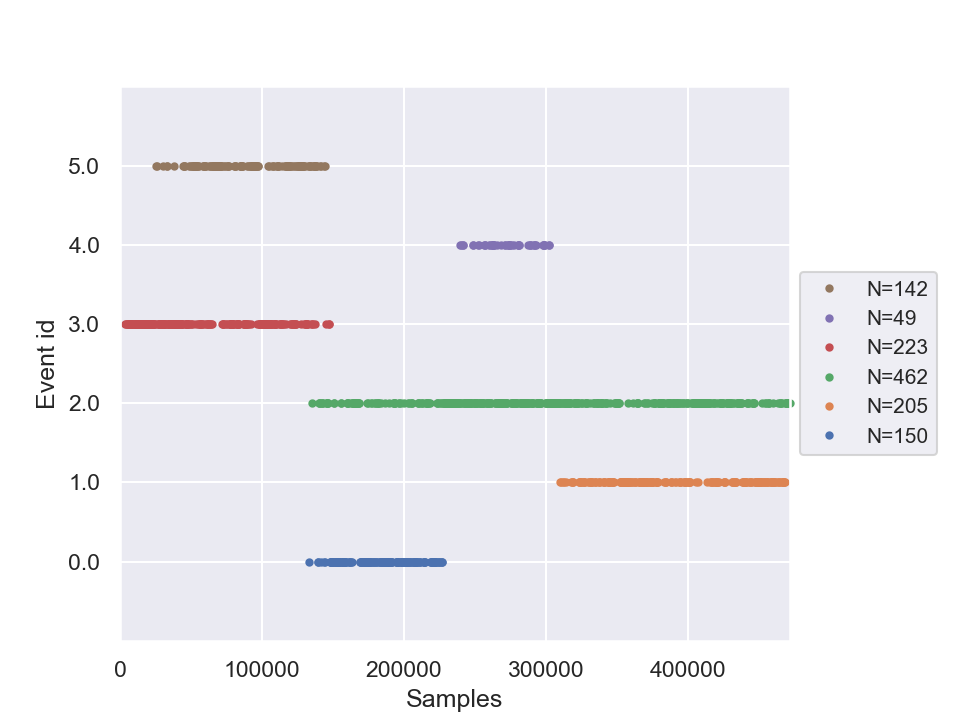

In [439]:
# Метод клатеризации Варда с учётом матрицы связности

cl_method, df_best_metrics = apply_cluster_method(data=psd_ecg_sp_FA6_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj20_ecg_sp_FA6_eucl_'+str(N_CLUSTERS), df_metrics=df_best_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
display(df_best_metrics)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)

cluster_events[:,2] = cl_method.labels_
#print(cluster_events)

fig = mne.viz.plot_events(cluster_events)


<IPython.core.display.Javascript object>


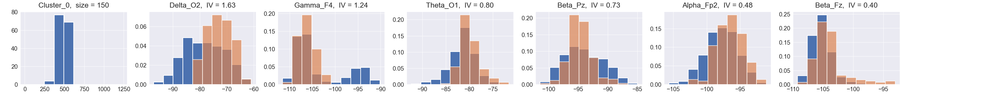

<IPython.core.display.Javascript object>


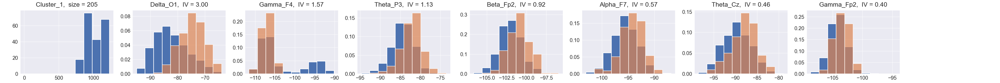

<IPython.core.display.Javascript object>


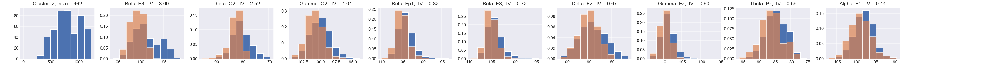

<IPython.core.display.Javascript object>


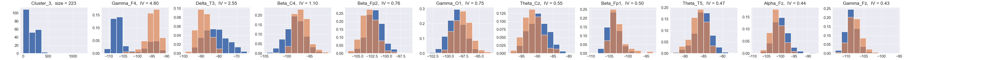

<IPython.core.display.Javascript object>


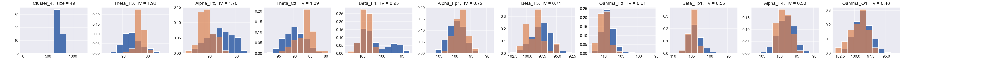

<IPython.core.display.Javascript object>


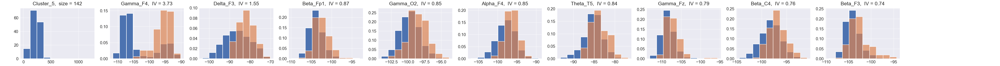

(<Figure size 3000x200 with 10 Axes>,
 array([<AxesSubplot:title={'center':'Cluster_5,  size = 142'}>,
        <AxesSubplot:title={'center':'Gamma_F4,  IV = 3.73'}>,
        <AxesSubplot:title={'center':'Delta_F3,  IV = 1.55'}>,
        <AxesSubplot:title={'center':'Beta_Fp1,  IV = 0.87'}>,
        <AxesSubplot:title={'center':'Gamma_O2,  IV = 0.85'}>,
        <AxesSubplot:title={'center':'Alpha_F4,  IV = 0.85'}>,
        <AxesSubplot:title={'center':'Theta_T5,  IV = 0.84'}>,
        <AxesSubplot:title={'center':'Gamma_Fz,  IV = 0.79'}>,
        <AxesSubplot:title={'center':'Beta_C4,  IV = 0.76'}>,
        <AxesSubplot:title={'center':'Beta_F3,  IV = 0.74'}>], dtype=object))

In [440]:
# Plotting best features for given clustering
N_BEST_FEATURES = 10

df_features = df_psd_ecg_ft
cluster_labels = cl_method.labels_
n_clusters = len(np.unique(cluster_labels))

# IV_list, WoE_list = IV_WoE_vars_clust(df_psd_ecg_ft, aggl_clusters.labels_) 
best_IV_list, best_WoE_list = best_IV_WoE_vars_clust(df_features, cluster_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)
#for i in range(len(best_IV_list)):
    #display(best_IV_list[i])
    
#for i in range(len(best_WoE_list)):
    #display(best_WoE_list[i])

plot_hist_best_vars(df_psd_ecg_ft, cluster_labels, best_IV_list)    
        

In [443]:
# Display correlation matrix of best features for each cluster
best_corr_list = []

for i in range(n_clusters):
    best_vars_list = best_IV_list[i]['Variable'].to_numpy()
    df_best_vars_corr = df_features[best_vars_list].corr()            
    best_corr_list.append(df_best_vars_corr)
    
for i in range(n_clusters):
    display_corr_matrix(best_corr_list[i], corr_bounds=[0.3, 0.4, 1])
    #display(best_corr_list[i])

,Delta_O2,Gamma_F4,Theta_O1,Beta_Pz,Alpha_Fp2,Beta_Fz
Delta_O2,1.00,-0.15,0.46,0.00,0.41,0.23
Gamma_F4,-0.15,1.00,-0.03,0.34,-0.06,0.07
Theta_O1,0.46,-0.03,1.00,0.45,0.40,0.22
Beta_Pz,0.00,0.34,0.45,1.00,0.02,0.10
Alpha_Fp2,0.41,-0.06,0.40,0.02,1.00,0.28
Beta_Fz,0.23,0.07,0.22,0.10,0.28,1.00


,Delta_O1,Gamma_F4,Theta_P3,Beta_Fp2,Alpha_F7,Theta_Cz,Gamma_Fp2
Delta_O1,1.00,-0.38,0.43,0.37,0.32,0.45,0.11
Gamma_F4,-0.38,1.00,0.02,-0.18,-0.15,-0.11,0.21
Theta_P3,0.43,0.02,1.00,0.19,0.39,0.40,0.06
Beta_Fp2,0.37,-0.18,0.19,1.00,0.33,0.30,0.38
Alpha_F7,0.32,-0.15,0.39,0.33,1.00,0.16,-0.00
Theta_Cz,0.45,-0.11,0.40,0.30,0.16,1.00,0.13
Gamma_Fp2,0.11,0.21,0.06,0.38,-0.00,0.13,1.00


,Beta_F8,Theta_O2,Gamma_O2,Beta_Fp1,Beta_F3,Delta_Fz,Gamma_Fz,Theta_Pz,Alpha_F4
Beta_F8,1.00,0.26,0.46,0.49,0.28,-0.10,0.41,0.37,0.38
Theta_O2,0.26,1.00,0.38,0.20,0.38,0.45,0.12,0.44,0.35
Gamma_O2,0.46,0.38,1.00,0.32,0.28,0.04,0.39,0.23,0.18
Beta_Fp1,0.49,0.20,0.32,1.00,0.40,0.03,0.40,0.15,0.23
Beta_F3,0.28,0.38,0.28,0.40,1.00,0.23,0.25,0.21,0.27
Delta_Fz,-0.10,0.45,0.04,0.03,0.23,1.00,0.09,0.16,0.14
Gamma_Fz,0.41,0.12,0.39,0.40,0.25,0.09,1.00,0.13,0.14
Theta_Pz,0.37,0.44,0.23,0.15,0.21,0.16,0.13,1.00,0.36
Alpha_F4,0.38,0.35,0.18,0.23,0.27,0.14,0.14,0.36,1.00


,Gamma_F4,Delta_T3,Beta_C4,Beta_Fp2,Gamma_O1,Theta_Cz,Beta_Fp1,Theta_T5,Alpha_Fz,Gamma_Fz
Gamma_F4,1.00,-0.37,0.42,-0.18,0.45,-0.11,0.45,-0.06,-0.11,0.45
Delta_T3,-0.37,1.00,-0.11,0.42,-0.04,0.45,0.01,0.39,0.26,-0.04
Beta_C4,0.42,-0.11,1.00,0.09,0.25,0.13,0.37,0.29,0.05,0.26
Beta_Fp2,-0.18,0.42,0.09,1.00,0.04,0.30,0.25,0.33,0.31,0.14
Gamma_O1,0.45,-0.04,0.25,0.04,1.00,0.05,0.29,0.01,-0.04,0.36
Theta_Cz,-0.11,0.45,0.13,0.30,0.05,1.00,0.08,0.47,0.30,0.02
Beta_Fp1,0.45,0.01,0.37,0.25,0.29,0.08,1.00,0.14,0.20,0.40
Theta_T5,-0.06,0.39,0.29,0.33,0.01,0.47,0.14,1.00,0.36,0.04
Alpha_Fz,-0.11,0.26,0.05,0.31,-0.04,0.30,0.20,0.36,1.00,0.21
Gamma_Fz,0.45,-0.04,0.26,0.14,0.36,0.02,0.40,0.04,0.21,1.00


,Theta_T3,Alpha_Pz,Theta_Cz,Beta_F4,Alpha_Fp1,Beta_T3,Gamma_Fz,Beta_Fp1,Alpha_F4,Gamma_O1
Theta_T3,1.00,-0.06,0.48,-0.26,0.34,0.47,-0.06,0.03,0.18,-0.03
Alpha_Pz,-0.06,1.00,0.08,0.40,-0.14,0.49,0.16,0.18,0.34,0.17
Theta_Cz,0.48,0.08,1.00,-0.04,0.32,0.17,0.02,0.08,0.22,0.05
Beta_F4,-0.26,0.40,-0.04,1.00,-0.01,0.16,0.42,0.49,0.40,0.43
Alpha_Fp1,0.34,-0.14,0.32,-0.01,1.00,0.19,0.02,0.38,0.26,-0.01
Beta_T3,0.47,0.49,0.17,0.16,0.19,1.00,0.12,0.29,0.32,0.14
Gamma_Fz,-0.06,0.16,0.02,0.42,0.02,0.12,1.00,0.40,0.14,0.36
Beta_Fp1,0.03,0.18,0.08,0.49,0.38,0.29,0.40,1.00,0.23,0.29
Alpha_F4,0.18,0.34,0.22,0.40,0.26,0.32,0.14,0.23,1.00,0.13
Gamma_O1,-0.03,0.17,0.05,0.43,-0.01,0.14,0.36,0.29,0.13,1.00


,Gamma_F4,Delta_F3,Beta_Fp1,Gamma_O2,Alpha_F4,Theta_T5,Gamma_Fz,Beta_C4,Beta_F3
Gamma_F4,1.00,-0.15,0.45,0.43,0.22,-0.06,0.45,0.42,0.18
Delta_F3,-0.15,1.00,0.13,0.20,0.15,0.38,0.08,0.02,0.43
Beta_Fp1,0.45,0.13,1.00,0.32,0.23,0.14,0.40,0.37,0.40
Gamma_O2,0.43,0.20,0.32,1.00,0.18,0.16,0.39,0.29,0.28
Alpha_F4,0.22,0.15,0.23,0.18,1.00,0.43,0.14,0.44,0.27
Theta_T5,-0.06,0.38,0.14,0.16,0.43,1.00,0.04,0.29,0.20
Gamma_Fz,0.45,0.08,0.40,0.39,0.14,0.04,1.00,0.26,0.25
Beta_C4,0.42,0.02,0.37,0.29,0.44,0.29,0.26,1.00,0.29
Beta_F3,0.18,0.43,0.40,0.28,0.27,0.20,0.25,0.29,1.00


In [447]:
# Формируем икусственные кластеры по результатам кластеризации adj20_ecg_sp_FA6_eucl_6

cluster_labels = cl_method.labels_
n_clusters = len(np.unique(cluster_labels))

samples_in_cluster = []
for i in range(n_clusters):
    cl_samples = np.asarray(np.where(cluster_labels == i)).flatten()
    samples_in_cluster.append(cl_samples)
    print('Cluster '+str(i)+': ', samples_in_cluster[i][0], samples_in_cluster[i][-1])
    #print(samples_in_cluster[i])
    
new_labels = np.zeros(len(cluster_labels)) 
for i in range(len(new_labels)):
    if (cluster_labels[i] in {3,5}) and (i <= samples_in_cluster[3][-1]):
        new_labels[i] = 0
    if (cluster_labels[i] in {0,2}) and (i <= samples_in_cluster[0][-1]):
        new_labels[i] = 1
    if (cluster_labels[i] in {2,4}) and (samples_in_cluster[0][-1] < i < samples_in_cluster[1][0]):
        new_labels[i] = 2
    if (cluster_labels[i] in {1,2}) and (i >= samples_in_cluster[1][0]):
        new_labels[i] = 3
       

Cluster 0:  344 594
Cluster 1:  813 1221
Cluster 2:  349 1230
Cluster 3:  0 382
Cluster 4:  627 791
Cluster 5:  55 373


<IPython.core.display.Javascript object>


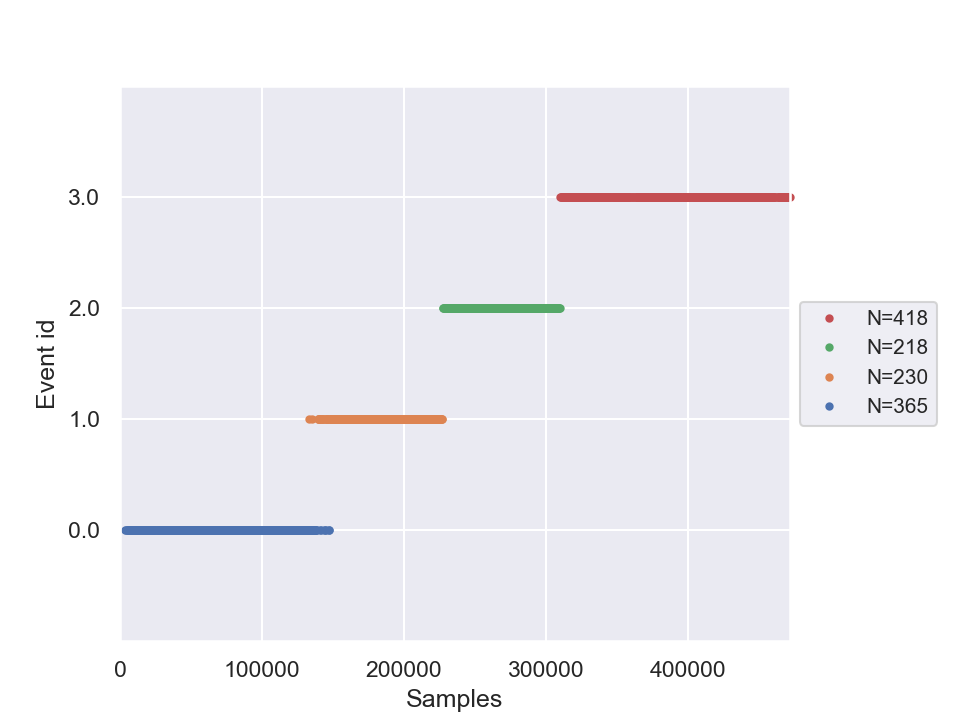

In [437]:
# Plotiing tied to time artificial clusters

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)

cluster_events[:,2] = new_labels
#print(cluster_events)

fig = mne.viz.plot_events(cluster_events)


In [457]:
# Находим гранииы кластеров
df_features = df_psd_ecg_ft
cluster_labels = new_labels
n_clusters = len(np.unique(cluster_labels))

ts_freq = 500

min_cl_sample = np.zeros(n_clusters)
max_cl_sample = np.zeros(n_clusters)
min_cl_time = np.zeros(n_clusters)
max_cl_time = np.zeros(n_clusters)

for i in range(n_clusters):
    cl_samples = np.asarray(np.where(cluster_labels == i)).flatten()
    min_cl_sample[i] = cl_samples[0]
    max_cl_sample[i] = cl_samples[-1]
    min_cl_time[i] = cluster_events[int(min_cl_sample[i]),0] // ts_freq
    max_cl_time[i] = cluster_events[int(max_cl_sample[i]),0] // ts_freq
    
print('min_cl_sample: ', min_cl_sample)
print('max_cl_sample: ', max_cl_sample)
print('min_cl_time: ', min_cl_time)
print('max_cl_time: ', max_cl_time)

min_cl_sample:  [  0. 344. 595. 813.]
max_cl_sample:  [ 382.  594.  812. 1230.]
min_cl_time:  [  7. 266. 454. 620.]
max_cl_time:  [294. 454. 619. 943.]


In [460]:
print(epochs_ecg)

bad_indices = [0:int(min_cl_sample[0])] + [int(max_cl_sample[0]): len(cluster_labels)]
bad_indices

SyntaxError: invalid syntax (<ipython-input-460-60e09783461c>, line 3)

In [ ]:
for i in range(n_clusters):
    epochs_cl = epochs_ecg.copy()
    bad_indices = [0:int(min_cl_sample[i])] + [int(max_cl_sample[i]), len(cluster_labels)]

epochs['visual/right'].plot_psd_topomap()

<IPython.core.display.Javascript object>


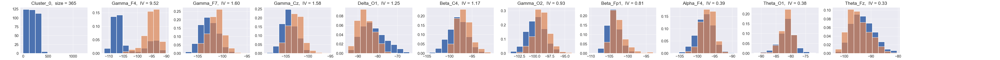

<IPython.core.display.Javascript object>


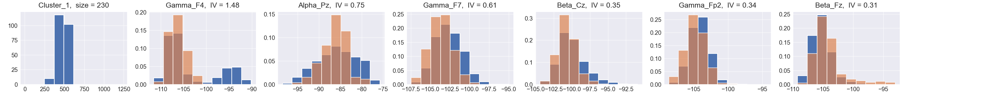

<IPython.core.display.Javascript object>


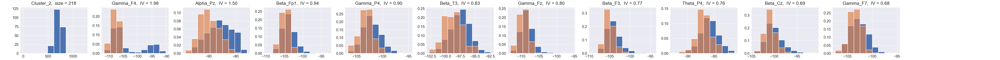

<IPython.core.display.Javascript object>


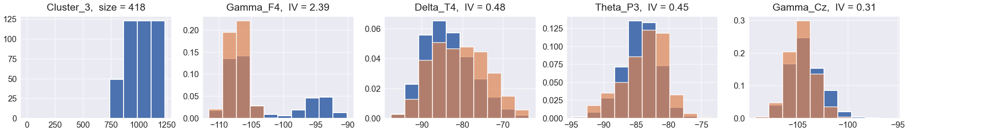

(<Figure size 1500x200 with 5 Axes>,
 array([<AxesSubplot:title={'center':'Cluster_3,  size = 418'}>,
        <AxesSubplot:title={'center':'Gamma_F4,  IV = 2.39'}>,
        <AxesSubplot:title={'center':'Delta_T4,  IV = 0.48'}>,
        <AxesSubplot:title={'center':'Theta_P3,  IV = 0.45'}>,
        <AxesSubplot:title={'center':'Gamma_Cz,  IV = 0.31'}>],
       dtype=object))

In [444]:
# Plotting best features for given clustering
N_BEST_FEATURES = 10

# IV_list, WoE_list = IV_WoE_vars_clust(df_psd_ecg_ft, aggl_clusters.labels_) 
best_IV_list, best_WoE_list = best_IV_WoE_vars_clust(df_features, cluster_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.6, IV_threshold=0.3)
#for i in range(len(best_IV_list)):
    #display(best_IV_list[i])
    
#for i in range(len(best_WoE_list)):
    #display(best_WoE_list[i])

plot_hist_best_vars(df_psd_ecg_ft, cluster_labels, best_IV_list)    
        

In [446]:
# Display correlation matrix of best features for each cluster
best_corr_list = []

for i in range(n_clusters):
    best_vars_list = best_IV_list[i]['Variable'].to_numpy()
    df_best_vars_corr = df_features[best_vars_list].corr()            
    best_corr_list.append(df_best_vars_corr)
    
for i in range(n_clusters):
    print('Cluster '+str(i))
    display_corr_matrix(best_corr_list[i], corr_bounds=[0.3, 0.45, 1])
    #display(best_corr_list[i])

Cluster 0


,Gamma_F4,Gamma_F7,Gamma_Cz,Delta_O1,Beta_C4,Gamma_O2,Beta_Fp1,Alpha_F4,Theta_O1,Theta_Fz
Gamma_F4,1.00,0.56,0.58,-0.38,0.42,0.43,0.45,0.22,-0.03,-0.24
Gamma_F7,0.56,1.00,0.46,-0.02,0.28,0.45,0.42,0.14,0.05,-0.05
Gamma_Cz,0.58,0.46,1.00,-0.16,0.29,0.49,0.37,0.09,0.01,-0.15
Delta_O1,-0.38,-0.02,-0.16,1.00,-0.08,0.13,-0.00,0.07,0.55,0.57
Beta_C4,0.42,0.28,0.29,-0.08,1.00,0.29,0.37,0.44,0.45,-0.06
Gamma_O2,0.43,0.45,0.49,0.13,0.29,1.00,0.32,0.18,0.23,0.04
Beta_Fp1,0.45,0.42,0.37,-0.00,0.37,0.32,1.00,0.23,0.16,0.06
Alpha_F4,0.22,0.14,0.09,0.07,0.44,0.18,0.23,1.00,0.38,0.22
Theta_O1,-0.03,0.05,0.01,0.55,0.45,0.23,0.16,0.38,1.00,0.33
Theta_Fz,-0.24,-0.05,-0.15,0.57,-0.06,0.04,0.06,0.22,0.33,1.00


Cluster 1


,Gamma_F4,Alpha_Pz,Gamma_F7,Beta_Cz,Gamma_Fp2,Beta_Fz
Gamma_F4,1.00,0.34,0.56,0.32,0.21,0.07
Alpha_Pz,0.34,1.00,0.15,0.59,0.09,0.08
Gamma_F7,0.56,0.15,1.00,0.23,0.33,0.08
Beta_Cz,0.32,0.59,0.23,1.00,0.19,0.29
Gamma_Fp2,0.21,0.09,0.33,0.19,1.00,0.17
Beta_Fz,0.07,0.08,0.08,0.29,0.17,1.00


Cluster 2


,Gamma_F4,Alpha_Pz,Beta_Fp1,Gamma_P4,Beta_T3,Gamma_Fz,Beta_F3,Theta_P4,Beta_Cz,Gamma_F7
Gamma_F4,1.00,0.34,0.45,0.53,0.06,0.45,0.18,0.05,0.32,0.56
Alpha_Pz,0.34,1.00,0.18,0.28,0.49,0.16,0.20,0.49,0.59,0.15
Beta_Fp1,0.45,0.18,1.00,0.39,0.29,0.40,0.40,0.19,0.29,0.42
Gamma_P4,0.53,0.28,0.39,1.00,0.29,0.55,0.34,0.39,0.31,0.51
Beta_T3,0.06,0.49,0.29,0.29,1.00,0.12,0.37,0.59,0.26,0.14
Gamma_Fz,0.45,0.16,0.40,0.55,0.12,1.00,0.25,0.13,0.24,0.38
Beta_F3,0.18,0.20,0.40,0.34,0.37,0.25,1.00,0.43,0.27,0.19
Theta_P4,0.05,0.49,0.19,0.39,0.59,0.13,0.43,1.00,0.29,0.13
Beta_Cz,0.32,0.59,0.29,0.31,0.26,0.24,0.27,0.29,1.00,0.23
Gamma_F7,0.56,0.15,0.42,0.51,0.14,0.38,0.19,0.13,0.23,1.00


Cluster 3


,Gamma_F4,Delta_T4,Theta_P3,Gamma_Cz
Gamma_F4,1.00,-0.34,0.02,0.58
Delta_T4,-0.34,1.00,0.41,-0.14
Theta_P3,0.02,0.41,1.00,0.05
Gamma_Cz,0.58,-0.14,0.05,1.00


,Method,Silh,Cal-Har,Dav-Bold
0,adj20_ecg_sp_FA6_eucl_6,0.114739,243.752226,2.548828
1,adj20_ecg_int_sp_FA6_eucl_6,0.043144,248.013232,3.916733
2,adj20_fix_1s_sp_FA6_eucl_6,0.117022,197.192870,2.314444
3,adj20_fix_1s_ft_FA_eucl_6,0.078152,232.803229,1.922464
4,adj20_fix_1s_sp_FA3_eucl_6,0.088571,229.930475,2.622932
5,adj20_fix_1s_sp_FA5_eucl_6,0.120209,226.337859,2.396570
6,adj20_fix_1s_sp_FA4_eucl_6,0.126237,228.767039,1.647383
7,adj20_ecg_int_sp_FA5_eucl_6,0.044162,191.713004,2.873680


<IPython.core.display.Javascript object>


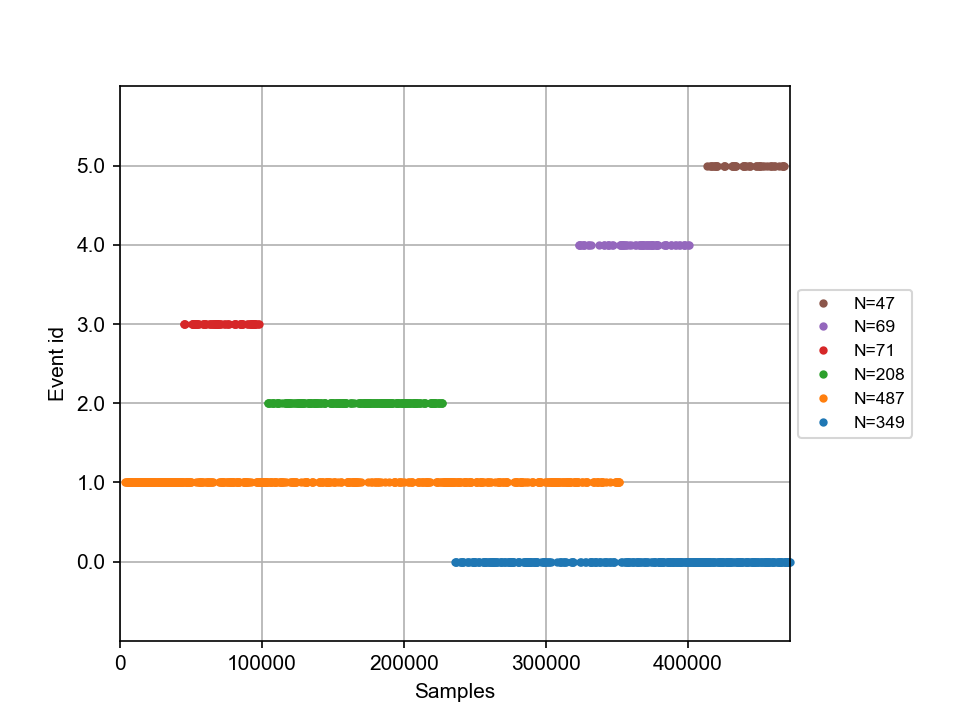

In [395]:
# Метод клатеризации Варда с учётом матрицы связности
K_NEIGHBORS = 15
N_CLUSTERS = 6

cl_method, df_best_metrics = apply_cluster_method(data=psd_ecg_int_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj20_ecg_int_sp_FA5_eucl_'+str(N_CLUSTERS), df_metrics=df_best_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
display(df_best_metrics)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)

cluster_events[:,2] = cl_method.labels_
#print(cluster_events)

fig = mne.viz.plot_events(cluster_events)


,Method,Silh,Cal-Har,Dav-Bold
0,adj20_ecg_sp_FA6_eucl_6,0.114739,243.752226,2.548828
1,adj20_ecg_int_sp_FA6_eucl_6,0.043144,248.013232,3.916733
2,adj20_fix_1s_ft_FA_eucl_6,0.078152,232.803229,1.922464
3,adj20_fix_1s_sp_FA3_eucl_6,0.088571,229.930475,2.622932
4,adj20_fix_1s_sp_FA4_eucl_6,0.126237,228.767039,1.647383
5,adj20_ecg_int_sp_FA5_eucl_6,0.044162,191.713004,2.873680
6,adj20_fix_1s_sp_FA6_eucl_6,0.077934,134.653281,2.487350
7,adj20_fix_1s_sp_FA5_eucl_6,0.075642,150.511599,1.978426


<IPython.core.display.Javascript object>


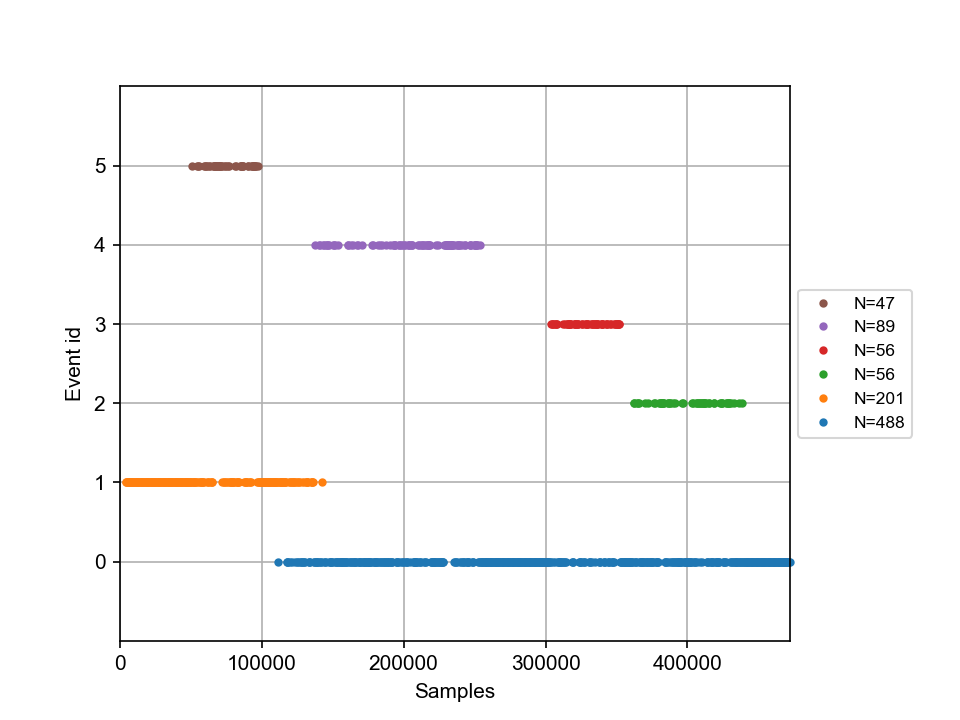

In [398]:
# Метод клатеризации Варда с учётом матрицы связности
N_CLUSTERS = 6

cl_method, df_best_metrics = apply_cluster_method(data=psd_fix_1s_sp_FA5_eucl, cl_method=AgglomerativeClustering, 
                                                      name='adj20_fix_1s_sp_FA5_eucl_'+str(N_CLUSTERS), df_metrics=df_best_metrics, 
                                                      n_clusters=N_CLUSTERS, linkage='ward', connectivity=knn_con_matr)
display(df_best_metrics)

cluster_events = fix_1s_events
#cluster_events = np.delete(cluster_events, -1, axis=0)

cluster_events[:,2] = cl_method.labels_
#print(cluster_events)

fig = mne.viz.plot_events(cluster_events)


[[  3850      0      4]
 [  4350      0      4]
 [  4850      0      4]
 ...
 [470850      0      0]
 [471350      0      0]
 [471850      0      0]]


<IPython.core.display.Javascript object>


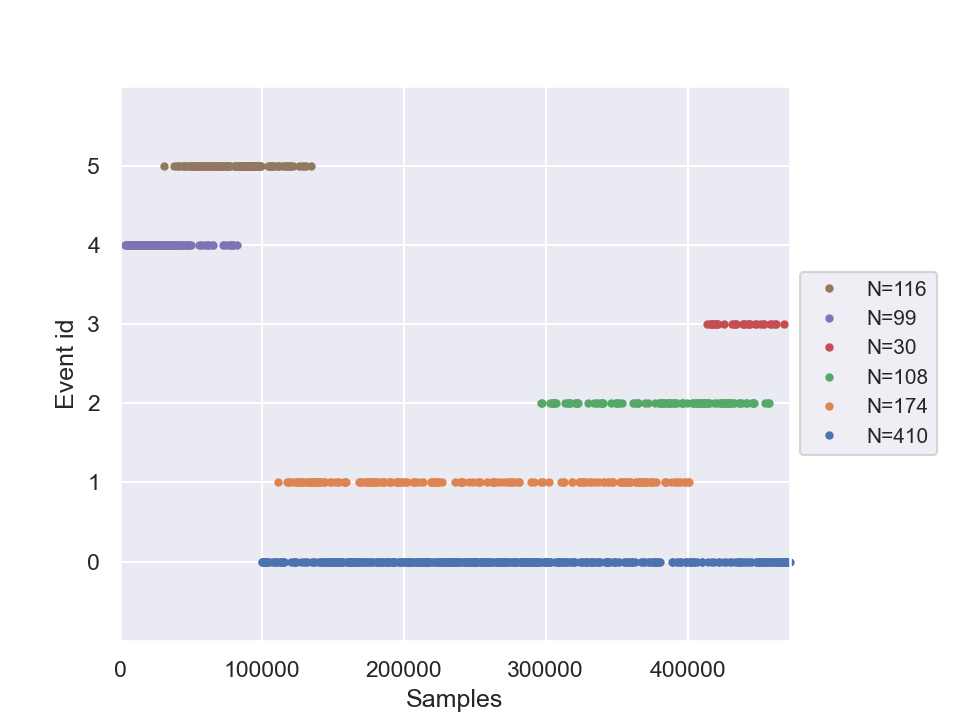

In [468]:
# Метод клатеризации Варда с учётом матрицы связности
from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering

cluster_events = fix_1s_events
#cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

aggl_clusters = AgglomerativeClustering(linkage="ward", n_clusters=6, connectivity=knn_con_matr).fit(psd_features)
#    print(aggl_clusters.labels_.shape)

cluster_events[:,2] = aggl_clusters.labels_
print(cluster_events)

fig = mne.viz.plot_events(cluster_events)

In [465]:
cluster_events[:,0].shape
cluster_events.shape

(937, 3)

In [55]:
# Определение оптимального числка кластеров K-Means

from sklearn.cluster import KMeans
from sklearn.cluster import AgglomerativeClustering

print(82 * "_")
print("method \t\t silh\t cal-har\t dav-bold\t homo\t compl\t v-meas\t ARI\t AMI")

for n in range(2,11):
    cluster_method = KMeans(n_clusters=n, random_state=0)
    kmeans_ft = cluster_method.fit(psd_features)
    bench_cluster_metrics(name="kmeans_ft_"+str(n), data=psd_features, labels_pred=kmeans_ft.labels_, labels_true=kmeans_ft.labels_)

for n in range(2,11):
    cluster_method = KMeans(n_clusters=n, random_state=0)
    kmeans_FA_ward = cluster_method.fit(psd_spectr_FA_ward)
    bench_cluster_metrics(name="kmeans_FA_ward_"+str(n), data=psd_spectr_FA_ward, labels_pred=kmeans_FA_ward.labels_, labels_true=kmeans_ft.labels_)

for n in range(2,11):
    cluster_method = KMeans(n_clusters=n, random_state=0)
    kmeans_ft_sc = cluster_method.fit(psd_features_scaled)
    bench_cluster_metrics(name="kmeans_ft_sc_"+str(n), data=psd_features_scaled, labels_pred=kmeans_ft_sc.labels_, labels_true=kmeans_ft_sc.labels_)

for n in range(2,11):
    cluster_method = KMeans(n_clusters=n, random_state=0)
    kmeans_pca = cluster_method.fit(psd_PCA_components)
    bench_cluster_metrics(name="kmeans_pca_"+str(n), data=psd_PCA_components, labels_pred=kmeans_pca.labels_, labels_true=kmeans_pca.labels_)

for n in range(2,11):
    cluster_method = KMeans(n_clusters=n, random_state=0)
    kmeans_pca_sc = cluster_method.fit(psd_PCA_comp_scaled)
    bench_cluster_metrics(name="kmeans_pca_sc_"+str(n), data=psd_PCA_comp_scaled, labels_pred=kmeans_pca_sc.labels_, labels_true=kmeans_pca_sc.labels_)

for n in range(2,11):
    cluster_method = AgglomerativeClustering(linkage="ward", n_clusters=n, connectivity=connect_matrix)
    aggl_clustering = cluster_method.fit(psd_spectr_FA_ward)
    bench_cluster_metrics(name="ward_adj_FA_ward"+str(n), data=psd_spectr_FA_ward, labels_pred=aggl_clustering.labels_, labels_true=kmeans_FA_ward.labels_)

print(82 * "_")

__________________________________________________________________________________
method 		 silh	 cal-har	 dav-bold	 homo	 compl	 v-meas	 ARI	 AMI
kmeans_ft_2	0.250	541.027		1.458		1.000	1.000	1.000	1.000	1.000
kmeans_ft_3	0.173	393.857		1.798		1.000	1.000	1.000	1.000	1.000
kmeans_ft_4	0.166	341.462		1.702		1.000	1.000	1.000	1.000	1.000
kmeans_ft_5	0.153	299.031		1.744		1.000	1.000	1.000	1.000	1.000
kmeans_ft_6	0.152	271.604		1.777		1.000	1.000	1.000	1.000	1.000
kmeans_ft_7	0.150	246.634		1.823		1.000	1.000	1.000	1.000	1.000
kmeans_ft_8	0.130	224.262		1.877		1.000	1.000	1.000	1.000	1.000
kmeans_ft_9	0.142	207.328		1.790		1.000	1.000	1.000	1.000	1.000
kmeans_ft_10	0.126	192.618		1.891		1.000	1.000	1.000	1.000	1.000
kmeans_FA_ward_2	0.300	720.298		1.242		0.217	0.718	0.334	0.135	0.332
kmeans_FA_ward_3	0.253	550.803		1.427		0.367	0.774	0.498	0.263	0.496
kmeans_FA_ward_4	0.208	485.749		1.497		0.444	0.736	0.554	0.366	0.551
kmeans_FA_ward_5	0.208	436.764		1.495		0.505	0.709	0.590	0.422	0.586

In [56]:
print(psd_features.shape[0])

1231


(1231,)
[[3.79400e+03 0.00000e+00 3.00000e+00]
 [4.18100e+03 0.00000e+00 3.00000e+00]
 [4.95900e+03 0.00000e+00 3.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 2.00000e+00]
 [4.71229e+05 0.00000e+00 2.00000e+00]
 [4.71594e+05 0.00000e+00 2.00000e+00]]


<IPython.core.display.Javascript object>


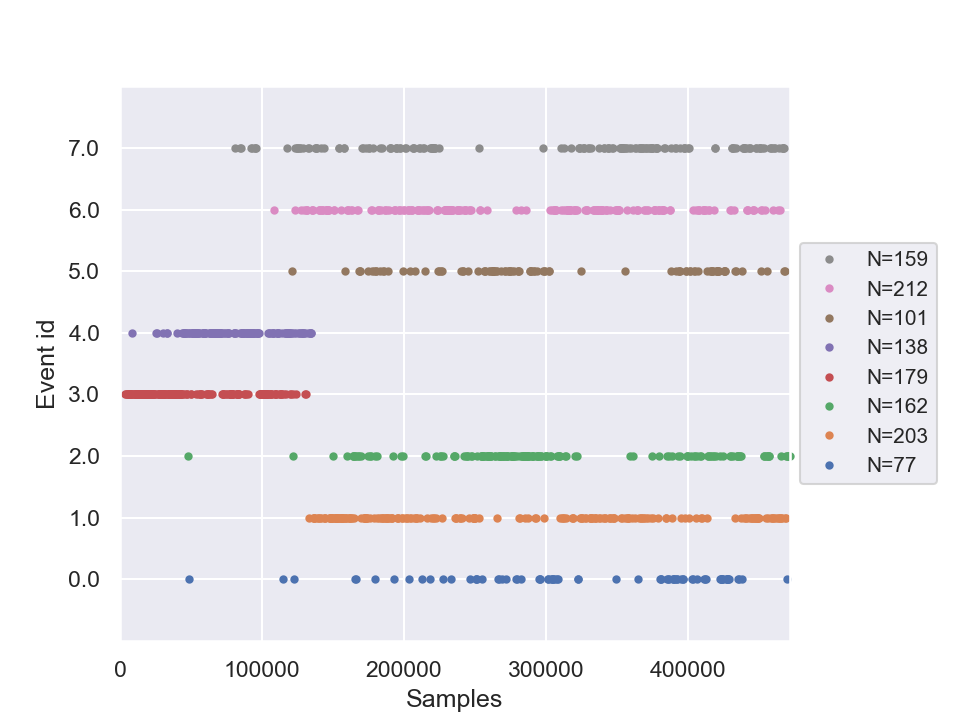

In [60]:
kmeans_clusters = cluster.KMeans(n_clusters=8).fit(psd_spectr_FA_ward)
print(kmeans_clusters.labels_.shape)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

cluster_events[:,2] = kmeans_clusters.labels_
print(cluster_events)

fig = mne.viz.plot_events(cluster_events)

(1231,)
[[3.79400e+03 0.00000e+00 6.00000e+00]
 [4.18100e+03 0.00000e+00 6.00000e+00]
 [4.95900e+03 0.00000e+00 6.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 4.00000e+00]
 [4.71229e+05 0.00000e+00 0.00000e+00]
 [4.71594e+05 0.00000e+00 0.00000e+00]]


<IPython.core.display.Javascript object>


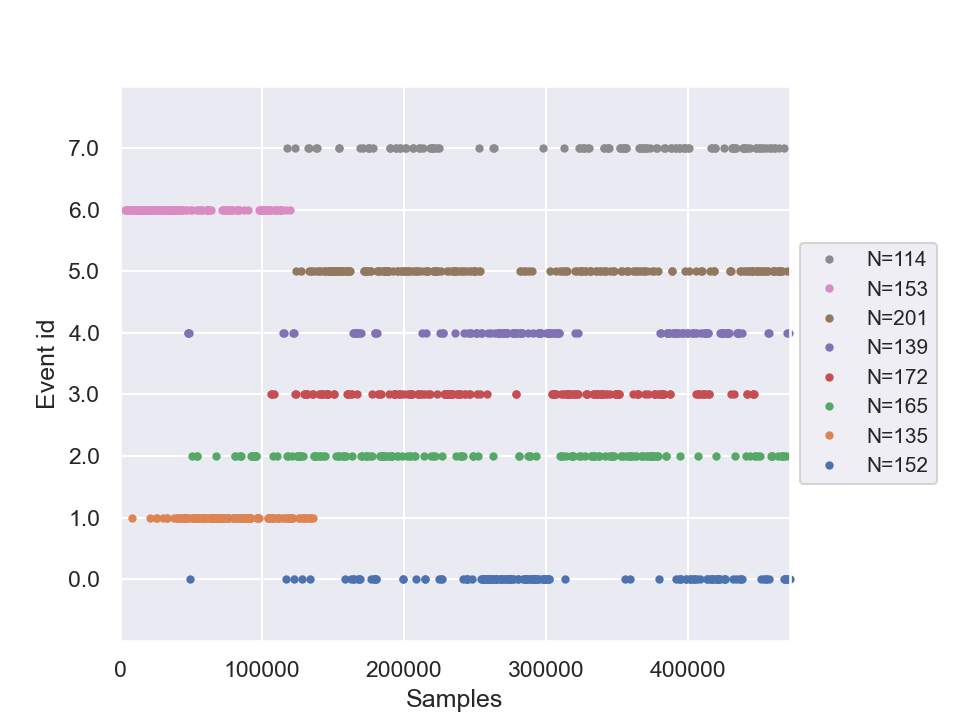

In [61]:
kmeans_clusters = cluster.KMeans(n_clusters=8).fit(psd_PCA_components)
print(kmeans_clusters.labels_.shape)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

cluster_events[:,2] = kmeans_clusters.labels_
print(cluster_events)

fig = mne.viz.plot_events(cluster_events)

(1231,)
[[3.79400e+03 0.00000e+00 2.00000e+00]
 [4.18100e+03 0.00000e+00 2.00000e+00]
 [4.95900e+03 0.00000e+00 2.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 0.00000e+00]
 [4.71229e+05 0.00000e+00 1.00000e+00]
 [4.71594e+05 0.00000e+00 1.00000e+00]]


<IPython.core.display.Javascript object>


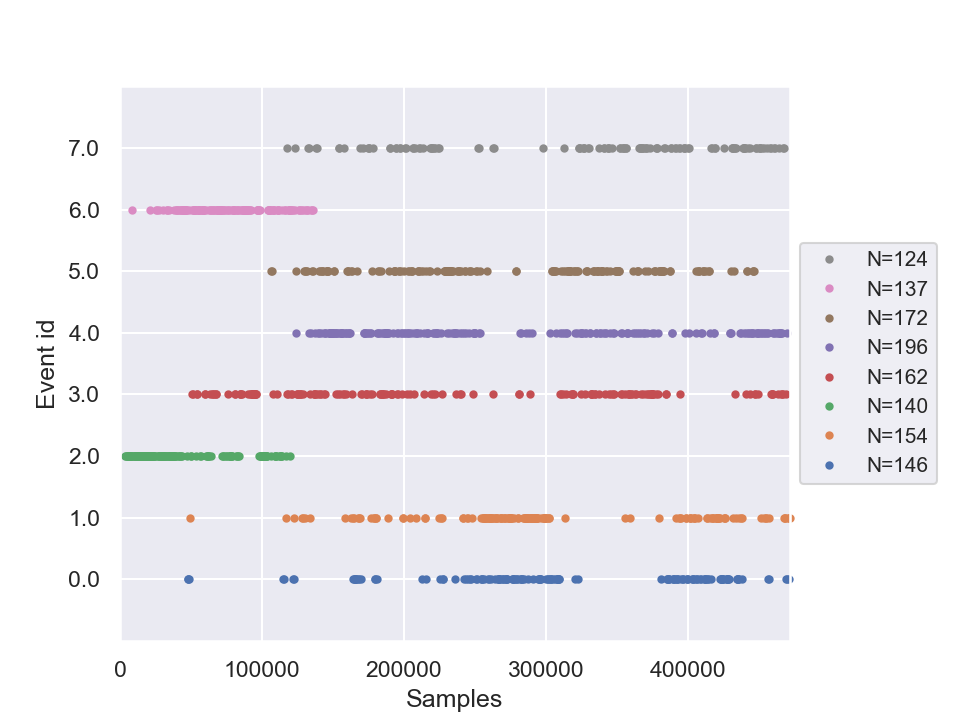

In [62]:
kmeans_clusters = cluster.KMeans(n_clusters=8).fit(psd_features)
print(kmeans_clusters.labels_.shape)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

cluster_events[:,2] = kmeans_clusters.labels_
print(cluster_events)

fig = mne.viz.plot_events(cluster_events)

<IPython.core.display.Javascript object>


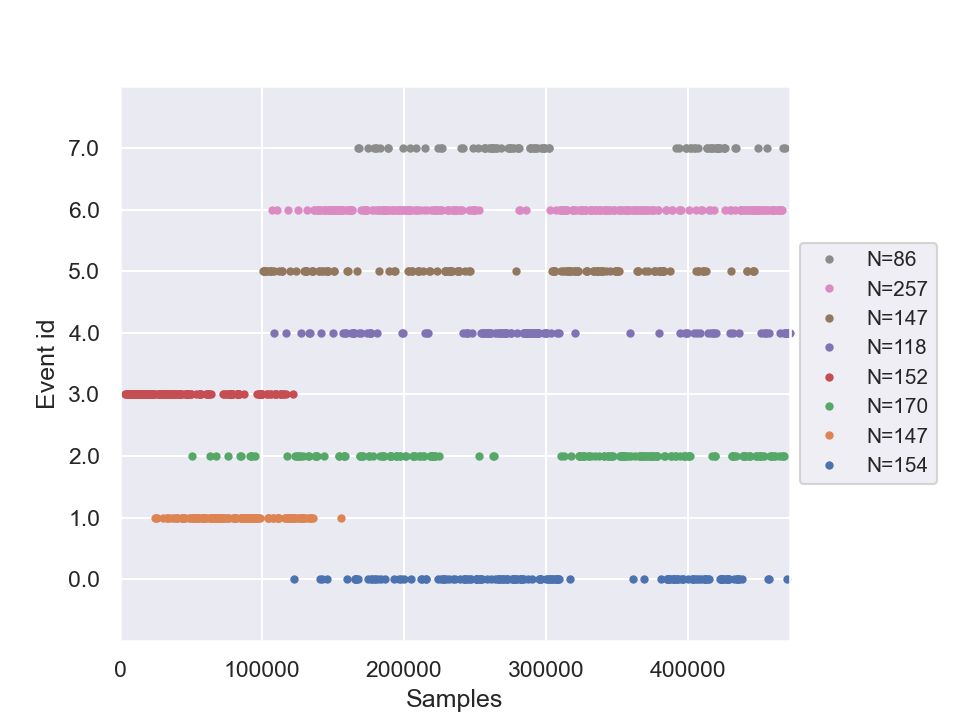

<IPython.core.display.Javascript object>


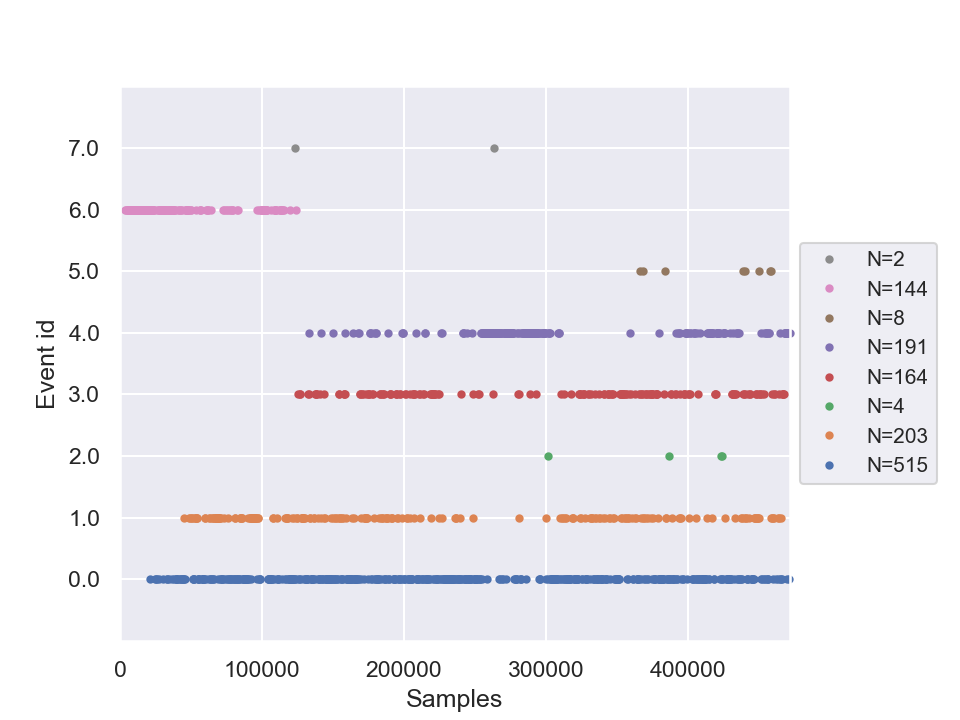

<IPython.core.display.Javascript object>


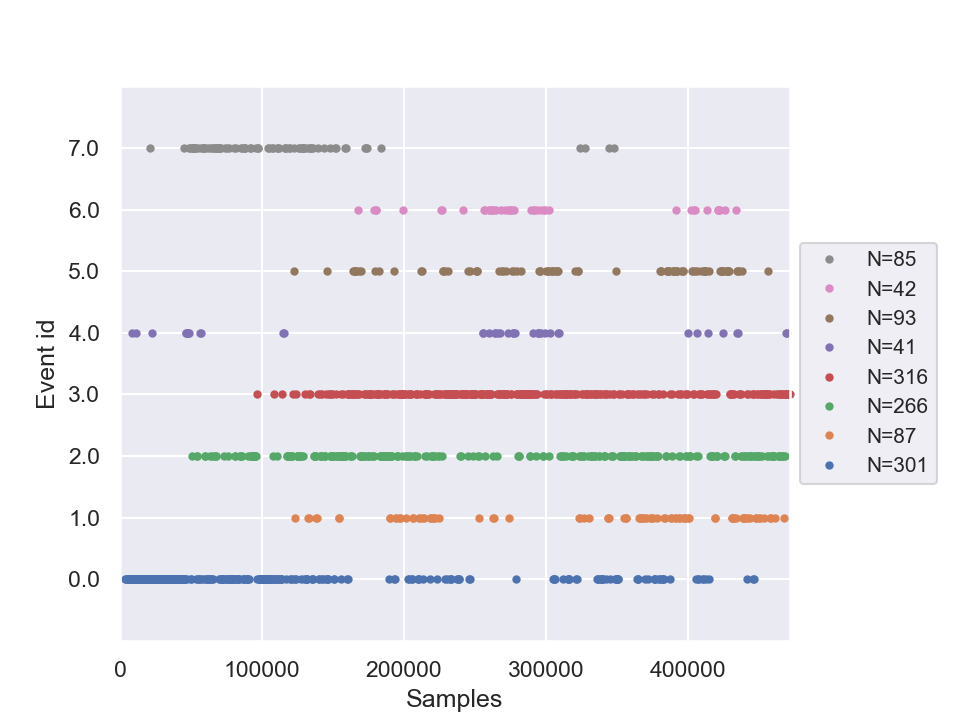

<IPython.core.display.Javascript object>


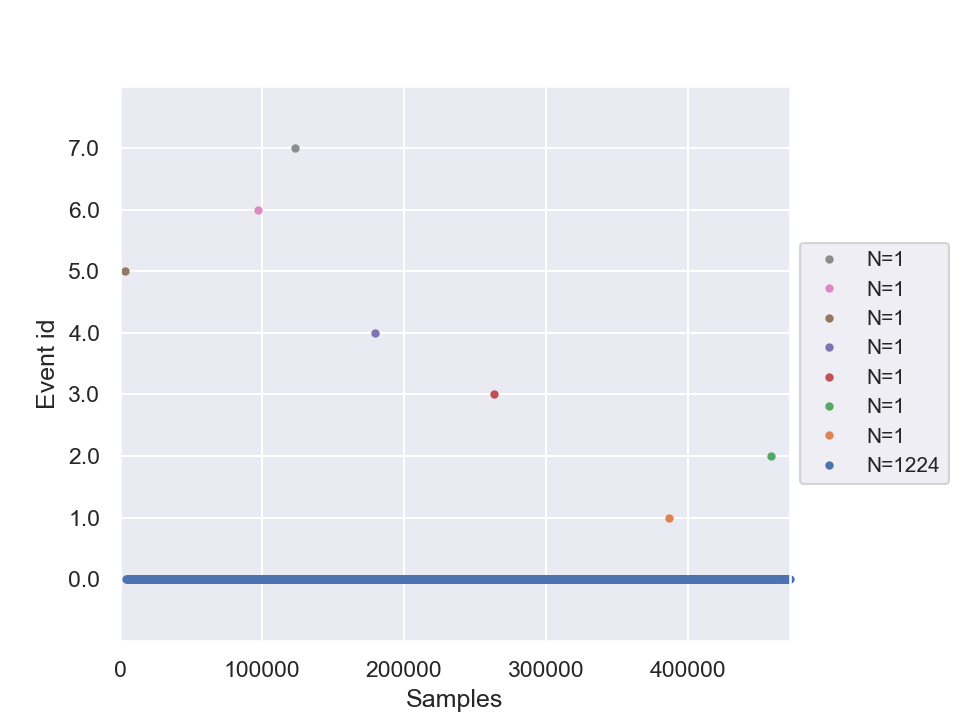

In [63]:
from sklearn.cluster import AgglomerativeClustering

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

for linkage in ("ward", "average", "complete", "single"):
    aggl_clusters = AgglomerativeClustering(linkage=linkage, n_clusters=8).fit(psd_PCA_components)
#    print(aggl_clusters.labels_.shape)

    cluster_events[:,2] = aggl_clusters.labels_
#    print(cluster_events)

    fig = mne.viz.plot_events(cluster_events)

(1231,)
[[ 3.79400e+03  0.00000e+00 -1.00000e+00]
 [ 4.18100e+03  0.00000e+00 -1.00000e+00]
 [ 4.95900e+03  0.00000e+00 -1.00000e+00]
 ...
 [ 4.70868e+05  0.00000e+00  3.00000e+00]
 [ 4.71229e+05  0.00000e+00  2.00000e+00]
 [ 4.71594e+05  0.00000e+00  2.00000e+00]]


<IPython.core.display.Javascript object>


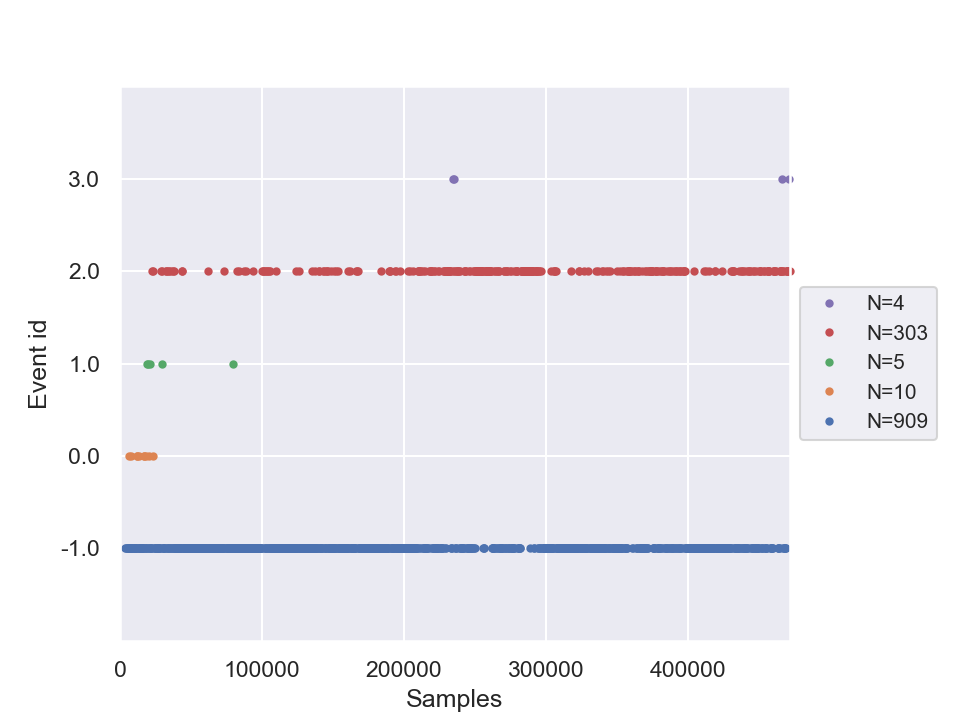

In [64]:
dbscan_clusters = cluster.DBSCAN(eps=2.4, min_samples=6).fit(psd_PCA_comp_scaled)
print(dbscan_clusters.labels_.shape)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
#print(cluster_events)

cluster_events[:,2] = dbscan_clusters.labels_
print(cluster_events)

fig = mne.viz.plot_events(cluster_events)

In [65]:
print(cluster_events.shape)
print(cluster_events)

(1231, 3)
[[ 3.79400e+03  0.00000e+00 -1.00000e+00]
 [ 4.18100e+03  0.00000e+00 -1.00000e+00]
 [ 4.95900e+03  0.00000e+00 -1.00000e+00]
 ...
 [ 4.70868e+05  0.00000e+00  3.00000e+00]
 [ 4.71229e+05  0.00000e+00  2.00000e+00]
 [ 4.71594e+05  0.00000e+00  2.00000e+00]]


In [66]:
print(psd_PCA_components.shape)

(1231, 15)


# IV and feature importance exploration

In [12]:
import pandas as pd
d = pd.DataFrame([
    [ 1,  19, 0 ],
    [ 2,  18, 0 ],
    [ 3,  17, 0 ],
    [ 4,  16, 0 ],
    [ 5,  15, 1 ],
    [ 6,  14, 1 ],
    [ 7,  13, 1 ],
    [ 8,  12, 1 ],
    [ 9,  11, 1 ],
    [ 10,  10, 1 ],
    [ 11,  9, 1 ],
    [ 12,  8, 0 ],
    [ 13,  7, 0 ],
    [ 14,  6, 0 ],
    [ 15,  5, 0 ],
    [ 16,  4, 0 ],
    [ 17,  3, 0 ],
    [ 18,  2, 0 ],
    [ 19,  1, 0 ],
])
d

,0,1,2
0,1,19,0
1,2,18,0
2,3,17,0
3,4,16,0
4,5,15,1
5,6,14,1
6,7,13,1
7,8,12,1
8,9,11,1
9,10,10,1


In [37]:
import numpy as np
# IV calculation
def iv_woe(data, target, bins=10, show_woe=False):
    
    #Empty Dataframe
    newDF,woeDF = pd.DataFrame(), pd.DataFrame()
    
    #Extract Column Names
    cols = data.columns
    
    #Run WOE and IV on all the independent variables
    for ivars in cols[~cols.isin([target])]:
        if (data[ivars].dtype.kind in 'bifc') and (len(np.unique(data[ivars]))>10):
            binned_x = pd.qcut(data[ivars], bins,  duplicates='drop')
            d0 = pd.DataFrame({'x': binned_x, 'y': data[target]})
        else:
            d0 = pd.DataFrame({'x': data[ivars], 'y': data[target]})

        
        # Calculate the number of events in each group (bin)
        d = d0.groupby("x", as_index=False).agg({"y": ["count", "sum"]})
        d.columns = ['Cutoff', 'N', 'Events']
        
        # Calculate % of events in each group.
        d['% of Events'] = np.maximum(d['Events'], 0.5) / d['Events'].sum()

        # Calculate the non events in each group.
        d['Non-Events'] = d['N'] - d['Events']
        # Calculate % of non events in each group.
        d['% of Non-Events'] = np.maximum(d['Non-Events'], 0.5) / d['Non-Events'].sum()

        # Calculate WOE by taking natural log of division of % of non-events and % of events
        d['WoE'] = np.log(d['% of Events']/d['% of Non-Events'])
        d['IV'] = d['WoE'] * (d['% of Events'] - d['% of Non-Events'])
        d.insert(loc=0, column='Variable', value=ivars)
        # print("Information value of " + ivars + " is " + str(round(d['IV'].sum(),6)))
        temp =pd.DataFrame({"Variable" : [ivars], "IV" : [d['IV'].sum()]}, columns = ["Variable", "IV"])
        newDF=pd.concat([newDF,temp], axis=0, ignore_index=True)
        woeDF=pd.concat([woeDF,d], axis=0, ignore_index=True)

        #Show WOE Table
        if show_woe == True:
            print(d)
    return newDF, woeDF

In [39]:
# Calculation of IV and WoE for given DataFrame of features and given clustering labels 
def IV_WoE_vars_clust(df_features, cluster_labels, n_bins=10):
    n_features = len(df_features.columns)
    n_clusters = len(np.unique(cluster_labels))
    IV_list = []
    WoE_list = []
    df_vars_temp = df_features.copy()

    for i in range(n_clusters):
        # Add next target
        df_vars_temp.insert(n_features, 'Target_Cluster_'+str(i), (cluster_labels==i).astype(int))
        # Calculate IV & WoE
        df_IV, df_WoE = iv_woe(df_vars_temp, 'Target_Cluster_'+str(i), n_bins)
        IV_list.append(df_IV)
        WoE_list.append(df_WoE)
        # Drop previous targets
        target_names = df_vars_temp.columns.values[n_features:]
        df_vars_temp = df_vars_temp.drop(columns=target_names)

    return IV_list, WoE_list

In [42]:
iv, woe = IV_WoE_vars_clust(d[[0, 1]], d[2])
iv

C:\Users\TTPO100AJIEX\AppData\Local\Temp\ipykernel_19264\3609798742.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  d = d0.groupby("x", as_index=False).agg({"y": ["count", "sum"]})
C:\Users\TTPO100AJIEX\AppData\Local\Temp\ipykernel_19264\3609798742.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or observed=True to adopt the future default and silence this warning.
  d = d0.groupby("x", as_index=False).agg({"y": ["count", "sum"]})
C:\Users\TTPO100AJIEX\AppData\Local\Temp\ipykernel_19264\3609798742.py:21: FutureWarning: The default of observed=False is deprecated and will be changed to True in a future version of pandas. Pass observed=False to retain current behavior or o

[   Variable        IV
 0         0  2.018439
 1         1  2.018439,
    Variable        IV
 0         0  2.018439
 1         1  2.018439]

In [403]:


# Finding features with best IV and constructing arrays of their IVs and WoEs 
def best_IV_WoE_vars_clust(df_features, cluster_labels, n_best_vars=5, n_bins=10, corr_threshold=0.5, IV_threshold=None):
    n_features = len(df_features.columns)
    n_clusters = len(np.unique(cluster_labels))
    best_IV_list = []
    best_WoE_list = []
    
    IV_list, WoE_list = IV_WoE_vars_clust(df_features, cluster_labels, n_bins)
    
    df_matr_corr = df_features.corr()
    
    for i in range(n_clusters):
        df_vars_IV = IV_list[i].sort_values('IV', ascending = False)
        df_best_vars_IV = df_vars_IV.loc[[df_vars_IV.index[0]]]
        curr_var = 0
        next_var = 0    
        while (len(df_best_vars_IV.index) < n_best_vars) and (next_var < n_features):
            curr_var_ind = df_vars_IV.index[curr_var]
            next_var = curr_var + 1
            while (next_var < n_features):
                next_var_ind = df_vars_IV.index[next_var]
                best_vars_list = df_best_vars_IV['Variable'].to_numpy()
                best_corr_list = df_matr_corr[best_vars_list][df_matr_corr.index==df_matr_corr.columns[next_var_ind]].to_numpy()
                if (df_vars_IV.at[next_var_ind, 'IV'] >= IV_threshold) and (abs(best_corr_list).max() < corr_threshold):
                    df_best_vars_IV = df_best_vars_IV.append(df_vars_IV.loc[next_var_ind], ignore_index=True)
                    curr_var = next_var
                    break
                next_var += 1
        best_IV_list.append(df_best_vars_IV)

    for i in range(n_clusters):
        df_vars_WoE = WoE_list[i].drop(['% of Events', 'Non-Events', '% of Non-Events'], axis=1)
        df_best_vars_WoE = pd.DataFrame(columns=df_vars_WoE.columns)
        for j in range(len(best_IV_list[i].index)):
            curr_var = best_IV_list[i].at[j, 'Variable']
            df_best_vars_WoE = df_best_vars_WoE.append(df_vars_WoE.loc[WoE_list[i]['Variable']==curr_var], ignore_index=True)
        best_WoE_list.append(df_best_vars_WoE)
        
    return best_IV_list, best_WoE_list


In [404]:
def plot_hist_best_vars(df_features, cluster_labels, best_IV_list, best_WoE_list=None):

    n_clusters = len(np.unique(cluster_labels))

    for i in range(n_clusters): 
        n_features = len(best_IV_list[i].index)
        fig, axs = plt.subplots(1, n_features+1, figsize=(3*(n_features+1), 2))
        plt.subplots_adjust(left=0.02)

        ind_clust = df_features.index[cluster_labels==i].to_numpy()
        axs[0].hist(ind_clust, range=(0,len(df_features.index)))
        axs[0].tick_params(axis='both', labelsize=9, direction='in', grid_alpha=0.5)
        axs[0].set_title("Cluster_" + str(i) + ",  size = " + str(len(ind_clust)), fontsize=11)           

        for j in range(n_features):
            var_name = best_IV_list[i].at[j,'Variable']
            var_IV = best_IV_list[i].at[j,'IV']
            var_full = df_features[var_name].to_numpy()
            var_clust = df_features[var_name][cluster_labels==i].to_numpy()
            axs[j+1].hist(var_full, density=True)
            axs[j+1].hist(var_clust, range=(var_full.min(),var_full.max()), density=True, alpha=0.7)
            axs[j+1].tick_params(axis='both', labelsize=9, direction='in', grid_alpha=0.5)
            axs[j+1].set_title(var_name+",  IV = {:.2f}".format(var_IV), fontsize=11)

    return fig, axs


,Variable,IV
0,Psd_Delta_O2,1.626829
1,Psd_Gamma_F4,1.235246
2,Psd_Theta_O1,0.797770
3,Psd_Beta_Pz,0.726469
4,Psd_Alpha_Fp2,0.480141
5,Psd_Beta_Fz,0.403043


,Variable,IV
0,Psd_Delta_O1,2.999942
1,Psd_Gamma_F4,1.570836
2,Psd_Theta_P3,1.125378
3,Psd_Beta_Fp2,0.917208
4,Psd_Alpha_F7,0.569115
5,Psd_Theta_Cz,0.464496
6,Psd_Gamma_Fp2,0.400108


,Variable,IV
0,Psd_Beta_F8,2.998233
1,Psd_Theta_O2,2.520093
2,Psd_Gamma_O2,1.044876
3,Psd_Beta_Fp1,0.817567
4,Psd_Beta_F3,0.724576
5,Psd_Delta_Fz,0.674371
6,Psd_Gamma_Fz,0.604346
7,Psd_Theta_Pz,0.585132
8,Psd_Alpha_F4,0.442115


,Variable,IV
0,Psd_Gamma_F4,4.795331
1,Psd_Delta_T3,2.547126
2,Psd_Beta_C4,1.098180
3,Psd_Beta_Fp2,0.761581
4,Psd_Gamma_O1,0.745195
5,Psd_Theta_Cz,0.545016
6,Psd_Beta_Fp1,0.496367
7,Psd_Theta_T5,0.473768
8,Psd_Alpha_Fz,0.440739
9,Psd_Gamma_Fz,0.429056


,Variable,IV
0,Psd_Theta_T3,1.924546
1,Psd_Alpha_Pz,1.697981
2,Psd_Theta_Cz,1.392068
3,Psd_Beta_F4,0.926824
4,Psd_Alpha_Fp1,0.720809
5,Psd_Beta_T3,0.709171
6,Psd_Gamma_Fz,0.606215
7,Psd_Beta_Fp1,0.547753
8,Psd_Alpha_F4,0.498704
9,Psd_Gamma_O1,0.481940


,Variable,IV
0,Psd_Gamma_F4,3.727958
1,Psd_Delta_F3,1.548478
2,Psd_Beta_Fp1,0.871953
3,Psd_Gamma_O2,0.854723
4,Psd_Alpha_F4,0.851115
5,Psd_Theta_T5,0.839150
6,Psd_Gamma_Fz,0.791635
7,Psd_Beta_C4,0.756099
8,Psd_Beta_F3,0.735019


<IPython.core.display.Javascript object>


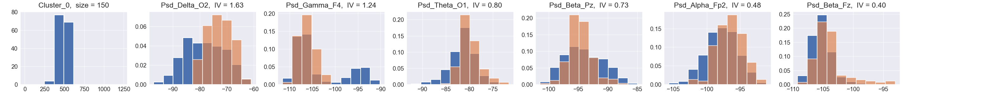

<IPython.core.display.Javascript object>


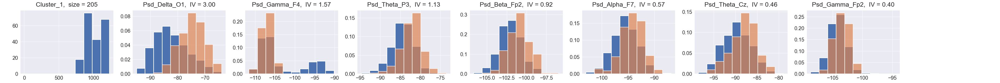

<IPython.core.display.Javascript object>


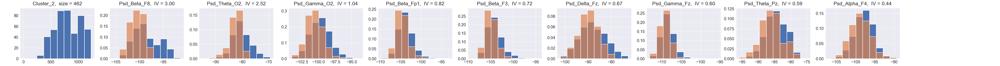

<IPython.core.display.Javascript object>


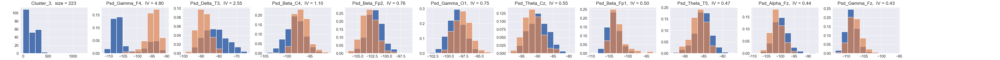

<IPython.core.display.Javascript object>


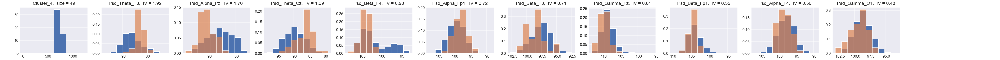

<IPython.core.display.Javascript object>


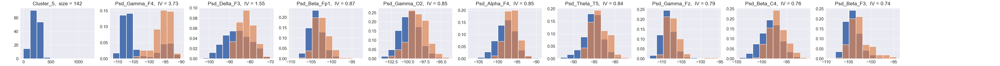

(<Figure size 3000x200 with 10 Axes>,
 array([<AxesSubplot:title={'center':'Cluster_5,  size = 142'}>,
        <AxesSubplot:title={'center':'Psd_Gamma_F4,  IV = 3.73'}>,
        <AxesSubplot:title={'center':'Psd_Delta_F3,  IV = 1.55'}>,
        <AxesSubplot:title={'center':'Psd_Beta_Fp1,  IV = 0.87'}>,
        <AxesSubplot:title={'center':'Psd_Gamma_O2,  IV = 0.85'}>,
        <AxesSubplot:title={'center':'Psd_Alpha_F4,  IV = 0.85'}>,
        <AxesSubplot:title={'center':'Psd_Theta_T5,  IV = 0.84'}>,
        <AxesSubplot:title={'center':'Psd_Gamma_Fz,  IV = 0.79'}>,
        <AxesSubplot:title={'center':'Psd_Beta_C4,  IV = 0.76'}>,
        <AxesSubplot:title={'center':'Psd_Beta_F3,  IV = 0.74'}>],
       dtype=object))

In [287]:
# Plotting best features for given clustering
N_BEST_FEATURES = 10
cluster_labels = aggl_clusters.labels_
n_clusters = len(np.unique(cluster_labels))

# IV_list, WoE_list = IV_WoE_vars_clust(df_psd_features, aggl_clusters.labels_) 
best_IV_list, best_WoE_list = best_IV_WoE_vars_clust(df_psd_features, cluster_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)

for i in range(len(best_IV_list)):
    display(best_IV_list[i])
    
#for i in range(len(best_WoE_list)):
    #display(best_WoE_list[i])

plot_hist_best_vars(df_psd_features, cluster_labels, best_IV_list)    
        

,Variable,IV
0,Psd_Gamma_F4,3.793702
1,Psd_Delta_F3,1.369785
2,Psd_Gamma_O2,0.879129
3,Psd_Beta_Fp1,0.645754
4,Psd_Beta_F3,0.617774
5,Psd_Alpha_F4,0.516360
6,Psd_Gamma_Fz,0.496286
7,Psd_Beta_C4,0.462667


,Variable,IV
0,Psd_Gamma_F4,3.431750
1,Psd_Beta_T5,0.857625
2,Psd_Theta_Fp2,0.786679
3,Psd_Gamma_Fz,0.712132
4,Psd_Beta_Cz,0.637939
5,Psd_Gamma_O2,0.629040
6,Psd_Beta_Fp1,0.627273
7,Psd_Alpha_F4,0.593303
8,Psd_Beta_F7,0.512264
9,Psd_Alpha_F3,0.426124


,Variable,IV
0,Psd_Delta_T4,3.307646
1,Psd_Beta_F4,1.208919
2,Psd_Theta_Cz,1.144058
3,Psd_Theta_P3,1.067807
4,Psd_Theta_Fp1,0.915441
5,Psd_Beta_Fp2,0.581515
6,Psd_Alpha_F3,0.566325


,Variable,IV
0,Psd_Gamma_F4,3.952826
1,Psd_Delta_O2,2.191816
2,Psd_Theta_Fz,2.168095
3,Psd_Alpha_Fp2,1.041142
4,Psd_Theta_T6,0.787765
5,Psd_Theta_Cz,0.777334
6,Psd_Beta_C4,0.740021
7,Psd_Alpha_F7,0.738686
8,Psd_Beta_Fp1,0.416646


,Variable,IV
0,Psd_Delta_T4,2.694580
1,Psd_Theta_P3,1.736234
2,Psd_Theta_Fp1,1.726428
3,Psd_Gamma_F4,1.152179
4,Psd_Beta_Fp2,1.014392
5,Psd_Beta_Fz,0.830794
6,Psd_Theta_Cz,0.760625
7,Psd_Alpha_F7,0.643821
8,Psd_Beta_F3,0.626946
9,Psd_Gamma_Fz,0.591486


,Variable,IV
0,Psd_Delta_P4,2.284411
1,Psd_Gamma_F4,1.290413
2,Psd_Alpha_F3,0.895407
3,Psd_Alpha_F7,0.597708
4,Psd_Alpha_Pz,0.567161
5,Psd_Alpha_Fp2,0.557614
6,Psd_Alpha_F4,0.445781
7,Psd_Theta_T6,0.417737
8,Psd_Beta_Fp1,0.408095


<IPython.core.display.Javascript object>


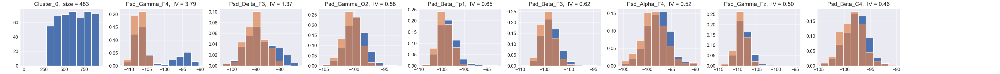

<IPython.core.display.Javascript object>


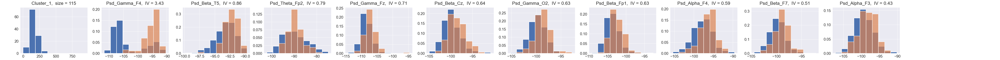

<IPython.core.display.Javascript object>


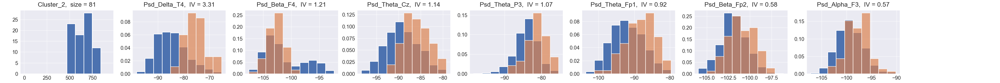

<IPython.core.display.Javascript object>


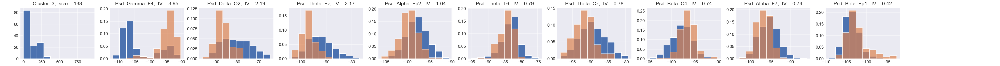

<IPython.core.display.Javascript object>


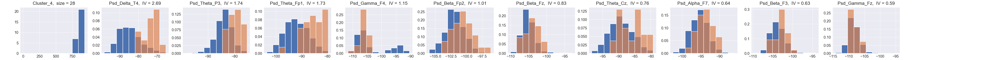

<IPython.core.display.Javascript object>


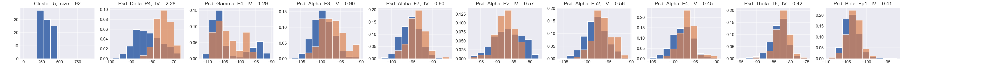

(<Figure size 3000x200 with 10 Axes>,
 array([<AxesSubplot:title={'center':'Cluster_5,  size = 92'}>,
        <AxesSubplot:title={'center':'Psd_Delta_P4,  IV = 2.28'}>,
        <AxesSubplot:title={'center':'Psd_Gamma_F4,  IV = 1.29'}>,
        <AxesSubplot:title={'center':'Psd_Alpha_F3,  IV = 0.90'}>,
        <AxesSubplot:title={'center':'Psd_Alpha_F7,  IV = 0.60'}>,
        <AxesSubplot:title={'center':'Psd_Alpha_Pz,  IV = 0.57'}>,
        <AxesSubplot:title={'center':'Psd_Alpha_Fp2,  IV = 0.56'}>,
        <AxesSubplot:title={'center':'Psd_Alpha_F4,  IV = 0.45'}>,
        <AxesSubplot:title={'center':'Psd_Theta_T6,  IV = 0.42'}>,
        <AxesSubplot:title={'center':'Psd_Beta_Fp1,  IV = 0.41'}>],
       dtype=object))

In [463]:
# Plotting best features for given clustering
N_BEST_FEATURES = 10
cluster_labels = aggl_clusters.labels_
n_clusters = len(np.unique(cluster_labels))

# IV_list, WoE_list = IV_WoE_vars_clust(df_psd_features, aggl_clusters.labels_) 
best_IV_list, best_WoE_list = best_IV_WoE_vars_clust(df_psd_features, cluster_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)

for i in range(len(best_IV_list)):
    display(best_IV_list[i])
    
#for i in range(len(best_WoE_list)):
    #display(best_WoE_list[i])

plot_hist_best_vars(df_psd_features, cluster_labels, best_IV_list)    
        

In [288]:
cluster_labels = aggl_clusters.labels_
n_clusters = len(np.unique(cluster_labels))

best_corr_list = []

for i in range(n_clusters):
    best_vars_list = best_IV_list[i]['Variable'].to_numpy()
    df_best_vars_corr = df_psd_features[best_vars_list].corr()            
    best_corr_list.append(df_best_vars_corr)
    
for i in range(n_clusters):
    display_corr_matrix(best_corr_list[i], corr_middle=0.3, corr_high=0.4)
    #display(best_corr_list[i])

,Psd_Delta_O2,Psd_Gamma_F4,Psd_Theta_O1,Psd_Beta_Pz,Psd_Alpha_Fp2,Psd_Beta_Fz
Psd_Delta_O2,1.00,-0.15,0.46,0.00,0.41,0.23
Psd_Gamma_F4,-0.15,1.00,-0.03,0.34,-0.06,0.07
Psd_Theta_O1,0.46,-0.03,1.00,0.45,0.40,0.22
Psd_Beta_Pz,0.00,0.34,0.45,1.00,0.02,0.10
Psd_Alpha_Fp2,0.41,-0.06,0.40,0.02,1.00,0.28
Psd_Beta_Fz,0.23,0.07,0.22,0.10,0.28,1.00


,Psd_Delta_O1,Psd_Gamma_F4,Psd_Theta_P3,Psd_Beta_Fp2,Psd_Alpha_F7,Psd_Theta_Cz,Psd_Gamma_Fp2
Psd_Delta_O1,1.00,-0.38,0.43,0.37,0.32,0.45,0.11
Psd_Gamma_F4,-0.38,1.00,0.02,-0.18,-0.15,-0.11,0.21
Psd_Theta_P3,0.43,0.02,1.00,0.19,0.39,0.40,0.06
Psd_Beta_Fp2,0.37,-0.18,0.19,1.00,0.33,0.30,0.38
Psd_Alpha_F7,0.32,-0.15,0.39,0.33,1.00,0.16,-0.00
Psd_Theta_Cz,0.45,-0.11,0.40,0.30,0.16,1.00,0.13
Psd_Gamma_Fp2,0.11,0.21,0.06,0.38,-0.00,0.13,1.00


,Psd_Beta_F8,Psd_Theta_O2,Psd_Gamma_O2,Psd_Beta_Fp1,Psd_Beta_F3,Psd_Delta_Fz,Psd_Gamma_Fz,Psd_Theta_Pz,Psd_Alpha_F4
Psd_Beta_F8,1.00,0.26,0.46,0.49,0.28,-0.10,0.41,0.37,0.38
Psd_Theta_O2,0.26,1.00,0.38,0.20,0.38,0.45,0.12,0.44,0.35
Psd_Gamma_O2,0.46,0.38,1.00,0.32,0.28,0.04,0.39,0.23,0.18
Psd_Beta_Fp1,0.49,0.20,0.32,1.00,0.40,0.03,0.40,0.15,0.23
Psd_Beta_F3,0.28,0.38,0.28,0.40,1.00,0.23,0.25,0.21,0.27
Psd_Delta_Fz,-0.10,0.45,0.04,0.03,0.23,1.00,0.09,0.16,0.14
Psd_Gamma_Fz,0.41,0.12,0.39,0.40,0.25,0.09,1.00,0.13,0.14
Psd_Theta_Pz,0.37,0.44,0.23,0.15,0.21,0.16,0.13,1.00,0.36
Psd_Alpha_F4,0.38,0.35,0.18,0.23,0.27,0.14,0.14,0.36,1.00


,Psd_Gamma_F4,Psd_Delta_T3,Psd_Beta_C4,Psd_Beta_Fp2,Psd_Gamma_O1,Psd_Theta_Cz,Psd_Beta_Fp1,Psd_Theta_T5,Psd_Alpha_Fz,Psd_Gamma_Fz
Psd_Gamma_F4,1.00,-0.37,0.42,-0.18,0.45,-0.11,0.45,-0.06,-0.11,0.45
Psd_Delta_T3,-0.37,1.00,-0.11,0.42,-0.04,0.45,0.01,0.39,0.26,-0.04
Psd_Beta_C4,0.42,-0.11,1.00,0.09,0.25,0.13,0.37,0.29,0.05,0.26
Psd_Beta_Fp2,-0.18,0.42,0.09,1.00,0.04,0.30,0.25,0.33,0.31,0.14
Psd_Gamma_O1,0.45,-0.04,0.25,0.04,1.00,0.05,0.29,0.01,-0.04,0.36
Psd_Theta_Cz,-0.11,0.45,0.13,0.30,0.05,1.00,0.08,0.47,0.30,0.02
Psd_Beta_Fp1,0.45,0.01,0.37,0.25,0.29,0.08,1.00,0.14,0.20,0.40
Psd_Theta_T5,-0.06,0.39,0.29,0.33,0.01,0.47,0.14,1.00,0.36,0.04
Psd_Alpha_Fz,-0.11,0.26,0.05,0.31,-0.04,0.30,0.20,0.36,1.00,0.21
Psd_Gamma_Fz,0.45,-0.04,0.26,0.14,0.36,0.02,0.40,0.04,0.21,1.00


,Psd_Theta_T3,Psd_Alpha_Pz,Psd_Theta_Cz,Psd_Beta_F4,Psd_Alpha_Fp1,Psd_Beta_T3,Psd_Gamma_Fz,Psd_Beta_Fp1,Psd_Alpha_F4,Psd_Gamma_O1
Psd_Theta_T3,1.00,-0.06,0.48,-0.26,0.34,0.47,-0.06,0.03,0.18,-0.03
Psd_Alpha_Pz,-0.06,1.00,0.08,0.40,-0.14,0.49,0.16,0.18,0.34,0.17
Psd_Theta_Cz,0.48,0.08,1.00,-0.04,0.32,0.17,0.02,0.08,0.22,0.05
Psd_Beta_F4,-0.26,0.40,-0.04,1.00,-0.01,0.16,0.42,0.49,0.40,0.43
Psd_Alpha_Fp1,0.34,-0.14,0.32,-0.01,1.00,0.19,0.02,0.38,0.26,-0.01
Psd_Beta_T3,0.47,0.49,0.17,0.16,0.19,1.00,0.12,0.29,0.32,0.14
Psd_Gamma_Fz,-0.06,0.16,0.02,0.42,0.02,0.12,1.00,0.40,0.14,0.36
Psd_Beta_Fp1,0.03,0.18,0.08,0.49,0.38,0.29,0.40,1.00,0.23,0.29
Psd_Alpha_F4,0.18,0.34,0.22,0.40,0.26,0.32,0.14,0.23,1.00,0.13
Psd_Gamma_O1,-0.03,0.17,0.05,0.43,-0.01,0.14,0.36,0.29,0.13,1.00


,Psd_Gamma_F4,Psd_Delta_F3,Psd_Beta_Fp1,Psd_Gamma_O2,Psd_Alpha_F4,Psd_Theta_T5,Psd_Gamma_Fz,Psd_Beta_C4,Psd_Beta_F3
Psd_Gamma_F4,1.00,-0.15,0.45,0.43,0.22,-0.06,0.45,0.42,0.18
Psd_Delta_F3,-0.15,1.00,0.13,0.20,0.15,0.38,0.08,0.02,0.43
Psd_Beta_Fp1,0.45,0.13,1.00,0.32,0.23,0.14,0.40,0.37,0.40
Psd_Gamma_O2,0.43,0.20,0.32,1.00,0.18,0.16,0.39,0.29,0.28
Psd_Alpha_F4,0.22,0.15,0.23,0.18,1.00,0.43,0.14,0.44,0.27
Psd_Theta_T5,-0.06,0.38,0.14,0.16,0.43,1.00,0.04,0.29,0.20
Psd_Gamma_Fz,0.45,0.08,0.40,0.39,0.14,0.04,1.00,0.26,0.25
Psd_Beta_C4,0.42,0.02,0.37,0.29,0.44,0.29,0.26,1.00,0.29
Psd_Beta_F3,0.18,0.43,0.40,0.28,0.27,0.20,0.25,0.29,1.00


In [289]:
n_features_FA_ward = len(np.transpose(psd_spectr_FA_ward))

print(len(df_psd_FA_ward.columns))
target_names = df_psd_FA_ward.columns.values[n_features_FA_ward:]
df_psd_FA_ward=df_psd_FA_ward.drop(columns=target_names)
print(len(df_psd_FA_ward.columns))
   

30
30


,Variable,IV
0,Psd_Delta_FA_3,1.624453
1,Psd_Gamma_FA_2,1.259410
2,Psd_Alpha_FA_0,0.735296
3,Psd_Alpha_FA_1,0.568443
4,Psd_Alpha_FA_5,0.460294


,Variable,IV
0,Psd_Delta_FA_1,3.001466
1,Psd_Gamma_FA_2,1.447485
2,Psd_Theta_FA_1,1.287762
3,Psd_Alpha_FA_5,0.569115
4,Psd_Beta_FA_0,0.510730


,Variable,IV
0,Psd_Gamma_FA_2,2.553250
1,Psd_Theta_FA_3,2.394489
2,Psd_Beta_FA_2,1.006834
3,Psd_Gamma_FA_5,0.604346


,Variable,IV
0,Psd_Gamma_FA_2,4.858075
1,Psd_Delta_FA_1,2.553806
2,Psd_Gamma_FA_5,0.429056
3,Psd_Alpha_FA_0,0.417874


,Variable,IV
0,Psd_Delta_FA_1,1.942594
1,Psd_Alpha_FA_1,1.423099
2,Psd_Beta_FA_5,0.926824
3,Psd_Gamma_FA_5,0.606215
4,Psd_Beta_FA_2,0.435848


,Variable,IV
0,Psd_Gamma_FA_2,3.779436
1,Psd_Theta_FA_2,1.438728
2,Psd_Beta_FA_2,1.036506
3,Psd_Gamma_FA_5,0.791635
4,Psd_Beta_FA_1,0.580295


<IPython.core.display.Javascript object>


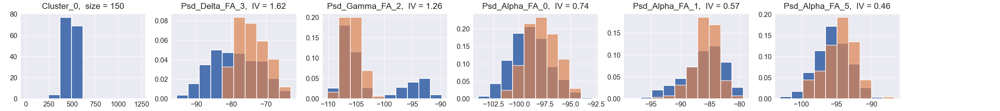

<IPython.core.display.Javascript object>


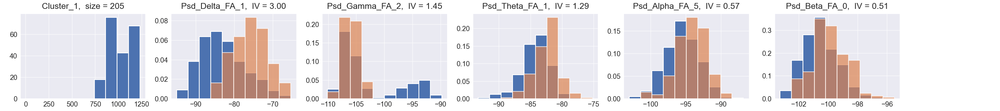

<IPython.core.display.Javascript object>


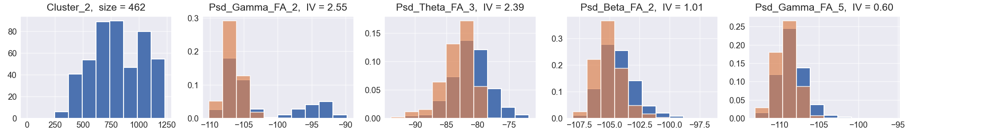

<IPython.core.display.Javascript object>


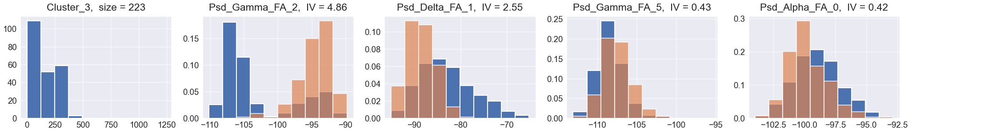

<IPython.core.display.Javascript object>


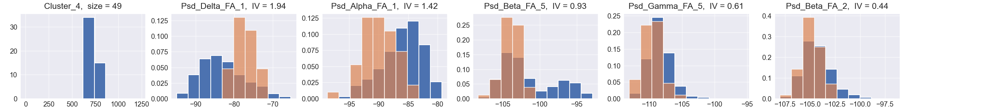

<IPython.core.display.Javascript object>


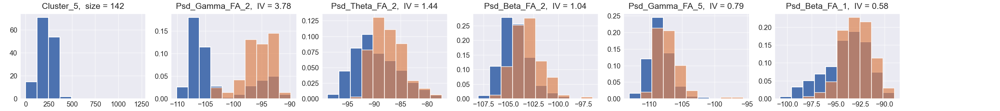

(<Figure size 1800x200 with 6 Axes>,
 array([<AxesSubplot:title={'center':'Cluster_5,  size = 142'}>,
        <AxesSubplot:title={'center':'Psd_Gamma_FA_2,  IV = 3.78'}>,
        <AxesSubplot:title={'center':'Psd_Theta_FA_2,  IV = 1.44'}>,
        <AxesSubplot:title={'center':'Psd_Beta_FA_2,  IV = 1.04'}>,
        <AxesSubplot:title={'center':'Psd_Gamma_FA_5,  IV = 0.79'}>,
        <AxesSubplot:title={'center':'Psd_Beta_FA_1,  IV = 0.58'}>],
       dtype=object))

In [290]:
# DataFrame with 30 PSD FA_ward components
# IV & WoE calculation

N_BEST_FEATURES = 10
cluster_labels = aggl_clusters.labels_
n_clusters = len(np.unique(cluster_labels))

best_IV_list, best_WoE_list = best_IV_WoE_vars_clust(df_psd_FA_ward, cluster_labels, n_best_vars=N_BEST_FEATURES, 
                                                     corr_threshold=0.5, IV_threshold=0.4)
for i in range(len(best_IV_list)):
    display(best_IV_list[i])
    
# Plotting best features for given clustering
plot_hist_best_vars(df_psd_FA_ward, cluster_labels, best_IV_list)    
        

In [285]:
# Display correlation matrix of best features for each cluster
best_corr_list = []

for i in range(n_clusters):
    best_vars_list = best_IV_list[i]['Variable'].to_numpy()
    df_best_vars_corr = df_psd_FA_ward[best_vars_list].corr()            
    best_corr_list.append(df_best_vars_corr)
    
for i in range(n_clusters):
    display_corr_matrix(best_corr_list[i], corr_middle=0.3, corr_high=0.4)
    #display(best_corr_list[i])

,Psd_Delta_FA_3,Psd_Gamma_FA_2,Psd_Alpha_FA_0,Psd_Alpha_FA_1,Psd_Alpha_FA_5
Psd_Delta_FA_3,1.00,-0.15,0.41,0.04,0.35
Psd_Gamma_FA_2,-0.15,1.00,-0.00,0.24,-0.15
Psd_Alpha_FA_0,0.41,-0.00,1.00,0.21,0.44
Psd_Alpha_FA_1,0.04,0.24,0.21,1.00,0.35
Psd_Alpha_FA_5,0.35,-0.15,0.44,0.35,1.00


,Psd_Delta_FA_1,Psd_Gamma_FA_2,Psd_Theta_FA_1,Psd_Alpha_FA_5,Psd_Beta_FA_0
Psd_Delta_FA_1,1.00,-0.35,0.46,0.34,0.20
Psd_Gamma_FA_2,-0.35,1.00,0.04,-0.15,0.21
Psd_Theta_FA_1,0.46,0.04,1.00,0.44,0.48
Psd_Alpha_FA_5,0.34,-0.15,0.44,1.00,0.35
Psd_Beta_FA_0,0.20,0.21,0.48,0.35,1.00


,Psd_Gamma_FA_2,Psd_Theta_FA_3,Psd_Beta_FA_2,Psd_Gamma_FA_5
Psd_Gamma_FA_2,1.00,0.01,0.30,0.45
Psd_Theta_FA_3,0.01,1.00,0.37,0.12
Psd_Beta_FA_2,0.30,0.37,1.00,0.49
Psd_Gamma_FA_5,0.45,0.12,0.49,1.00


,Psd_Gamma_FA_2,Psd_Delta_FA_1,Psd_Gamma_FA_5,Psd_Alpha_FA_0
Psd_Gamma_FA_2,1.00,-0.35,0.45,-0.00
Psd_Delta_FA_1,-0.35,1.00,-0.03,0.38
Psd_Gamma_FA_5,0.45,-0.03,1.00,0.16
Psd_Alpha_FA_0,-0.00,0.38,0.16,1.00


,Psd_Delta_FA_1,Psd_Alpha_FA_1,Psd_Beta_FA_5,Psd_Gamma_FA_5,Psd_Beta_FA_2
Psd_Delta_FA_1,1.00,-0.07,-0.28,-0.03,0.20
Psd_Alpha_FA_1,-0.07,1.00,0.32,0.13,0.23
Psd_Beta_FA_5,-0.28,0.32,1.00,0.42,0.41
Psd_Gamma_FA_5,-0.03,0.13,0.42,1.00,0.49
Psd_Beta_FA_2,0.20,0.23,0.41,0.49,1.00


,Psd_Gamma_FA_2,Psd_Theta_FA_2,Psd_Beta_FA_2,Psd_Gamma_FA_5,Psd_Beta_FA_1
Psd_Gamma_FA_2,1.00,-0.22,0.30,0.45,0.23
Psd_Theta_FA_2,-0.22,1.00,0.35,0.05,0.12
Psd_Beta_FA_2,0.30,0.35,1.00,0.49,0.30
Psd_Gamma_FA_5,0.45,0.05,0.49,1.00,0.16
Psd_Beta_FA_1,0.23,0.12,0.30,0.16,1.00


In [151]:
# Feature Agglomeration (Eulidean, Ward, PSD features)
n_FA_comp = 6

FA_transformer = cluster.FeatureAgglomeration(n_clusters=n_FA_comp)#, distance_threshold=200)

psd_delta_FA = FA_transformer.fit_transform(psd_features[:, 0:19])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_theta_FA = FA_transformer.fit_transform(psd_features[:, 19:19*2])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_alpha_FA = FA_transformer.fit_transform(psd_features[:, 19*2:19*3])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))
    
psd_beta_FA = FA_transformer.fit_transform(psd_features[:, 19*3:19*4])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_gamma_FA = FA_transformer.fit_transform(psd_features[:, 19*4:19*5])
print(FA_transformer.labels_)
for i, label in enumerate(set(FA_transformer.labels_)):
    features_with_label = [data.ch_names[j] for j, lab in enumerate(FA_transformer.labels_) if lab == label]
    print('Features in cluster {}: {}'.format(i, features_with_label))

psd_spectr_FA_ward = np.concatenate((psd_delta_FA, psd_theta_FA, psd_alpha_FA, psd_beta_FA, psd_gamma_FA), axis=1)   
print(psd_spectr_FA_ward.shape)                                             

[0 0 5 5 4 4 1 1 2 2 2 1 2 2 2 3 2 1 3]
Features in cluster 0: ['Fp1', 'Fp2']
Features in cluster 1: ['F8', 'T3', 'T4', 'O1']
Features in cluster 2: ['C3', 'Cz', 'C4', 'T5', 'P3', 'Pz', 'T6']
Features in cluster 3: ['P4', 'O2']
Features in cluster 4: ['Fz', 'F4']
Features in cluster 5: ['F7', 'F3']
[0 2 2 0 0 0 5 5 4 4 4 1 1 1 1 3 1 3 3]
Features in cluster 0: ['Fp1', 'F3', 'Fz', 'F4']
Features in cluster 1: ['T4', 'T5', 'P3', 'Pz', 'T6']
Features in cluster 2: ['Fp2', 'F7']
Features in cluster 3: ['P4', 'O1', 'O2']
Features in cluster 4: ['C3', 'Cz', 'C4']
Features in cluster 5: ['F8', 'T3']
[0 0 5 0 0 0 3 3 2 2 3 4 1 1 1 4 4 4 4]
Features in cluster 0: ['Fp1', 'Fp2', 'F3', 'Fz', 'F4']
Features in cluster 1: ['T5', 'P3', 'Pz']
Features in cluster 2: ['C3', 'Cz']
Features in cluster 3: ['F8', 'T3', 'C4']
Features in cluster 4: ['T4', 'P4', 'T6', 'O1', 'O2']
Features in cluster 5: ['F7']
[2 0 0 2 2 5 3 3 0 0 3 1 1 1 1 1 1 4 4]
Features in cluster 0: ['Fp2', 'F7', 'C3', 'Cz']
Features in

In [512]:
df_best_vars_WoE_list = []

for i in range(aggl_clusters.n_clusters):
    df_WoE_temp = WoE_df_list[i].drop(['% of Events', 'Non-Events', '% of Non-Events'], axis=1)
    df_best_vars_WoE = pd.DataFrame(columns=df_WoE_temp.columns)
    for j in range(N_VARS_IV):
        temp_var = df_best_vars_list[i].at[j, 'Variable']
        df_best_vars_WoE = df_best_vars_WoE.append(df_WoE_temp.loc[WoE_df_list[0]['Variable']==temp_var], ignore_index=True)
    
    s = df_best_vars_WoE
    s = s.style.format(formatter={'WoE':'{:.2f}', 'IV':'{:.2f}'})
    s = s.set_caption("Woe values for Cluster "+str(i))
    display(s)   
    
    df_best_vars_WoE_list.append(df_best_vars_WoE)
   

,Variable,Cutoff,N,Events,WoE,IV
0,Psd_Delta_FA_3,"(-95.715, -87.984]",124,0,-3.54,0.39
1,Psd_Delta_FA_3,"(-87.984, -85.513]",123,0,-3.53,0.39
2,Psd_Delta_FA_3,"(-85.513, -83.578]",123,0,-3.53,0.39
3,Psd_Delta_FA_3,"(-83.578, -81.26]",123,4,-1.42,0.12
4,Psd_Delta_FA_3,"(-81.26, -79.261]",123,12,-0.25,0.01
5,Psd_Delta_FA_3,"(-79.261, -77.211]",123,23,0.51,0.03
6,Psd_Delta_FA_3,"(-77.211, -74.904]",123,28,0.75,0.07
7,Psd_Delta_FA_3,"(-74.904, -72.233]",123,32,0.93,0.12
8,Psd_Delta_FA_3,"(-72.233, -69.744]",123,25,0.61,0.05
9,Psd_Delta_FA_3,"(-69.744, -62.985]",123,26,0.66,0.06


,Variable,Cutoff,N,Events,WoE,IV
0,Psd_Delta_FA_1,"(-95.063, -89.981]",124,0,-3.90,0.46
1,Psd_Delta_FA_1,"(-89.981, -88.268]",123,0,-3.89,0.46
2,Psd_Delta_FA_1,"(-88.268, -86.579]",123,0,-3.89,0.46
3,Psd_Delta_FA_1,"(-86.579, -85.2]",123,2,-2.49,0.27
4,Psd_Delta_FA_1,"(-85.2, -83.752]",123,7,-1.20,0.09
5,Psd_Delta_FA_1,"(-83.752, -82.181]",123,6,-1.36,0.12
6,Psd_Delta_FA_1,"(-82.181, -80.338]",123,20,-0.03,0.00
7,Psd_Delta_FA_1,"(-80.338, -78.034]",123,33,0.61,0.04
8,Psd_Delta_FA_1,"(-78.034, -74.438]",123,56,1.43,0.30
9,Psd_Delta_FA_1,"(-74.438, -65.291]",123,81,2.27,0.80


,Variable,Cutoff,N,Events,WoE,IV
0,Psd_Gamma_FA_2,"(-110.165, -107.69]",124,93,1.61,0.26
1,Psd_Gamma_FA_2,"(-107.69, -107.096]",123,72,0.85,0.08
2,Psd_Gamma_FA_2,"(-107.096, -106.572]",123,78,1.06,0.12
3,Psd_Gamma_FA_2,"(-106.572, -106.164]",123,65,0.62,0.04
4,Psd_Gamma_FA_2,"(-106.164, -105.606]",123,59,0.43,0.02
5,Psd_Gamma_FA_2,"(-105.606, -104.818]",123,57,0.36,0.01
6,Psd_Gamma_FA_2,"(-104.818, -102.762]",123,34,-0.45,0.02
7,Psd_Gamma_FA_2,"(-102.762, -95.725]",123,4,-2.88,0.42
8,Psd_Gamma_FA_2,"(-95.725, -93.581]",123,0,-5.00,0.79
9,Psd_Gamma_FA_2,"(-93.581, -89.844]",123,0,-5.00,0.79


,Variable,Cutoff,N,Events,WoE,IV
0,Psd_Gamma_FA_2,"(-110.165, -107.69]",124,0,-4.00,0.48
1,Psd_Gamma_FA_2,"(-107.69, -107.096]",123,0,-4.00,0.48
2,Psd_Gamma_FA_2,"(-107.096, -106.572]",123,0,-4.00,0.48
3,Psd_Gamma_FA_2,"(-106.572, -106.164]",123,0,-4.00,0.48
4,Psd_Gamma_FA_2,"(-106.164, -105.606]",123,0,-4.00,0.48
5,Psd_Gamma_FA_2,"(-105.606, -104.818]",123,0,-4.00,0.48
6,Psd_Gamma_FA_2,"(-104.818, -102.762]",123,3,-2.18,0.23
7,Psd_Gamma_FA_2,"(-102.762, -95.725]",123,51,1.16,0.18
8,Psd_Gamma_FA_2,"(-95.725, -93.581]",123,82,2.20,0.72
9,Psd_Gamma_FA_2,"(-93.581, -89.844]",123,87,2.39,0.85


,Variable,Cutoff,N,Events,WoE,IV
0,Psd_Delta_FA_1,"(-95.063, -89.981]",124,0,-2.33,0.22
1,Psd_Delta_FA_1,"(-89.981, -88.268]",123,0,-2.32,0.22
2,Psd_Delta_FA_1,"(-88.268, -86.579]",123,0,-2.32,0.22
3,Psd_Delta_FA_1,"(-86.579, -85.2]",123,0,-2.32,0.22
4,Psd_Delta_FA_1,"(-85.2, -83.752]",123,0,-2.32,0.22
5,Psd_Delta_FA_1,"(-83.752, -82.181]",123,2,-0.92,0.06
6,Psd_Delta_FA_1,"(-82.181, -80.338]",123,4,-0.21,0.00
7,Psd_Delta_FA_1,"(-80.338, -78.034]",123,15,1.21,0.26
8,Psd_Delta_FA_1,"(-78.034, -74.438]",123,20,1.54,0.50
9,Psd_Delta_FA_1,"(-74.438, -65.291]",123,8,0.52,0.03


,Variable,Cutoff,N,Events,WoE,IV
0,Psd_Gamma_FA_2,"(-110.165, -107.69]",124,0,-3.48,0.38
1,Psd_Gamma_FA_2,"(-107.69, -107.096]",123,0,-3.47,0.38
2,Psd_Gamma_FA_2,"(-107.096, -106.572]",123,0,-3.47,0.38
3,Psd_Gamma_FA_2,"(-106.572, -106.164]",123,0,-3.47,0.38
4,Psd_Gamma_FA_2,"(-106.164, -105.606]",123,0,-3.47,0.38
5,Psd_Gamma_FA_2,"(-105.606, -104.818]",123,0,-3.47,0.38
6,Psd_Gamma_FA_2,"(-104.818, -102.762]",123,2,-2.07,0.20
7,Psd_Gamma_FA_2,"(-102.762, -95.725]",123,63,2.09,0.81
8,Psd_Gamma_FA_2,"(-95.725, -93.581]",123,41,1.34,0.29
9,Psd_Gamma_FA_2,"(-93.581, -89.844]",123,36,1.15,0.20


In [161]:
pd.set_option("display.max_rows", None, "display.max_columns", None)

for i in range(len(IV_df_list)):
    print('Cluster_'+str(i)+':')
#    IV_df_list[i]
IV_df = IV_df_list[3].sort_values('IV', ascending = False)
IV_df[IV_df['IV'] >= 0.4]


Cluster_0:
Cluster_1:
Cluster_2:
Cluster_3:


,Variable,IV
0,Psd_Gamma_FA_2,4.858075
0,Psd_Beta_FA_5,4.450316
0,Target_Cluster_0,3.094451
0,Psd_Gamma_FA_1,2.799484
0,Psd_Delta_FA_1,2.553806
0,Psd_Gamma_FA_0,2.512560
0,Psd_Theta_FA_2,2.382648
0,Psd_Beta_FA_3,2.360034
0,Psd_Theta_FA_0,2.269767
0,Psd_Gamma_FA_4,2.254939


# TDA features

## Persistent Homology

In [351]:
channel_names = data.ch_names
print(channel_names)

# Get ecg epochs time series data
ts_epochs_ecg = epochs_ecg.get_data()

n_samples = ts_epochs_ecg.shape[0]
n_channels = ts_epochs_ecg.shape[1]
n_times = ts_epochs_ecg.shape[2]
print(n_samples, n_channels, n_times)

# Filtering time series data in Delta range (0-4 Hz)
epochs_ecg_delta = epochs_ecg.copy().filter(l_freq=0.1, h_freq=4)
ts_epochs_ecg_delta = epochs_ecg_delta.get_data()

# Filtering time series data in Theta range (4-8 Hz)
epochs_ecg_theta = epochs_ecg.copy().filter(l_freq=4, h_freq=8)
ts_epochs_ecg_theta = epochs_ecg_theta.get_data()

# Filtering time series data in Alpha range (8-12 Hz)
epochs_ecg_alpha = epochs_ecg.copy().filter(l_freq=8, h_freq=12)
ts_epochs_ecg_alpha = epochs_ecg_alpha.get_data()

# Filtering time series data in Beta 1 range (12-16 Hz)
epochs_ecg_beta1 = epochs_ecg.copy().filter(l_freq=12, h_freq=16)
ts_epochs_ecg_beta1 = epochs_ecg_beta1.get_data()

# Filtering time series data in Beta 2 range (16-20 Hz)
epochs_ecg_beta2 = epochs_ecg.copy().filter(l_freq=16, h_freq=20)
ts_epochs_ecg_beta2 = epochs_ecg_beta2.get_data()

# Filtering time series data in Beta 3 range (20-25 Hz)
epochs_ecg_beta3 = epochs_ecg.copy().filter(l_freq=20, h_freq=25)
ts_epochs_ecg_beta3 = epochs_ecg_beta3.get_data()

# Filtering time series data in Beta 4 range (25-30 Hz)
epochs_ecg_beta4 = epochs_ecg.copy().filter(l_freq=25, h_freq=30)
ts_epochs_ecg_beta4 = epochs_ecg_beta4.get_data()

# Filtering time series data in Gamma 1 range (30-35 Hz)
epochs_ecg_gamma1 = epochs_ecg.copy().filter(l_freq=30, h_freq=35)
ts_epochs_ecg_gamma1 = epochs_ecg_gamma1.get_data()

# Filtering time series data in Gamma 2 range (35-40 Hz)
epochs_ecg_gamma2 = epochs_ecg.copy().filter(l_freq=35, h_freq=40)
ts_epochs_ecg_gamma2 = epochs_ecg_gamma2.get_data()

# Filtering time series data in Gamma 3 range (40-45 Hz)
epochs_ecg_gamma3 = epochs_ecg.copy().filter(l_freq=40, h_freq=45)
ts_epochs_ecg_gamma3 = epochs_ecg_gamma3.get_data()


['Fp1', 'Fp2', 'F7', 'F3', 'Fz', 'F4', 'F8', 'T3', 'C3', 'Cz', 'C4', 'T4', 'T5', 'P3', 'Pz', 'P4', 'T6', 'O1', 'O2']
1231 19 451
Setting up band-pass filter from 0.1 - 4 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 0.10
- Lower transition bandwidth: 0.10 Hz (-6 dB cutoff frequency: 0.05 Hz)
- Upper passband edge: 4.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 5.00 Hz)
- Filter length: 16501 samples (33.002 sec)



<ipython-input-351-01b89f9ae8b0>:13: RuntimeWarning:

filter_length (16501) is longer than the signal (451), distortion is likely. Reduce filter length or filter a longer signal.



Setting up band-pass filter from 4 - 8 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 4.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 3.00 Hz)
- Upper passband edge: 8.00 Hz
- Upper transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 9.00 Hz)
- Filter length: 825 samples (1.650 sec)



<ipython-input-351-01b89f9ae8b0>:17: RuntimeWarning:

filter_length (825) is longer than the signal (451), distortion is likely. Reduce filter length or filter a longer signal.



Setting up band-pass filter from 8 - 12 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 8.00
- Lower transition bandwidth: 2.00 Hz (-6 dB cutoff frequency: 7.00 Hz)
- Upper passband edge: 12.00 Hz
- Upper transition bandwidth: 3.00 Hz (-6 dB cutoff frequency: 13.50 Hz)
- Filter length: 825 samples (1.650 sec)



<ipython-input-351-01b89f9ae8b0>:21: RuntimeWarning:

filter_length (825) is longer than the signal (451), distortion is likely. Reduce filter length or filter a longer signal.



Setting up band-pass filter from 12 - 16 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 12.00
- Lower transition bandwidth: 3.00 Hz (-6 dB cutoff frequency: 10.50 Hz)
- Upper passband edge: 16.00 Hz
- Upper transition bandwidth: 4.00 Hz (-6 dB cutoff frequency: 18.00 Hz)
- Filter length: 551 samples (1.102 sec)



<ipython-input-351-01b89f9ae8b0>:25: RuntimeWarning:

filter_length (551) is longer than the signal (451), distortion is likely. Reduce filter length or filter a longer signal.



Setting up band-pass filter from 16 - 20 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 16.00
- Lower transition bandwidth: 4.00 Hz (-6 dB cutoff frequency: 14.00 Hz)
- Upper passband edge: 20.00 Hz
- Upper transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 22.50 Hz)
- Filter length: 413 samples (0.826 sec)

Setting up band-pass filter from 20 - 25 Hz

FIR filter parameters
---------------------
Designing a one-pass, zero-phase, non-causal bandpass filter:
- Windowed time-domain design (firwin) method
- Hamming window with 0.0194 passband ripple and 53 dB stopband attenuation
- Lower passband edge: 20.00
- Lower transition bandwidth: 5.00 Hz (-6 dB cutoff frequency: 17.50 Hz)
- Upper passband edge: 25.00 Hz
- Upper transition bandwidth: 6.25 Hz (-6 dB cutoff frequency: 28.12 Hz

In [ ]:
# Point cloud in full range
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 12
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg = attractor.fit_transform(ts_epochs_ecg)
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg[:,i,:], sample=100)


In [ ]:
# Point cloud in full range
# Part 2

for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg[:,i,:], sample=100)


In [ ]:
# Point clouds in Delta range (0-4 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 15
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_delta = attractor.fit_transform(ts_epochs_ecg_delta)
print("Point clouds in Delta range (0-4 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_delta[:,i,:], sample=100)

In [ ]:
# Point clouds in Delta range (0-4 Hz)
# Part 2

print("Point clouds in Delta range (0-4 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_delta[:,i,:], sample=100)

In [ ]:
# Point clouds in Theta range (4-8 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 12
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_theta = attractor.fit_transform(ts_epochs_ecg_theta)
print("Point clouds in Theta range (4-8 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_theta[:,i,:], sample=100)

In [ ]:
# Point clouds in Theta range (4-8 Hz)
# Part 2

print("Point clouds in Theta range (4-8 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_theta[:,i,:], sample=100)

In [ ]:
# Point clouds in Alpha range (8-12 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 12
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_alpha = attractor.fit_transform(ts_epochs_ecg_alpha)
print("Point clouds in Alpha range (8-12 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_alpha[:,i,:], sample=100)

In [ ]:
# Point clouds in Alpha range (8-12 Hz)
# Part 2

print("Point clouds in Alpha range (8-12 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_alpha[:,i,:], sample=100)

In [ ]:
# Point clouds in Beta 1 range (12-16 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 8
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_beta1 = attractor.fit_transform(ts_epochs_ecg_beta1)
print("Point clouds in Beta 1 range (12-16 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta1[:,i,:], sample=100)

In [ ]:
# Point clouds in Beta 1 range (12-16 Hz)
# Part 2

print("Point clouds in Beta 1 range (12-16 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta1[:,i,:], sample=100)

In [ ]:
# Point clouds in Beta 2 range (16-20 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 6
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False
#    stride=stride,
)

pcl_epochs_ecg_beta2 = attractor.fit_transform(ts_epochs_ecg_beta2)
print("Point clouds in Beta 2 range (16-20 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta2[:,i,:], sample=100)

In [ ]:
# Point clouds in Beta 2 range (16-20 Hz)
# Part 2

print("Point clouds in Beta 2 range (16-20 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta2[:,i,:], sample=100)

In [ ]:
# Point clouds in Beta 3 range (20-25 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 5
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_beta3 = attractor.fit_transform(ts_epochs_ecg_beta3)
print("Point clouds in Beta 3 range (20-25 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta3[:,i,:], sample=100)

In [ ]:
# Point clouds in Beta 3 range (20-25 Hz)
# Part 2

print("Point clouds in Beta 3 range (20-25 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta3[:,i,:], sample=100)

In [ ]:
# Point clouds in Beta 4 range (25-30 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 5
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_beta4 = attractor.fit_transform(ts_epochs_ecg_beta4)
print("Point clouds in Beta 4 range (25-30 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta4[:,i,:], sample=100)

In [ ]:
# Point clouds in Beta 4 range (25-30 Hz)
# Part 2

print("Point clouds in Beta 4 range (25-30 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_beta4[:,i,:], sample=100)

In [ ]:
# Point clouds in Gamma 1 range (30-35 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 4
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_gamma1 = attractor.fit_transform(ts_epochs_ecg_gamma1)
print("Point clouds in Gamma 1 range (30-35 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_gamma1[:,i,:], sample=100)

In [ ]:
# Point clouds in Gamma 1 range (30-35 Hz)
# Part 2

print("Point clouds in Gamma 1 range (30-35 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_gamma1[:,i,:], sample=100)

In [ ]:
# Point clouds in Gamma 2 range (35-40 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 3
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False,
#    stride=stride,
)

pcl_epochs_ecg_gamma2 = attractor.fit_transform(ts_epochs_ecg_gamma2)
print("Point clouds in Gamma 2 range (35-40 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_gamma2[:,i,:], sample=100)

In [ ]:
# Point clouds in Gamma 2 range (35-40 Hz)
# Part 2

print("Point clouds in Gamma 2 range (35-40 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_gamma2[:,i,:], sample=100)

In [ ]:
# Point clouds in Gamma 3 range (40-45 Hz)
# Part 1

# Build attractor
embedding_dimension = 3
embedding_time_delay = 3
stride = 3 # downsampling

attractor = TakensEmbedding(
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    flatten=False, 
#    stride=stride,
)

pcl_epochs_ecg_gamma3 = attractor.fit_transform(ts_epochs_ecg_gamma3)
print("Point clouds in Gamma 3 range (40-45 Hz)")
for i in range(n_channels//2 + 1):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_gamma3[:,i,:], sample=100)

In [ ]:
# Point clouds in Gamma 3 range (40-45 Hz)
# Part 2

print("Point clouds in Gamma 3 range (40-45 Hz)")
for i in range(n_channels//2 + 1, n_channels):
    print("Channel: ", channel_names[i])
    attractor.fit_transform_plot(ts_epochs_ecg_gamma3[:,i,:], sample=100)

In [427]:
pcl_epochs_ecg_gamma3[:,1,:,:].shape

(1231, 445, 3)

In [428]:
homology_dimensions = [0, 1, 2]

persistence = VietorisRipsPersistence(
    homology_dimensions=homology_dimensions, 
    n_jobs=-1,
)

pd_epochs_ecg_delta_list = []

for i in range(n_channels):  
    pd_epochs_ecg_delta_list.append(persistence.fit_transform(pcl_epochs_ecg_delta[:,i,:,:]))


KeyboardInterrupt: 

In [ ]:
print(m10_all_ch_per_diag[0].shape)
print(m10_all_ch_per_diag[1].shape)
print(m10_all_ch_per_diag[2].shape)

#m10_all_ch_per_diag = np.array(m10_all_ch_per_diag)

print("Persistence diagram for periodic signal")
persistence.fit_transform_plot(m10_all_ch_point_cl[10])

In [ ]:
for i in range(n_channels): 
    m10_all_ch_point_cl.append(attractor.fit_transform(ts_epochs_ecg[i]))
m10_all_ch_point_cl = np.array(m10_all_ch_point_cl)

print(m10_all_ch_point_cl.shape)
for i in range(n_channels):
attractor.fit_transform_plot(m10_all_ch_ts[10])

In [308]:
ts_epochs_ecg[:,0:1].shape

(1231, 1, 451)

In [ ]:
m10_sample_ts = epochs.get_data(picks=0, item=0).reshape(epochs.get_data().shape[2])
time_delay, dimension = takens_embedding_optimal_parameters(m10_sample_ts,10, 10)
print('time_delay = ', time_delay)
print('dimension = ', dimension)

In [ ]:
embedding_dimension = 3
embedding_time_delay = 8
stride = 3

embedder_sample = SingleTakensEmbedding(
    parameters_type="fixed",
#    n_jobs=2,
    time_delay=embedding_time_delay,
    dimension=embedding_dimension,
    stride=stride,
)

In [ ]:
m10_sample_point_cl = embedder_sample.fit_transform(m10_sample_ts)
print(f"Shape of embedded time series: {m10_sample_point_cl.shape}")
plot_point_cloud(m10_sample_point_cl)

In [ ]:
# Change array type for next step
print(m10_sample_point_cl.shape)
m10_sample_point_cl = m10_sample_point_cl[None, :, :]
print(m10_sample_point_cl.shape)


In [ ]:
# Build persistent diagram
homology_dimensions = [0, 1, 2]

persistence = VietorisRipsPersistence(
    homology_dimensions=homology_dimensions, n_jobs=6
)

m10_sample_per_diag = persistence.fit_transform(m10_sample_point_cl)

print("Persistence diagram for signal")
persistence.fit_transform_plot(m10_sample_point_cl)

In [ ]:
# Getting Betti Sequence
betti_sequence = BettiCurve()

m10_sample_betti_seq = betti_sequence.fit_transform(m10_sample_per_diag)
betti_sequence.fit_transform_plot(m10_sample_per_diag)


## The Mapper

In [201]:
# TDA magic
from gtda.mapper import (
    CubicalCover,
    OneDimensionalCover,
    make_mapper_pipeline,
    Projection,
    plot_static_mapper_graph,
    plot_interactive_mapper_graph,
    MapperInteractivePlotter
)

# ML tools
#from sklearn import datasets
#from sklearn.decomposition import PCA

In [202]:
from gtda.mapper.filter import Eccentricity, Entropy, Projection
from gtda.mapper.cover import CubicalCover

# scikit-learn method
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.cluster import DBSCAN
# giotto-tda method
from gtda.mapper.cluster import FirstSimpleGap

In [364]:
stage1_dist = pairwise_distances(psd_spectr_FA_ward, psd_stage1_FA, metric='correlation')
#stage1_dist = pairwise_distances(psd_spectr_FA_ward, psd_stage1_FA, metric='euclidean')
#print(psd_spectr_FA_ward[psd_spectr_FA_ward stage1_dist.shape])
print(stage1_dist)
Xt = np.amin(stage1_dist, axis = 1)

print(len(Xt))
print(Xt.shape)

t = np.zeros(len(Xt))
for i in range(len(Xt)):
    t[i] = i
Xt = np.column_stack((Xt, t))
    
print(Xt.shape)       
#sns.displot(df_Xt, x=df_Xt.index, col='Zero', kde=True)

#print(psd_stage1_FA)
#print(psd_spectr_FA_ward)

[[0.         0.05823111 0.14495422 ... 0.17543965 0.17737643 0.17622171]
 [0.05823111 0.         0.06171876 ... 0.16202815 0.1134235  0.18682529]
 [0.14495422 0.06171876 0.         ... 0.21262324 0.10071081 0.21432134]
 ...
 [0.32525855 0.26068464 0.24316687 ... 0.09729047 0.11549775 0.10322118]
 [0.33265648 0.24870404 0.25240516 ... 0.09523234 0.1202084  0.11181946]
 [0.35244478 0.27488134 0.2567904  ... 0.10481145 0.15892151 0.10344934]]
1231
(1231,)
(1231, 2)


In [291]:
# Define 1st stage point cloud S
stage1_start = 0
stage1_end = 300
psd_stage1_FA = psd_spectr_FA_ward[stage1_start:stage1_end,:]
print(psd_stage1_FA.shape)

df_psd_stage1_FA = pd.DataFrame(psd_stage1_FA)

filt_df = df_psd_stage1_FA
low = .001
high = .999
quant_df = filt_df.quantile([low, high])
#print(quant_df)
#print(filt_df.describe())

filt_df = filt_df.apply(lambda x: x[(x>quant_df.loc[low,x.name]) & (x < quant_df.loc[high,x.name])], axis=0)
filt_df.dropna(inplace=True)
#print(filt_df.describe())
df_psd_stage1_FA = filt_df
psd_stage1_FA = df_psd_stage1_FA.to_numpy()
print(psd_stage1_FA.shape)




(300, 30)
               0           1           2           3           4           5   \
count  300.000000  300.000000  300.000000  300.000000  300.000000  300.000000   
mean   -88.811978  -87.101361  -87.451282  -81.699731  -90.857029  -87.381034   
std      5.046802    3.843172    3.831441    6.782903    4.545158    5.786116   
min    -99.355885  -95.062399  -95.273706  -95.334921 -102.154442  -98.282974   
25%    -92.299793  -90.013119  -90.311207  -87.107271  -94.416076  -91.979662   
50%    -88.944551  -87.750365  -87.820703  -82.689916  -91.064747  -88.002790   
75%    -85.452116  -84.539105  -85.011787  -76.086330  -88.117178  -82.909703   
max    -75.584338  -76.369810  -75.030732  -65.319549  -78.410912  -73.616225   

               6           7           8           9           10          11  \
count  300.000000  300.000000  300.000000  300.000000  300.000000  300.000000   
mean   -94.486107  -84.223846  -91.797508  -81.357876  -90.033669  -89.237246   
std      3.262762

In [376]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class stage1_min_dist(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        stage1_dist = pairwise_distances(X, psd_stage1_FA, metric=self.metric, **self.metric_params) 
        Xt = np.amin(stage1_dist, axis = 1)
       
        return Xt


In [385]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class stage1_min_dist_time(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        stage1_dist = pairwise_distances(X, psd_stage1_FA, metric=self.metric, **self.metric_params) 
        Xt = np.amin(stage1_dist, axis = 1)
 
        t = np.zeros(len(Xt))
        for i in range(len(Xt)):
            t[i] = i
        Xt_t = np.column_stack((Xt, t))

        return Xt_t


In [377]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class L_inf_centrality(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        pairwise_dist = pairwise_distances(X, metric=self.metric, **self.metric_params) 
        Xt = np.amax(pairwise_dist, axis = 1)
       
        return Xt


In [384]:
# Define filter function
import warnings

import numpy as np
from scipy.spatial.distance import pdist, squareform
from scipy.stats import entropy
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.metrics import pairwise_distances
from sklearn.utils.validation import check_array, check_is_fitted

#from ..utils._docs import adapt_fit_transform_docs

#@adapt_fit_transform_docs
class L_inf_centr_time(BaseEstimator, TransformerMixin):

    def __init__(self, metric='correlation', metric_params={}):
        self.metric = metric
        self.metric_params = metric_params
    
    def fit(self, X, y=None):
        check_array(X)
        self._is_fitted = True
        return self

    def transform(self, X, y=None):
        check_is_fitted(self, '_is_fitted')
        check_array(X)

        pairwise_dist = pairwise_distances(X, metric=self.metric, **self.metric_params) 
        Xt = np.amax(pairwise_dist, axis = 1)
        
        t = np.zeros(len(Xt))
        for i in range(len(Xt)):
            t[i] = i
        Xt_t = np.column_stack((Xt, t))
       
        return Xt_t


In [387]:
# Define filter function
# filter_func = Eccentricity()
# filter_func = Entropy()
# filter_func = decomposition.PCA(n_components=1)

# filter_func = L_inf_centrality()
# filter_func = stage1_min_dist()
# filter_func = L_inf_centr_time()
filter_func = stage1_min_dist_time()

# Define cover
cover = CubicalCover(n_intervals=3, overlap_frac=0.2)
# cover = OneDimensionalCover(n_intervals=8, overlap_frac=0.3)

# Choose clustering algorithm
clusterer = AgglomerativeClustering(linkage="ward", n_clusters=3, connectivity=knn_con_matr)
#clusterer = KMeans(n_clusters=2)

# Configure parallelism of clustering step
n_jobs = -1

# Initialise pipeline
pipe = make_mapper_pipeline(
    filter_func=filter_func,
    cover=cover,
    clusterer=clusterer,
    min_intersection=3,
    contract_nodes=True,
    verbose=False,
    n_jobs=n_jobs,
)

fig = plot_static_mapper_graph(pipe, psd_spectr_FA_ward)
#fig = plot_static_mapper_graph(pipe, psd_features)
fig.show(config={'scrollZoom': True})

[[3.79400e+03 0.00000e+00 0.00000e+00]
 [4.18100e+03 0.00000e+00 0.00000e+00]
 [4.95900e+03 0.00000e+00 0.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 1.90000e+01]
 [4.71229e+05 0.00000e+00 1.90000e+01]
 [4.71594e+05 0.00000e+00 1.90000e+01]]
1231
25


<ipython-input-388-f5cf836bee5c>:17: RuntimeWarning:

More events than default colors available. You should pass a list of unique colors.



<IPython.core.display.Javascript object>


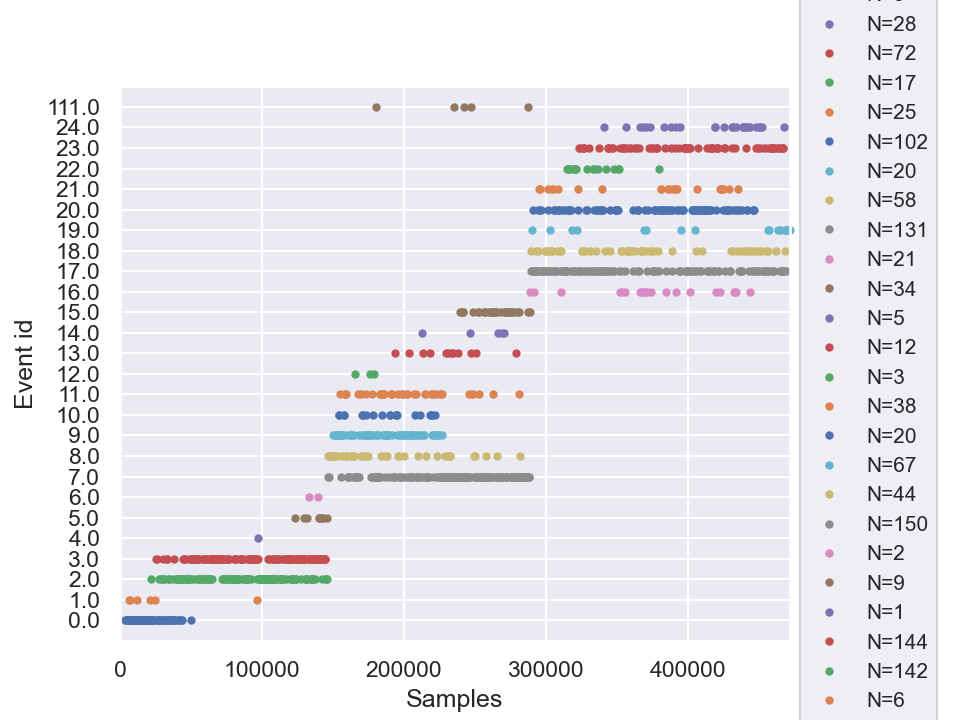

In [388]:
graph = pipe.fit_transform(psd_spectr_FA_ward)
#graph = pipe.fit_transform(psd_features)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
n_samples = len(cluster_events)

for i in range(len(graph.vs)):
    for j in range(n_samples):
        if j in graph.vs[i]["node_elements"]:
            cluster_events[j,2] = i

print(cluster_events)
print(len(cluster_events))
print(len(graph.vs))

fig = mne.viz.plot_events(cluster_events)            

In [547]:
# Define filter function
# filter_func = Eccentricity()
# filter_func = Entropy()
filter_func = decomposition.PCA(n_components=1)

filter_func = L_inf_centrality()
filter_func = stage1_min_dist()
# filter_func = L_inf_centr_time()
# filter_func = stage1_min_dist_time()

# Define cover
# cover = CubicalCover(n_intervals=3, overlap_frac=0.2)
cover = OneDimensionalCover(n_intervals=5, overlap_frac=0.1)

# Choose clustering algorithm
#clusterer = AgglomerativeClustering(linkage="ward", n_clusters=2, connectivity=knn_con_matr)
clusterer = KMeans(n_clusters=2)

# Configure parallelism of clustering step
n_jobs = -1

# Initialise pipeline
pipe = make_mapper_pipeline(
    filter_func=filter_func,
    cover=cover,
    clusterer=clusterer,
    min_intersection=3,
    contract_nodes=True,
    verbose=False,
    n_jobs=n_jobs,
)

fig = plot_static_mapper_graph(pipe, psd_spectr_FA_ward)
#fig = plot_static_mapper_graph(pipe, psd_features)
fig.show(config={'scrollZoom': True})

[[3.79400e+03 0.00000e+00 0.00000e+00]
 [4.18100e+03 0.00000e+00 0.00000e+00]
 [4.95900e+03 0.00000e+00 0.00000e+00]
 ...
 [4.70868e+05 0.00000e+00 4.00000e+00]
 [4.71229e+05 0.00000e+00 6.00000e+00]
 [4.71594e+05 0.00000e+00 6.00000e+00]]
1231
10


<IPython.core.display.Javascript object>


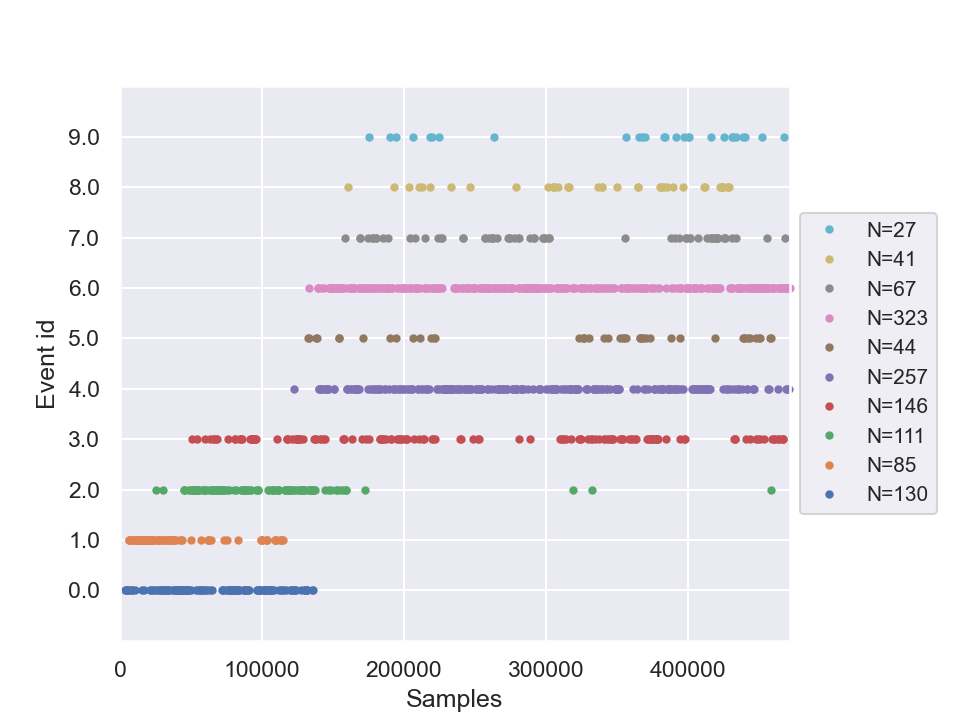

In [548]:
graph = pipe.fit_transform(psd_spectr_FA_ward)
#graph = pipe.fit_transform(psd_features)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
n_samples = len(cluster_events)

for i in range(len(graph.vs)):
    for j in range(n_samples):
        if j in graph.vs[i]["node_elements"]:
            cluster_events[j,2] = i

print(len(graph.vs))            
m_PCA_corr_kmeans_labels = cluster_events[:,2]


fig = mne.viz.plot_events(cluster_events)            

In [549]:
print(len(ecctr_corr_ward_knn_labels))
print(ecctr_corr_ward_knn_labels)

1231
[0. 0. 0. ... 4. 6. 6.]


# Testing different mappers

In [599]:
# Define filter function

#filter_func = Eccentricity(metric='euclidean')
#filter_func = Eccentricity(metric='correlation')
#filter_func = Entropy()
#filter_func = decomposition.PCA(n_components=1)

#filter_func = L_inf_centrality(metric='euclidean')
#filter_func = L_inf_centrality(metric='correlation')

#filter_func = stage1_min_dist(metric='euclidean')
filter_func = stage1_min_dist(metric='correlation')

# filter_func = L_inf_centr_time()
# filter_func = stage1_min_dist_time()

# Define cover
# cover = CubicalCover(n_intervals=3, overlap_frac=0.2)
cover = OneDimensionalCover(n_intervals=5, overlap_frac=0.1)

# Choose clustering algorithm
clusterer = AgglomerativeClustering(linkage="ward", n_clusters=2, connectivity=knn_con_matr)
#clusterer = AgglomerativeClustering(linkage="ward", n_clusters=2)
#clusterer = KMeans(n_clusters=2)

# Configure parallelism of clustering step
n_jobs = -1

# Initialise pipeline
pipe = make_mapper_pipeline(
    filter_func=filter_func,
    cover=cover,
    clusterer=clusterer,
    min_intersection=3,
    contract_nodes=True,
    verbose=False,
    n_jobs=n_jobs,
)

fig = plot_static_mapper_graph(pipe, psd_spectr_FA_ward)
#fig = plot_static_mapper_graph(pipe, psd_features)
fig.show(config={'scrollZoom': True})

10


<IPython.core.display.Javascript object>


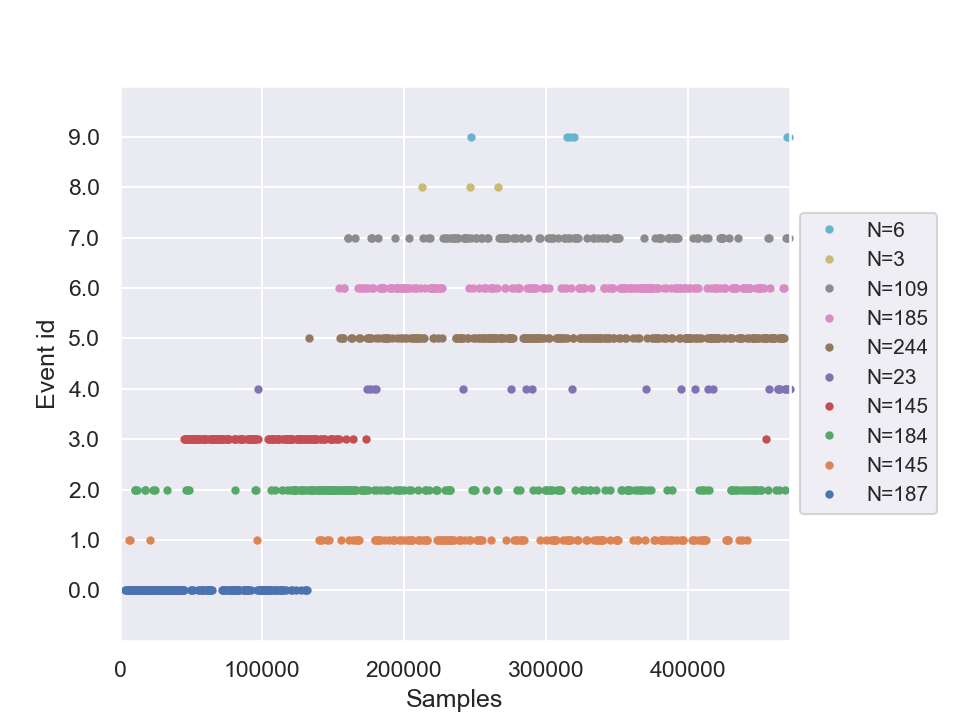

In [600]:
graph = pipe.fit_transform(psd_spectr_FA_ward)
#graph = pipe.fit_transform(psd_features)

cluster_events = ecg_events
cluster_events = np.delete(cluster_events, -1, axis=0)
n_samples = len(cluster_events)

for i in range(len(graph.vs)):
    for j in range(n_samples):
        if j in graph.vs[i]["node_elements"]:
            cluster_events[j,2] = i

print(len(graph.vs))            

#m_ecc_eucl_kmeans_labels = cluster_events[:,2]
#m_ecc_corr_kmeans_labels = cluster_events[:,2]
#m_ecc_eucl_ward_knn_labels = cluster_events[:,2]
#m_ecc_corr_ward_knn_labels = cluster_events[:,2]

#m_entropy_kmeans_labels = cluster_events[:,2]
#m_entropy_ward_labels = cluster_events[:,2]
#m_entropy_ward_knn_labels = cluster_events[:,2]

#m_PCA_1_kmeans_labels = cluster_events[:,2]
#m_PCA_1_ward_knn_labels = cluster_events[:,2]

#m_linf_eucl_kmeans_labels = cluster_events[:,2]
#m_linf_corr_kmeans_labels = cluster_events[:,2]
#m_linf_eucl_ward_knn_labels = cluster_events[:,2]
#m_linf_corr_ward_knn_labels = cluster_events[:,2]

#m_st1_dist_eucl_kmeans_labels = cluster_events[:,2]
#m_st1_dist_corr_kmeans_labels = cluster_events[:,2]
#m_st1_dist_eucl_ward_knn_labels = cluster_events[:,2]
m_st1_dist_corr_ward_knn_labels = cluster_events[:,2]

fig = mne.viz.plot_events(cluster_events)            

In [ ]:
# Calculate cluster centers and their distance matrix




In [535]:
# Функция для расчёта оценок качетва кластеризации
from sklearn import metrics

def bench_cl_metrics_noground(name, data, labels_pred):
#    t0 = time()
#    estimator = cluster_method.fit(data)
#    fit_time = time() - t0
    results = [name]

    # Define the metrics which require only data and predicted labels
    cluster_metrics_without_ground = [
        metrics.silhouette_score,
        metrics.calinski_harabasz_score,
        metrics.davies_bouldin_score
    ]
    results += [m(data, labels_pred) for m in cluster_metrics_without_ground]

    # Show the results
    formatter_result = (
        "{:9s}\t{:.3f}\t{:.3f}\t\t{:.3f}"
    )
    print(formatter_result.format(*results))

In [601]:
# Сравнение методов кластеризации на основе оценок качества

print(82 * "_")
print("method \t\t silh\t cal-har\t dav-bold\t homo\t compl\t v-meas\t ARI\t AMI")

cluster_method = KMeans(n_clusters=6, random_state=0)
fit_method = cluster_method.fit(psd_spectr_FA_ward)
bench_cl_metrics_noground(name="kmeans_FA_ward", data=psd_spectr_FA_ward, labels_pred=fit_method.labels_)

for linkage in ("ward", "average"):#, "complete", "single"):
    cluster_method = AgglomerativeClustering(linkage=linkage, n_clusters=6)
    fit_method = cluster_method.fit(psd_spectr_FA_ward)
    bench_cl_metrics_noground(name=linkage+"_FA_ward", data=psd_spectr_FA_ward, labels_pred=fit_method.labels_)

cluster_method = AgglomerativeClustering(linkage="ward", n_clusters=6, connectivity=knn_con_matr)
fit_method = cluster_method.fit(psd_spectr_FA_ward)
bench_cl_metrics_noground(name="ward_adj_FA_ward", data=psd_spectr_FA_ward, labels_pred=fit_method.labels_)

# Mapper results
bench_cl_metrics_noground(name="m_ecc_eucl_kmeans", data=psd_spectr_FA_ward, labels_pred=m_ecc_eucl_kmeans_labels)
bench_cl_metrics_noground(name="m_ecc_corr_kmeans", data=psd_spectr_FA_ward, labels_pred=m_ecc_corr_kmeans_labels)
bench_cl_metrics_noground(name="m_ecc_eucl_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_ecc_eucl_ward_knn_labels)
bench_cl_metrics_noground(name="m_ecc_corr_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_ecc_corr_ward_knn_labels)

bench_cl_metrics_noground(name="m_entropy_kmeans", data=psd_spectr_FA_ward, labels_pred=m_entropy_kmeans_labels)
bench_cl_metrics_noground(name="m_entropy_ward", data=psd_spectr_FA_ward, labels_pred=m_entropy_ward_labels)
bench_cl_metrics_noground(name="m_entropy_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_entropy_ward_knn_labels)

bench_cl_metrics_noground(name="m_PCA_1_kmeans", data=psd_spectr_FA_ward, labels_pred=m_PCA_1_kmeans_labels)
bench_cl_metrics_noground(name="m_PCA_1_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_PCA_1_ward_knn_labels)

bench_cl_metrics_noground(name="m_linf_eucl_kmeans", data=psd_spectr_FA_ward, labels_pred=m_linf_eucl_kmeans_labels)
bench_cl_metrics_noground(name="m_linf_corr_kmeans", data=psd_spectr_FA_ward, labels_pred=m_linf_corr_kmeans_labels)
bench_cl_metrics_noground(name="m_linf_eucl_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_linf_eucl_ward_knn_labels)
bench_cl_metrics_noground(name="m_linf_corr_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_linf_corr_ward_knn_labels)

bench_cl_metrics_noground(name="m_st1_dist_eucl_kmeans", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_eucl_kmeans_labels)
bench_cl_metrics_noground(name="m_st1_dist_corr_kmeans", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_corr_kmeans_labels)
bench_cl_metrics_noground(name="m_st1_dist_eucl_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_eucl_ward_knn_labels)
bench_cl_metrics_noground(name="m_st1_dist_corr_ward_knn", data=psd_spectr_FA_ward, labels_pred=m_st1_dist_corr_ward_knn_labels)

print(82 * "_")

__________________________________________________________________________________
method 		 silh	 cal-har	 dav-bold	 homo	 compl	 v-meas	 ARI	 AMI
kmeans_FA_ward	0.208	405.352		1.476
ward_FA_ward	0.172	335.804		1.461
average_FA_ward	0.165	217.656		1.185
ward_adj_FA_ward	0.115	243.752		2.549
m_ecc_eucl_kmeans	0.050	145.221		2.839
m_ecc_corr_kmeans	0.096	116.481		2.572
m_ecc_eucl_ward_knn	0.011	95.898		4.343
m_ecc_corr_ward_knn	-0.016	49.940		2.905
m_entropy_kmeans	0.095	206.360		1.823
m_entropy_ward	0.088	198.893		1.770
m_entropy_ward_knn	0.081	186.860		1.890
m_PCA_1_kmeans	0.120	242.065		1.816
m_PCA_1_ward_knn	0.117	236.747		1.759
m_linf_eucl_kmeans	0.050	162.660		2.835
m_linf_corr_kmeans	0.001	122.914		3.774
m_linf_eucl_ward_knn	0.028	137.765		2.911
m_linf_corr_ward_knn	-0.015	101.670		3.460
m_st1_dist_eucl_kmeans	0.059	170.591		2.952
m_st1_dist_corr_kmeans	0.044	148.635		3.003
m_st1_dist_eucl_ward_knn	0.036	147.915		3.054
m_st1_dist_corr_ward_knn	0.039	129.092		3.630
_______________

In [541]:
fit_method.labels_

array([3, 3, 3, ..., 2, 2, 2], dtype=int64)

# Testing

In [113]:
nparr = np.array([1, 2, 3, 4, 5, 6, 7, 8, 9, 10])
nparreven = nparr[np.where(nparr % 2 == 0)]
nparreven

npbool = nparr < 5
(nparr == 5).astype(int)

array([0, 0, 0, 0, 1, 0, 0, 0, 0, 0])

In [292]:
print(epochs_ecg.get_data().shape)

(1231, 19, 451)
